# 1. DCGAN with CIFAR10 dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import torch 
import torch.nn as nn
import torch.optim as optim
from torch.utils import data

import torchvision
import torchvision.transforms as T
import torchvision.datasets as datasets

import matplotlib.pyplot as plt
import numpy as np

import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

## 1-0. Define dataset & dataloader

In [ ]:
def CIFAR10_DATA(root='./data/', download=True, batch_size=64, num_worker=1):
    print("[+] Get the CIFAR-10 DATA")

    transform = T.Compose([T.ToTensor(), T.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))])

    cifar10_train = datasets.CIFAR10(root=root, train=True, transform=transform, download=True)
    cifar10_test = datasets.CIFAR10(root=root, train=False, transform=transform, download=True)

    train_dataloader = data.DataLoader(dataset = cifar10_train, batch_size=batch_size, shuffle=True, num_workers=num_worker)
    test_dataloader = data.DataLoader(dataset = cifar10_train, batch_size=batch_size, shuffle=False, num_workers=num_worker)

    print("[+] Finished loading data & preprocessing")

    return cifar10_train, cifar10_test, train_dataloader, test_dataloader

In [ ]:
train_dataset, test_dataset, train_dataloader, test_dataloader = CIFAR10_DATA(num_worker=4)

[+] Get the CIFAR-10 DATA


  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting ./data/cifar-10-python.tar.gz to ./data/
Files already downloaded and verified
[+] Finished loading data & preprocessing


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


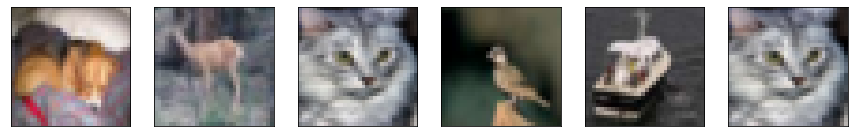

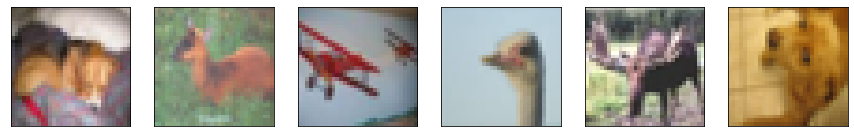

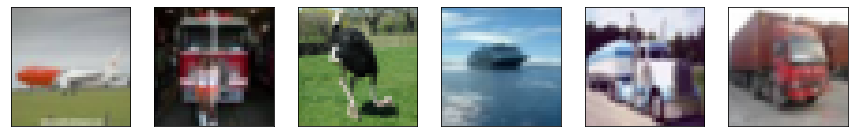

In [ ]:
# show images
def show_images(image, n_row):
    for _ in range(n_row):  
        index=np.random.choice(64, 6)
        images =image.numpy()[index]
        plt.figure(figsize=(15,90))    
        for a in range(161, 167):    
            plt.subplot(a)
            plt.imshow(images[(a-161)].transpose(1,2,0))
            plt.xticks([])
            plt.yticks([])    
        plt.show()  

def denorm(x):
    out = (x + 1) / 2
    return out.clamp(0, 1)
        
for i, (image,_) in enumerate(train_dataloader):
    show_images(denorm(image.squeeze()), 3)
    break

## 1-1. Make DCGAN Model

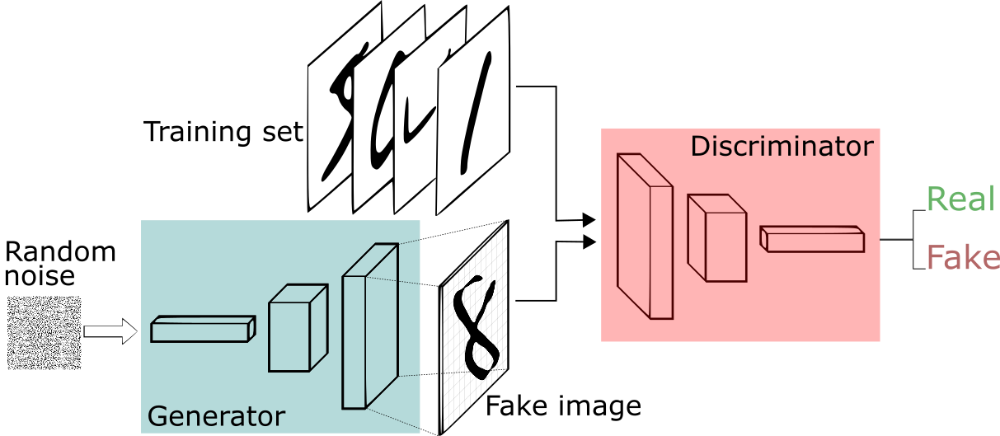

In [ ]:
# create convolution block
def conv(c_in, c_out, k_size, stride=2, pad=1, bn=True, activation='lrelu'):
    layers = []

    # Conv
    layers.append(nn.Conv2d(c_in, c_out, k_size, stride, pad, bias=False))

    # Batchnorm
    if bn:
        layers.append(nn.BatchNorm2d(c_out))
    
    # Activation
    if activation == 'lrelu':
        layers.append(nn.LeakyReLU(0.2))
    elif activation == 'relu':
        layers.append(nn.ReLU())
    elif activation == 'tanh':
        layers.append(nn.Tanh())
    
    return nn.Sequential(*layers)


# create deconvolution block
def deconv(c_in, c_out, k_size, stride=2, pad=1, bn=True, activation='lrelu'):
    layers = []

    # Deconv
    layers.append(nn.ConvTranspose2d(c_in, c_out, k_size, stride, pad, bias=False))

    # Batchnorm
    if bn:
        layers.append(nn.BatchNorm2d(c_out))
    
    # Activation
    if activation == 'lrelu':
        layers.append(nn.LeakyReLU(0.2))
    elif activation == 'relu':
        layers.append(nn.ReLU())
    elif activation == 'tanh':
        layers.append(nn.Tanh())
    
    return nn.Sequential(*layers)

In [ ]:
# Build Generator
class Generator(nn.Module):
    def __init__(self, z_dim=256, image_size=32, conv_dim=64):
        super(Generator, self).__init__()
        self.fc = deconv(z_dim, conv_dim*4, int(image_size/8), 1, 0, bn=False) # (B, 256, 4, 4)
        self.deconv1 = deconv(conv_dim*4, conv_dim*2, int(image_size/8), 2, 1, activation='relu') # (B, 128, 8, 8)
        self.deconv2 = deconv(conv_dim*2, conv_dim, int(image_size/8), 2, 1, activation='relu') # (B, 64, 16, 16)
        self.deconv3 = deconv(conv_dim, 3, 4, 2, 1, bn=False, activation='tanh') # (B, 3, 32, 32)
    
    def forward(self, z):
        z = z.view(z.size(0), z.size(1), 1, 1)
        out = self.fc(z)
        out = self.deconv1(out)
        out = self.deconv2(out)
        out = self.deconv3(out)
        return out

In [ ]:
# Build Discriminator
class Discriminator(nn.Module):
    def __init__(self, image_size=32, conv_dim=64):
        super(Discriminator, self).__init__()
        self.conv1 = conv(3, conv_dim, int(image_size/8), 2, 1) # (B, 64, 16, 16)
        self.conv2 = conv(conv_dim, conv_dim*2, int(image_size/8), 2, 1) # (B, 128, 8, 8)
        self.conv3 = conv(conv_dim*2, conv_dim*4, int(image_size/8), 2, 1) # (B, 256, 4, 4)
        self.fc = conv(conv_dim*4, 1, int(image_size/8), 1, 0, bn=False) # (B, 1, 1, 1)
    
    def forward(self, x):
        out = self.conv1(x)
        out = self.conv2(out)
        out = self.conv3(out)
        out = self.fc(out)
        out = torch.sigmoid(out)
        out = out.squeeze()
        return out

In [ ]:
input = torch.zeros(1, 3, 32, 32)
D = Discriminator(image_size=32, conv_dim=64)
D(input)

tensor(0.5000, grad_fn=<SqueezeBackward0>)

In [ ]:
G = Generator(z_dim=256, image_size=32, conv_dim=64).cuda()
D = Discriminator(image_size=32, conv_dim=64).cuda()

## 1-2. Train Model

In [ ]:
criterion = nn.BCELoss()
g_optimizer = optim.Adam(G.parameters(), 0.0002, [0.5, 0.999]) # learning_rate=0.0002, beta1=0.5, beta2=0.999
d_optimizer = optim.Adam(D.parameters(), 0.0002, [0.5, 0.999]) # learning_rate=0.0002, beta1=0.5, beta2=0.999

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Epoch [0/100], Step[300/782], d_loss: 0.4863, g_loss: 1.6399


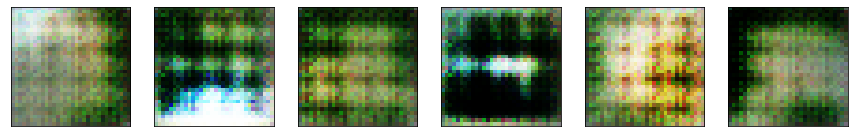

Epoch [0/100], Step[600/782], d_loss: 0.7343, g_loss: 1.3847


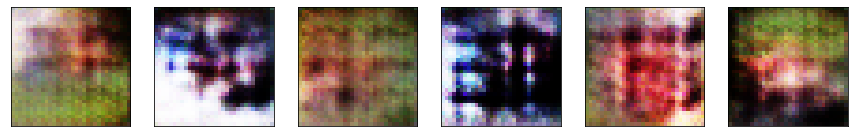

Epoch [1/100], Step[300/782], d_loss: 0.6756, g_loss: 1.3283


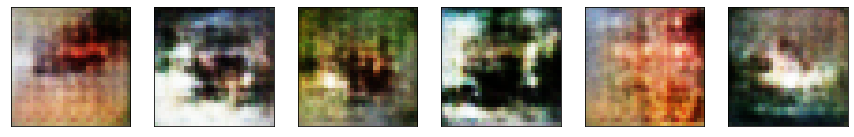

Epoch [1/100], Step[600/782], d_loss: 0.6313, g_loss: 1.1069


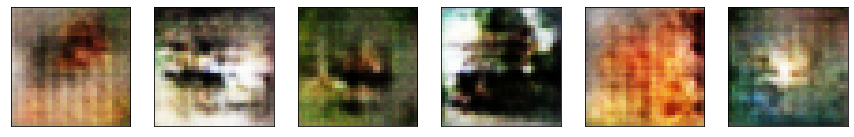

Epoch [2/100], Step[300/782], d_loss: 0.5890, g_loss: 1.3347


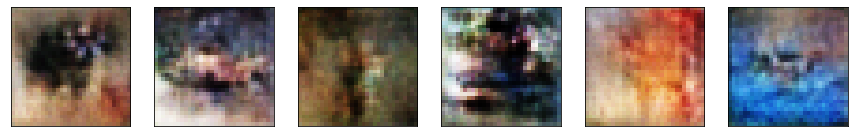

Epoch [2/100], Step[600/782], d_loss: 0.5517, g_loss: 1.3038


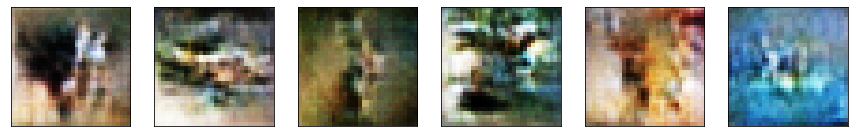

Epoch [3/100], Step[300/782], d_loss: 0.6737, g_loss: 1.5524


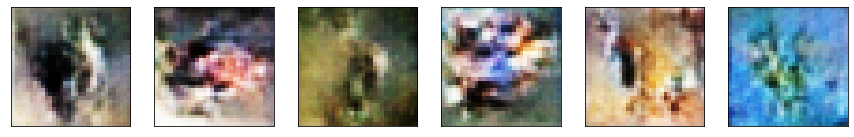

Epoch [3/100], Step[600/782], d_loss: 0.5029, g_loss: 1.1346


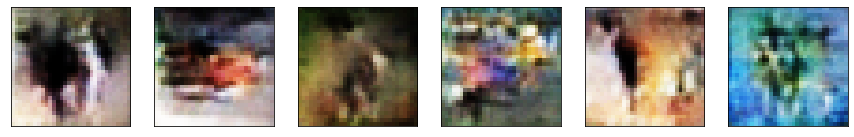

Epoch [4/100], Step[300/782], d_loss: 0.5505, g_loss: 1.5272


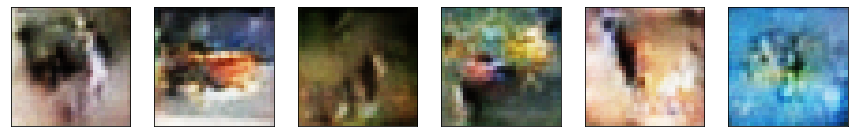

Epoch [4/100], Step[600/782], d_loss: 0.4171, g_loss: 1.4673


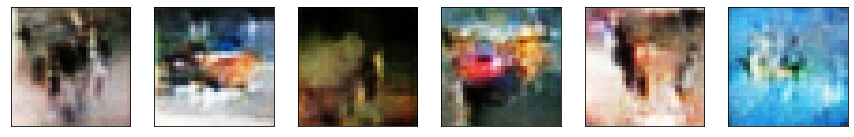

Epoch [5/100], Step[300/782], d_loss: 0.4531, g_loss: 1.9967


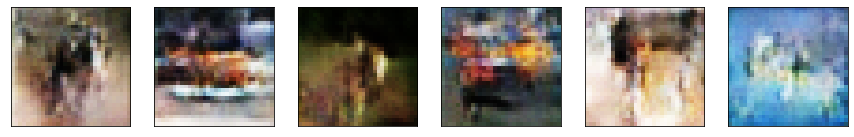

Epoch [5/100], Step[600/782], d_loss: 0.4059, g_loss: 1.4357


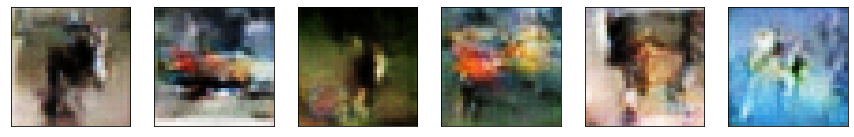

Epoch [6/100], Step[300/782], d_loss: 0.3359, g_loss: 1.6646


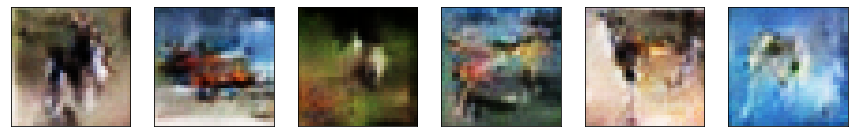

Epoch [6/100], Step[600/782], d_loss: 1.2149, g_loss: 1.0716


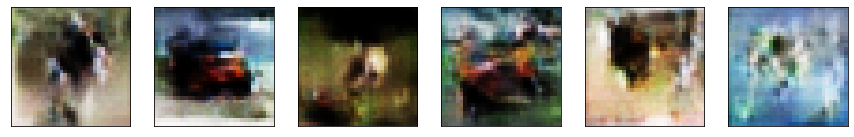

Epoch [7/100], Step[300/782], d_loss: 0.3309, g_loss: 1.6100


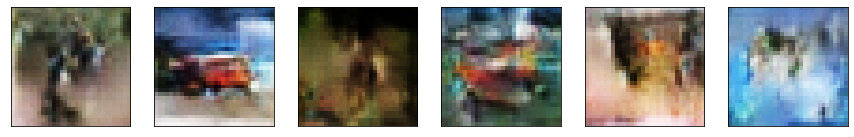

Epoch [7/100], Step[600/782], d_loss: 0.2363, g_loss: 1.5882


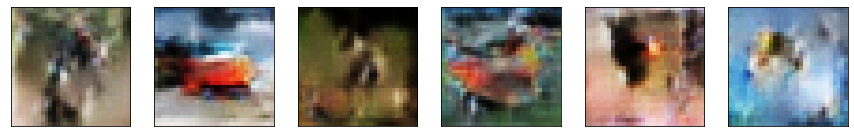

Epoch [8/100], Step[300/782], d_loss: 0.3746, g_loss: 1.6694


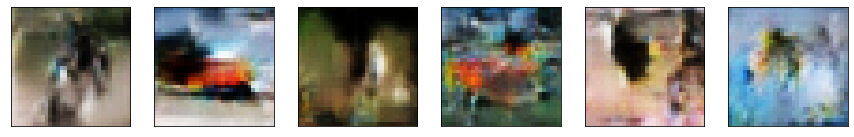

Epoch [8/100], Step[600/782], d_loss: 1.0859, g_loss: 0.3914


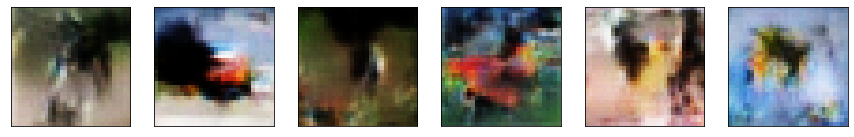

Epoch [9/100], Step[300/782], d_loss: 0.5078, g_loss: 1.9965


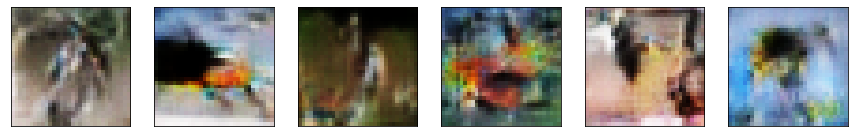

Epoch [9/100], Step[600/782], d_loss: 1.1307, g_loss: 1.1368


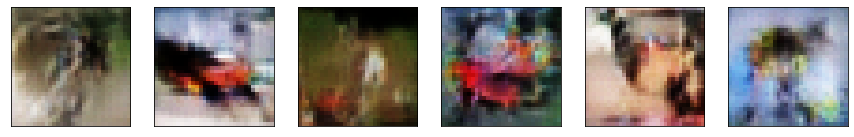

Epoch [10/100], Step[300/782], d_loss: 1.4605, g_loss: 2.1733


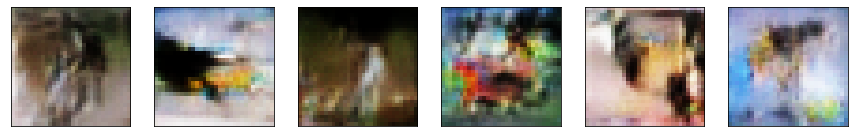

Epoch [10/100], Step[600/782], d_loss: 0.2101, g_loss: 1.8927


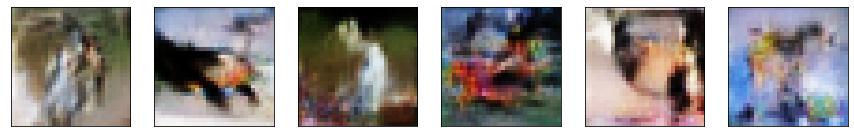

Epoch [11/100], Step[300/782], d_loss: 0.2479, g_loss: 2.5700


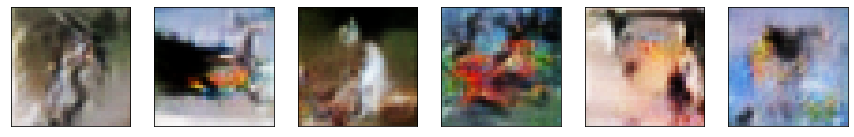

Epoch [11/100], Step[600/782], d_loss: 0.2681, g_loss: 2.1290


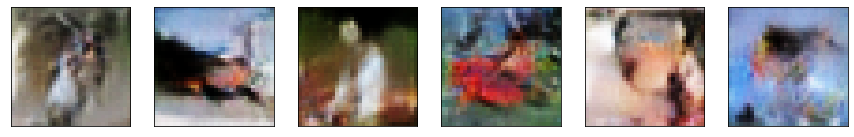

Epoch [12/100], Step[300/782], d_loss: 0.2148, g_loss: 2.0056


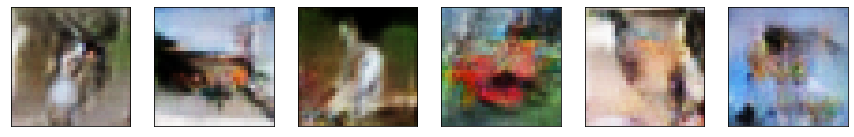

Epoch [12/100], Step[600/782], d_loss: 0.2297, g_loss: 1.8350


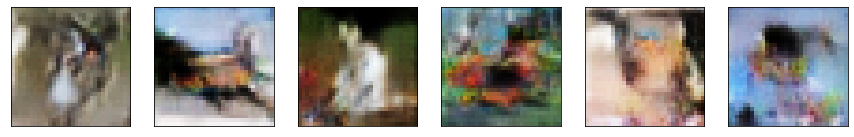

Epoch [13/100], Step[300/782], d_loss: 0.6660, g_loss: 1.7335


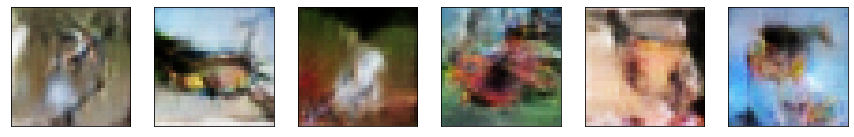

Epoch [13/100], Step[600/782], d_loss: 0.3087, g_loss: 1.6999


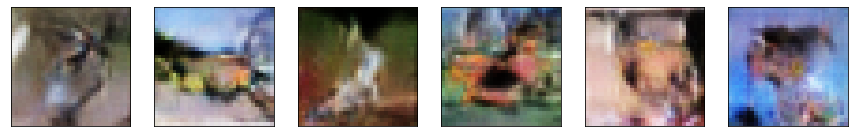

Epoch [14/100], Step[300/782], d_loss: 0.5793, g_loss: 1.6822


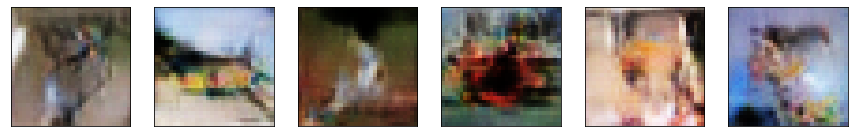

Epoch [14/100], Step[600/782], d_loss: 0.2373, g_loss: 1.5137


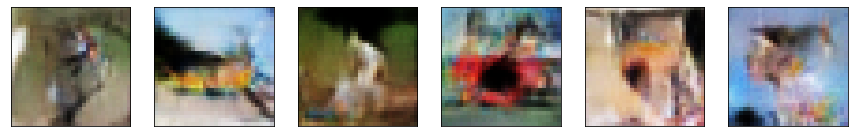

Epoch [15/100], Step[300/782], d_loss: 1.9724, g_loss: 3.9498


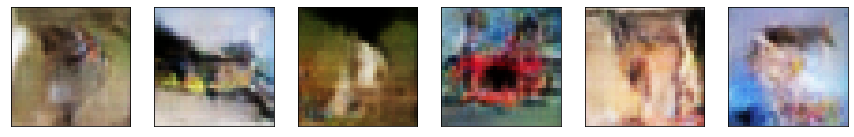

Epoch [15/100], Step[600/782], d_loss: 0.4357, g_loss: 2.1951


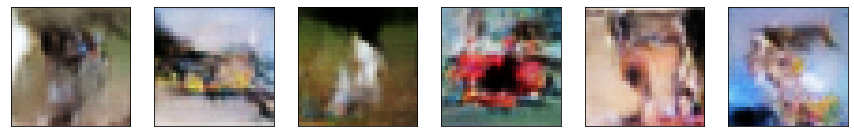

Epoch [16/100], Step[300/782], d_loss: 0.2554, g_loss: 2.1494


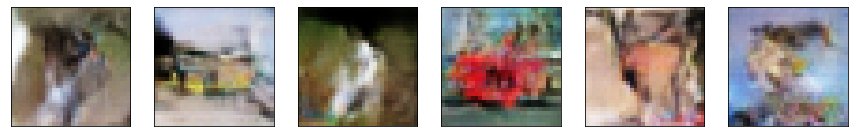

Epoch [16/100], Step[600/782], d_loss: 0.5130, g_loss: 1.2792


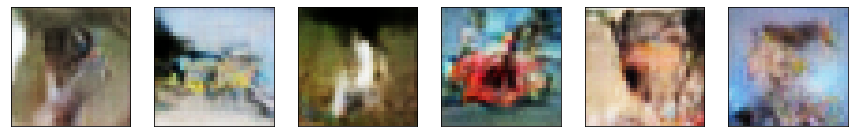

Epoch [17/100], Step[300/782], d_loss: 0.2909, g_loss: 1.8522


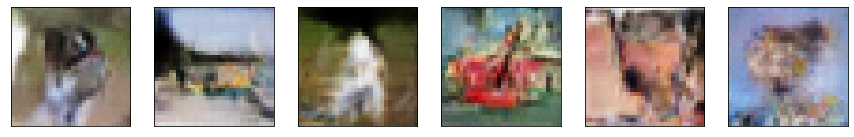

Epoch [17/100], Step[600/782], d_loss: 0.1766, g_loss: 2.0039


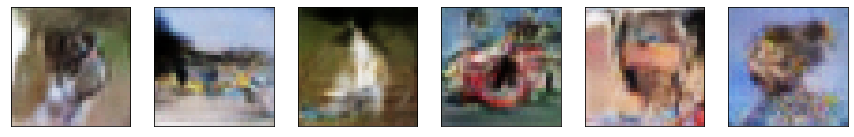

Epoch [18/100], Step[300/782], d_loss: 0.1775, g_loss: 2.4651


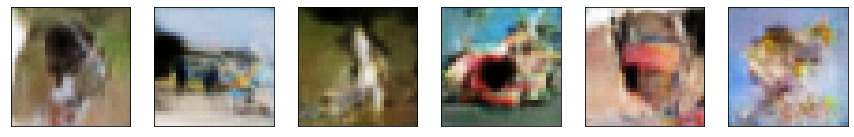

Epoch [18/100], Step[600/782], d_loss: 0.3936, g_loss: 2.0766


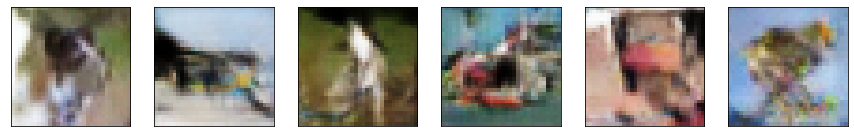

Epoch [19/100], Step[300/782], d_loss: 0.1856, g_loss: 2.6534


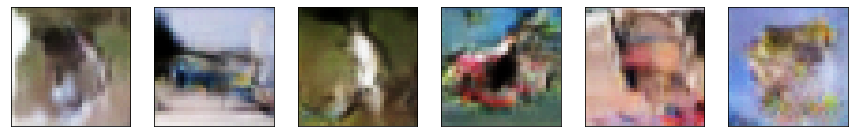

Epoch [19/100], Step[600/782], d_loss: 0.2830, g_loss: 1.5758


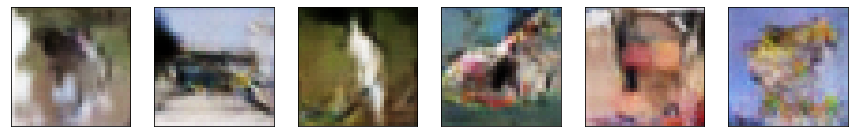

Epoch [20/100], Step[300/782], d_loss: 0.3848, g_loss: 1.4834


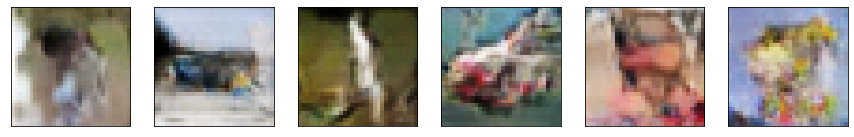

Epoch [20/100], Step[600/782], d_loss: 0.4634, g_loss: 1.8695


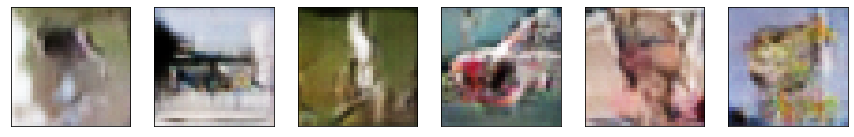

Epoch [21/100], Step[300/782], d_loss: 1.3734, g_loss: 0.6207


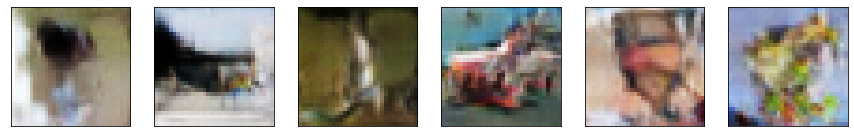

Epoch [21/100], Step[600/782], d_loss: 0.1821, g_loss: 2.4769


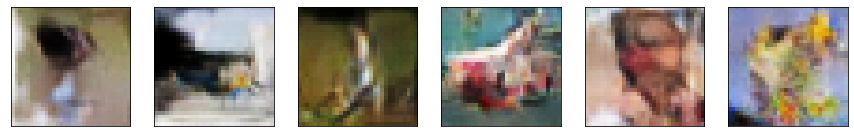

Epoch [22/100], Step[300/782], d_loss: 0.2462, g_loss: 1.8547


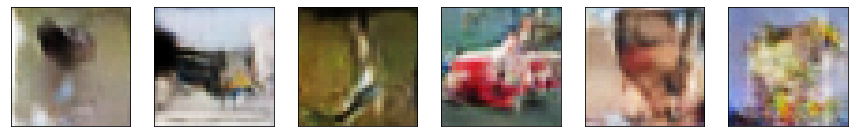

Epoch [22/100], Step[600/782], d_loss: 0.2144, g_loss: 2.1506


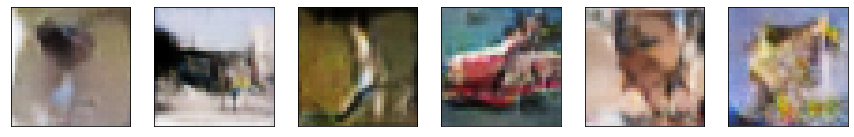

Epoch [23/100], Step[300/782], d_loss: 0.4170, g_loss: 1.7068


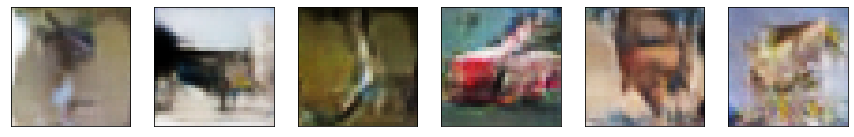

Epoch [23/100], Step[600/782], d_loss: 0.2533, g_loss: 1.7582


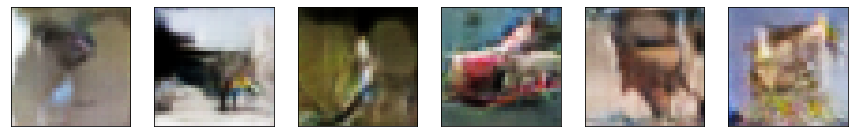

Epoch [24/100], Step[300/782], d_loss: 0.1677, g_loss: 2.2552


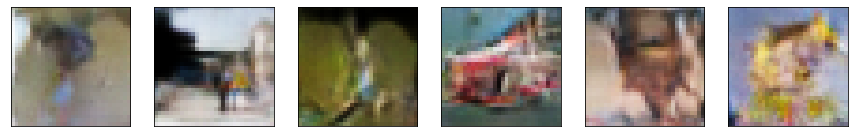

Epoch [24/100], Step[600/782], d_loss: 0.2002, g_loss: 2.5029


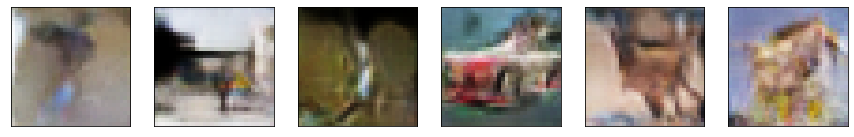

Epoch [25/100], Step[300/782], d_loss: 0.5188, g_loss: 1.9735


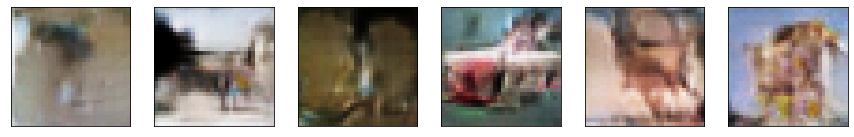

Epoch [25/100], Step[600/782], d_loss: 0.3009, g_loss: 1.3299


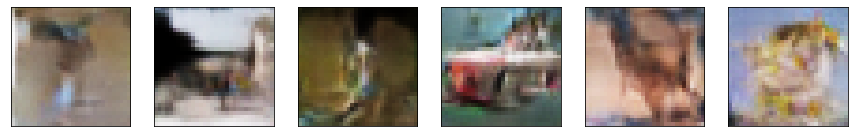

Epoch [26/100], Step[300/782], d_loss: 0.1321, g_loss: 2.2980


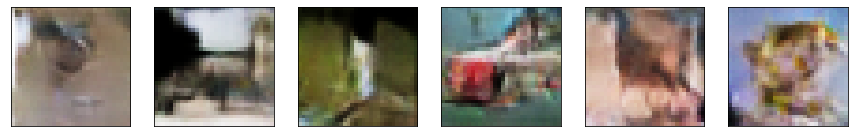

Epoch [26/100], Step[600/782], d_loss: 0.2723, g_loss: 2.2574


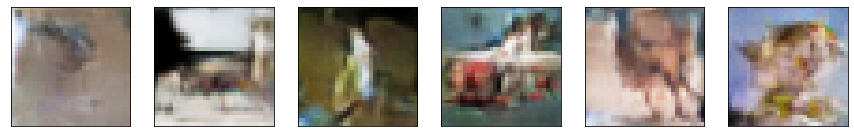

Epoch [27/100], Step[300/782], d_loss: 0.1196, g_loss: 2.4010


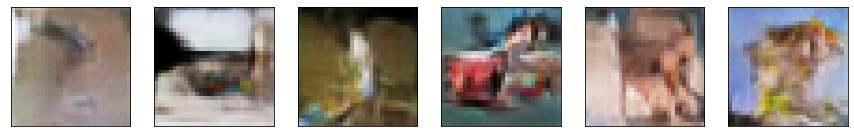

Epoch [27/100], Step[600/782], d_loss: 0.3953, g_loss: 2.8552


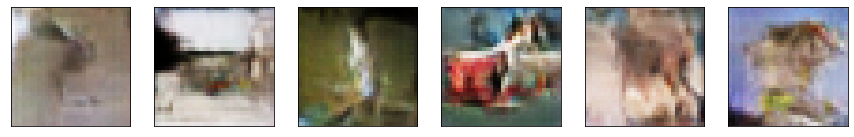

Epoch [28/100], Step[300/782], d_loss: 0.1288, g_loss: 2.4716


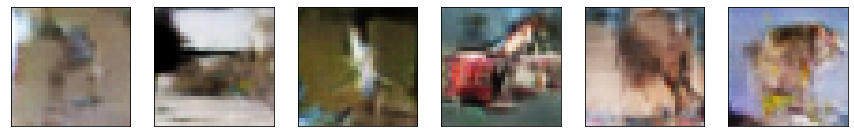

Epoch [28/100], Step[600/782], d_loss: 1.8567, g_loss: 2.5096


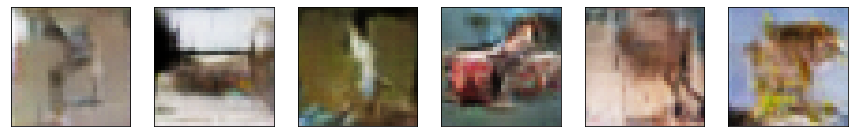

Epoch [29/100], Step[300/782], d_loss: 0.5812, g_loss: 1.6452


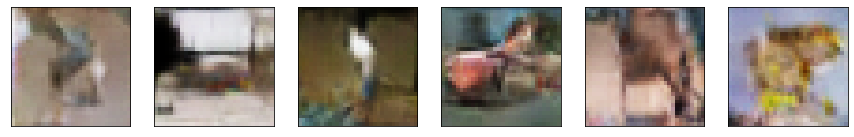

Epoch [29/100], Step[600/782], d_loss: 0.2785, g_loss: 1.8163


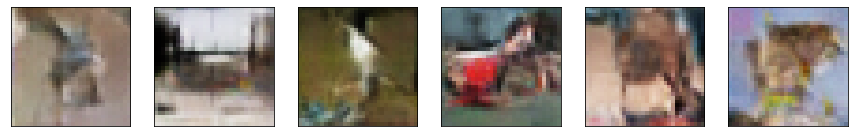

Epoch [30/100], Step[300/782], d_loss: 0.0983, g_loss: 3.1596


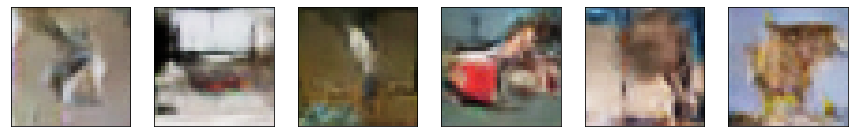

Epoch [30/100], Step[600/782], d_loss: 0.1534, g_loss: 2.4151


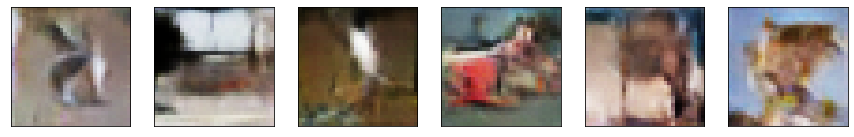

Epoch [31/100], Step[300/782], d_loss: 0.4141, g_loss: 2.2816


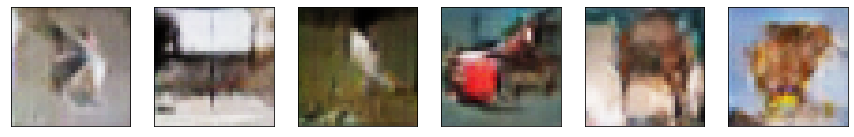

Epoch [31/100], Step[600/782], d_loss: 0.1214, g_loss: 2.3784


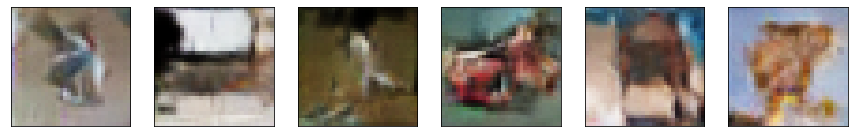

Epoch [32/100], Step[300/782], d_loss: 0.2812, g_loss: 1.6312


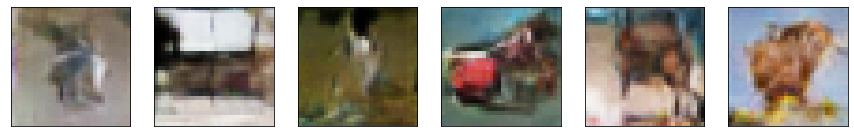

Epoch [32/100], Step[600/782], d_loss: 0.4624, g_loss: 1.1568


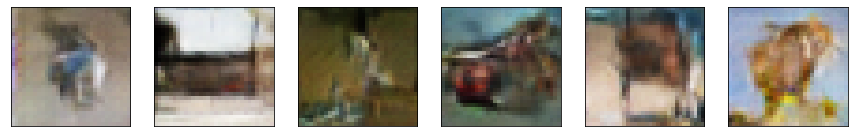

Epoch [33/100], Step[300/782], d_loss: 0.3927, g_loss: 1.6855


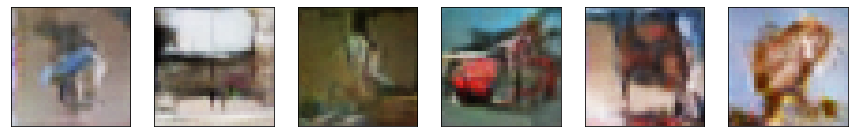

Epoch [33/100], Step[600/782], d_loss: 0.8715, g_loss: 2.1787


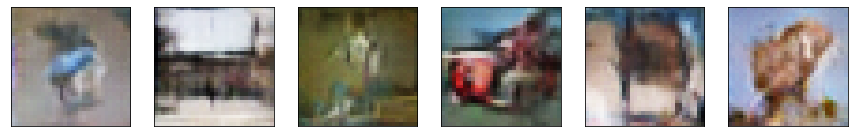

Epoch [34/100], Step[300/782], d_loss: 0.1094, g_loss: 2.8678


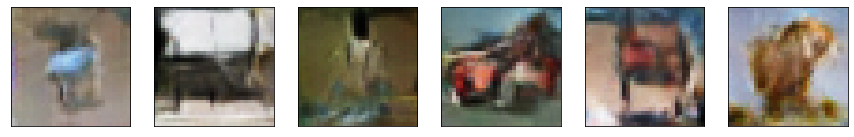

Epoch [34/100], Step[600/782], d_loss: 0.2336, g_loss: 2.4597


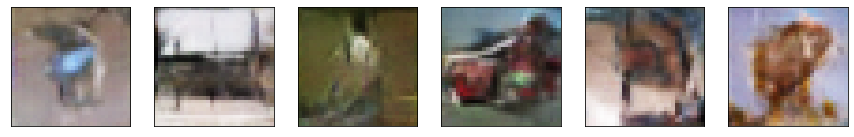

Epoch [35/100], Step[300/782], d_loss: 0.2102, g_loss: 2.4421


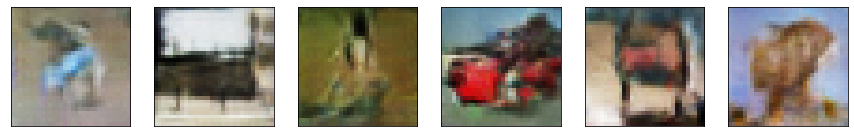

Epoch [35/100], Step[600/782], d_loss: 0.0743, g_loss: 2.9299


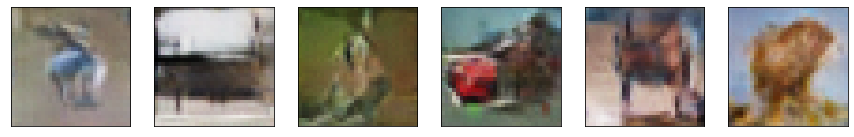

Epoch [36/100], Step[300/782], d_loss: 1.3346, g_loss: 1.3476


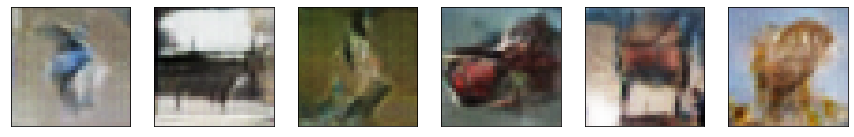

Epoch [36/100], Step[600/782], d_loss: 0.1113, g_loss: 2.4891


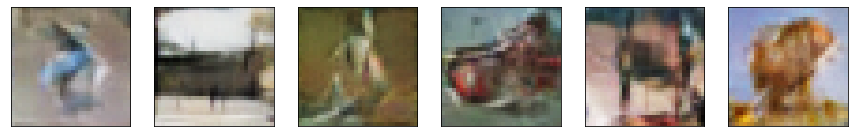

Epoch [37/100], Step[300/782], d_loss: 0.2332, g_loss: 2.4896


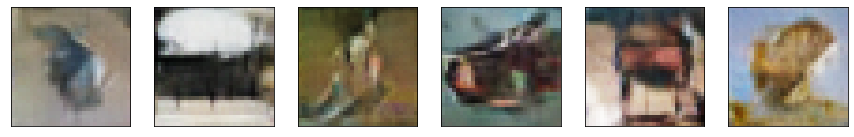

Epoch [37/100], Step[600/782], d_loss: 0.2539, g_loss: 2.1681


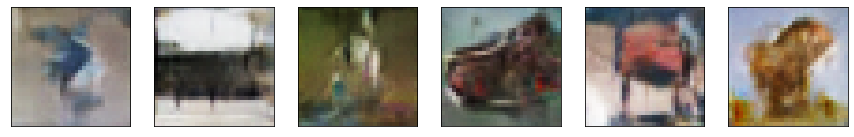

Epoch [38/100], Step[300/782], d_loss: 0.1672, g_loss: 2.7723


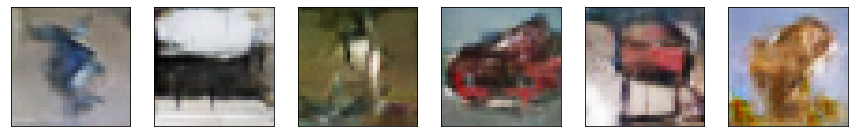

Epoch [38/100], Step[600/782], d_loss: 0.2081, g_loss: 2.4448


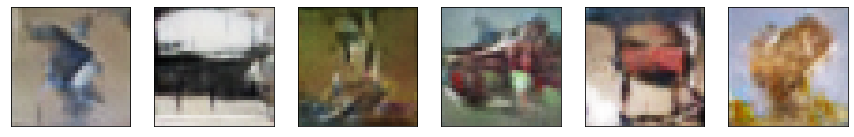

Epoch [39/100], Step[300/782], d_loss: 0.1394, g_loss: 2.3348


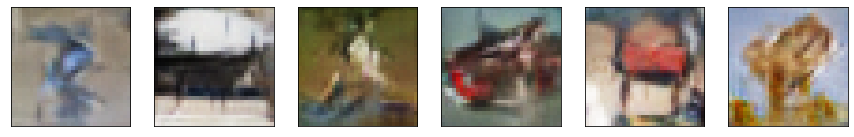

Epoch [39/100], Step[600/782], d_loss: 0.6022, g_loss: 3.4559


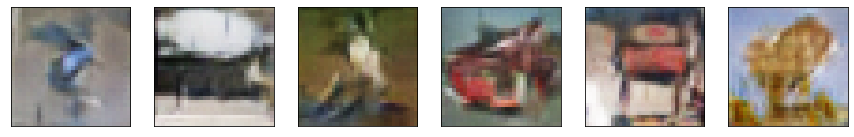

Epoch [40/100], Step[300/782], d_loss: 0.3535, g_loss: 1.8908


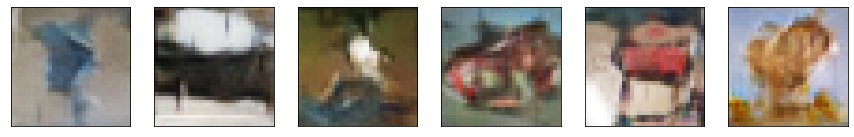

Epoch [40/100], Step[600/782], d_loss: 0.2015, g_loss: 1.6260


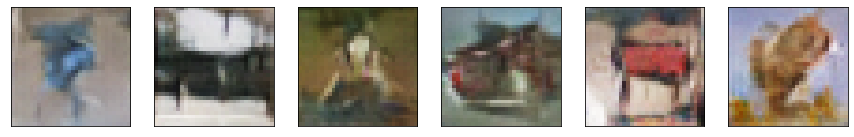

Epoch [41/100], Step[300/782], d_loss: 0.1212, g_loss: 3.1268


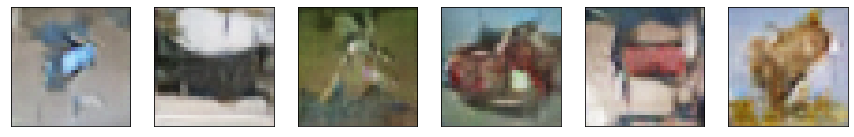

Epoch [41/100], Step[600/782], d_loss: 0.2698, g_loss: 2.3173


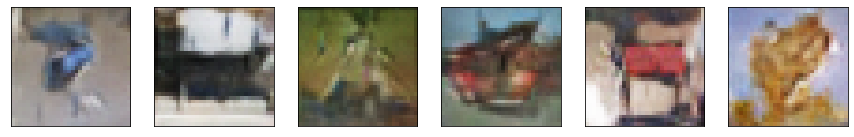

Epoch [42/100], Step[300/782], d_loss: 0.1344, g_loss: 2.3532


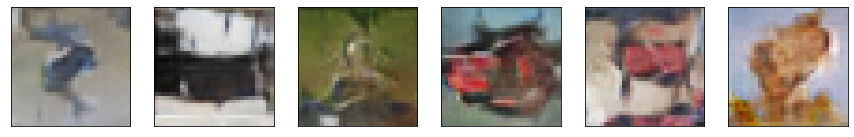

Epoch [42/100], Step[600/782], d_loss: 0.0622, g_loss: 3.7644


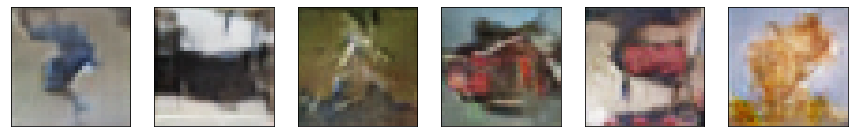

Epoch [43/100], Step[300/782], d_loss: 0.1393, g_loss: 2.8014


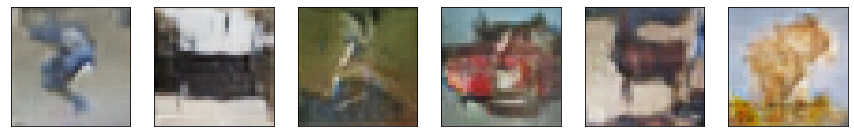

Epoch [43/100], Step[600/782], d_loss: 1.7120, g_loss: 6.6048


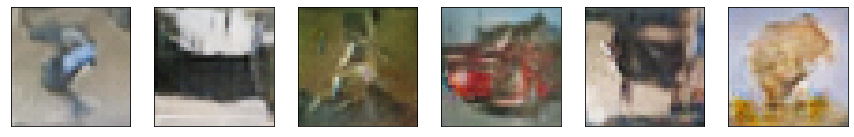

Epoch [44/100], Step[300/782], d_loss: 0.1808, g_loss: 2.5282


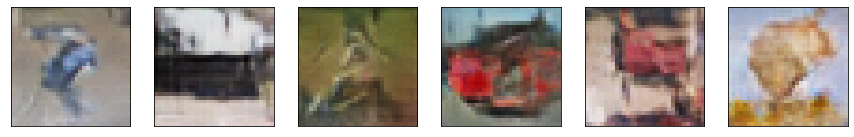

Epoch [44/100], Step[600/782], d_loss: 0.1880, g_loss: 2.6952


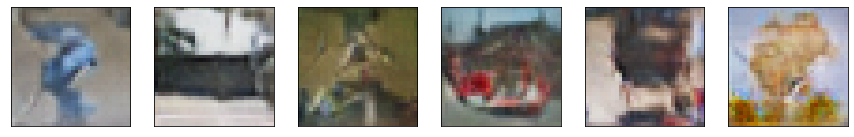

Epoch [45/100], Step[300/782], d_loss: 0.1972, g_loss: 2.3821


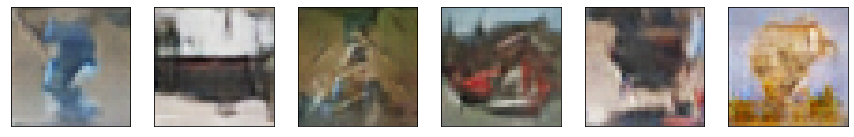

Epoch [45/100], Step[600/782], d_loss: 0.1540, g_loss: 2.8008


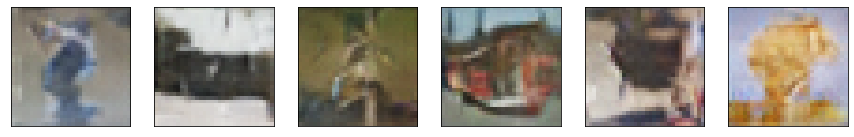

Epoch [46/100], Step[300/782], d_loss: 0.4279, g_loss: 3.3451


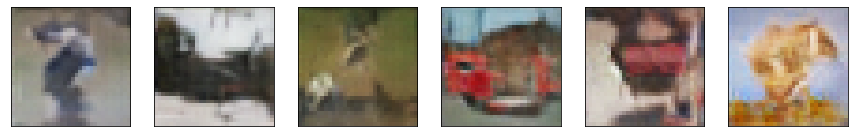

Epoch [46/100], Step[600/782], d_loss: 0.2063, g_loss: 2.2876


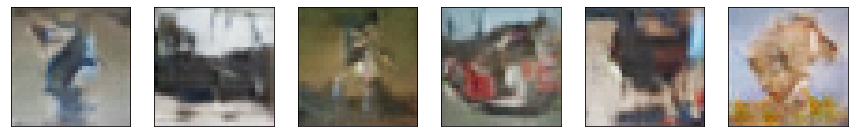

Epoch [47/100], Step[300/782], d_loss: 0.2047, g_loss: 2.7658


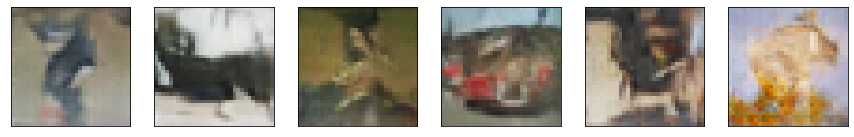

Epoch [47/100], Step[600/782], d_loss: 0.9453, g_loss: 3.7016


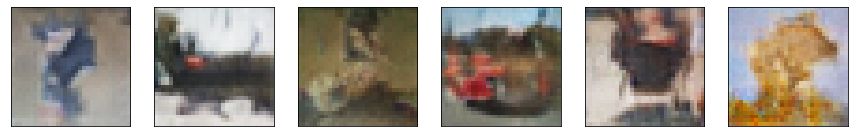

Epoch [48/100], Step[300/782], d_loss: 0.1342, g_loss: 2.2224


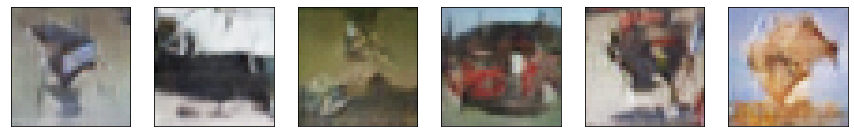

Epoch [48/100], Step[600/782], d_loss: 0.1909, g_loss: 2.6435


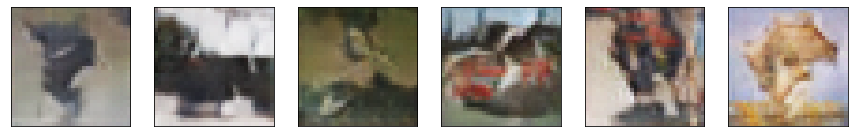

Epoch [49/100], Step[300/782], d_loss: 0.1521, g_loss: 2.1607


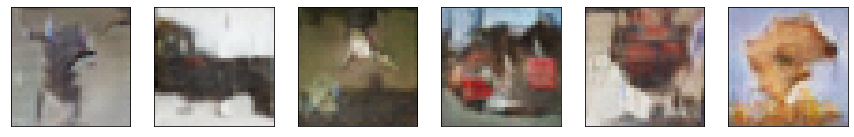

Epoch [49/100], Step[600/782], d_loss: 0.2059, g_loss: 2.9323


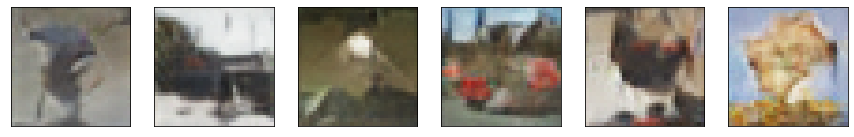

Epoch [50/100], Step[300/782], d_loss: 0.4645, g_loss: 1.5191


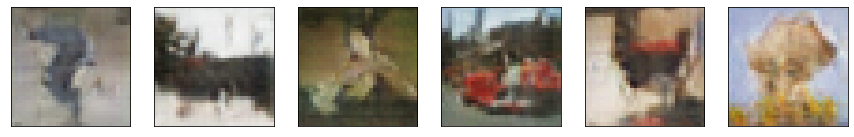

Epoch [50/100], Step[600/782], d_loss: 0.1543, g_loss: 2.2442


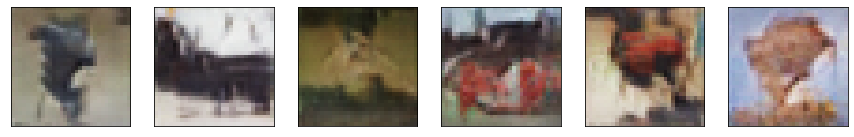

Epoch [51/100], Step[300/782], d_loss: 0.8213, g_loss: 2.5485


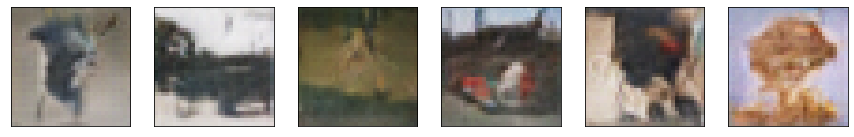

Epoch [51/100], Step[600/782], d_loss: 0.3746, g_loss: 1.5422


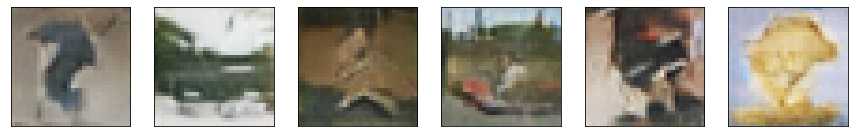

Epoch [52/100], Step[300/782], d_loss: 0.1039, g_loss: 2.5653


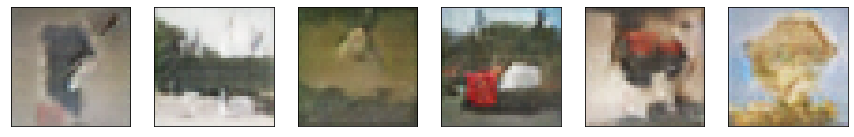

Epoch [52/100], Step[600/782], d_loss: 0.1463, g_loss: 2.6819


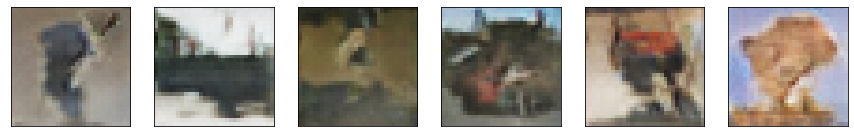

Epoch [53/100], Step[300/782], d_loss: 0.1566, g_loss: 2.6992


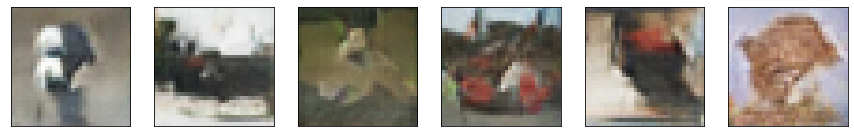

Epoch [53/100], Step[600/782], d_loss: 0.3796, g_loss: 2.4265


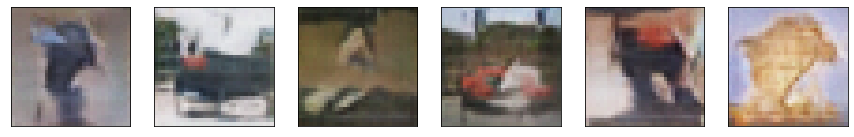

Epoch [54/100], Step[300/782], d_loss: 0.1541, g_loss: 3.1638


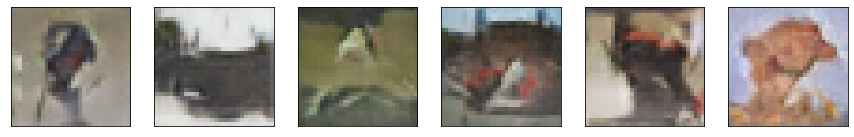

Epoch [54/100], Step[600/782], d_loss: 0.1861, g_loss: 3.3153


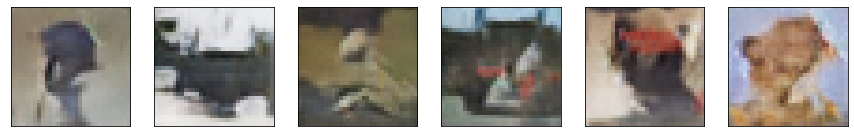

Epoch [55/100], Step[300/782], d_loss: 0.0924, g_loss: 2.6779


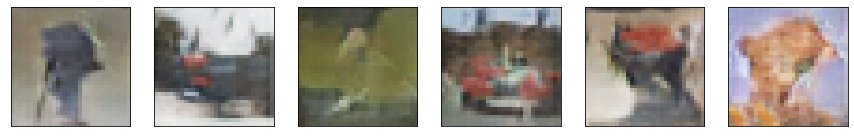

Epoch [55/100], Step[600/782], d_loss: 0.1247, g_loss: 2.6535


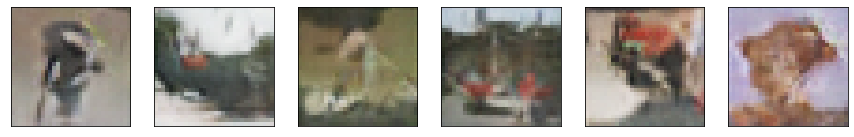

Epoch [56/100], Step[300/782], d_loss: 0.3232, g_loss: 2.9207


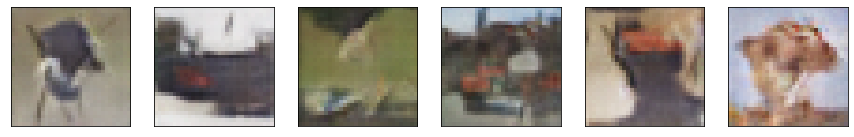

Epoch [56/100], Step[600/782], d_loss: 0.2204, g_loss: 2.6920


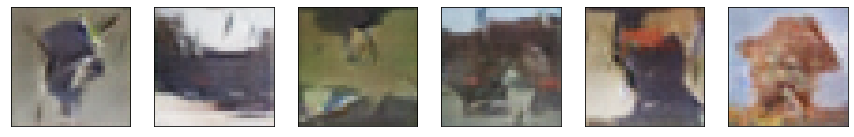

Epoch [57/100], Step[300/782], d_loss: 0.2530, g_loss: 2.1884


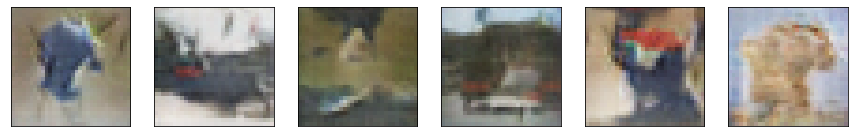

Epoch [57/100], Step[600/782], d_loss: 0.1807, g_loss: 2.0988


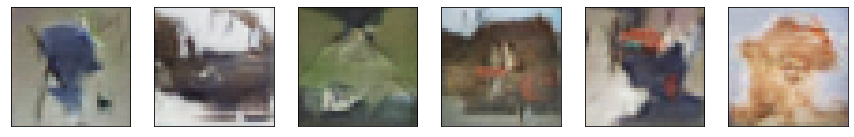

Epoch [58/100], Step[300/782], d_loss: 0.5318, g_loss: 1.7246


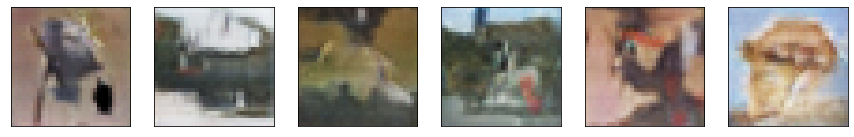

Epoch [58/100], Step[600/782], d_loss: 0.2144, g_loss: 2.0701


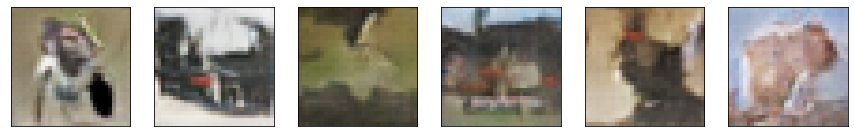

Epoch [59/100], Step[300/782], d_loss: 0.0652, g_loss: 3.4598


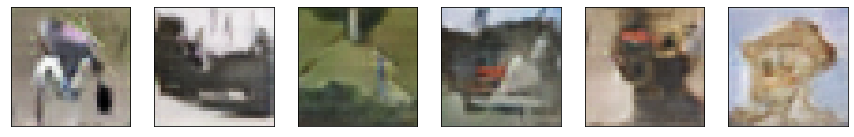

Epoch [59/100], Step[600/782], d_loss: 0.1224, g_loss: 2.1485


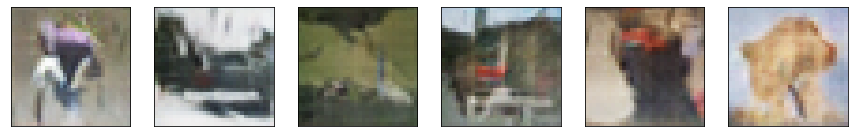

Epoch [60/100], Step[300/782], d_loss: 0.1226, g_loss: 3.1266


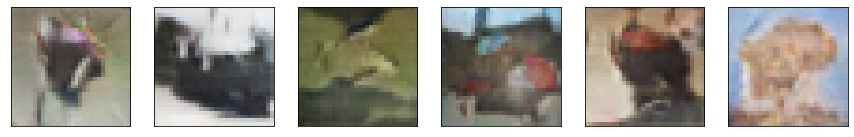

Epoch [60/100], Step[600/782], d_loss: 0.4571, g_loss: 3.2112


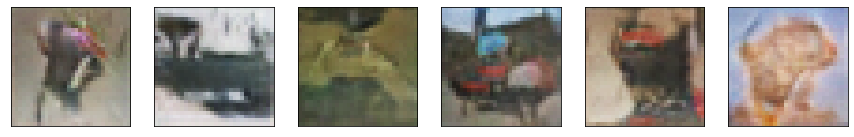

Epoch [61/100], Step[300/782], d_loss: 0.1320, g_loss: 2.1732


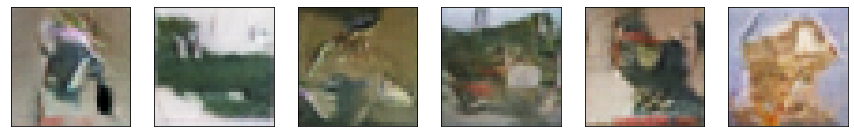

Epoch [61/100], Step[600/782], d_loss: 0.1118, g_loss: 3.0661


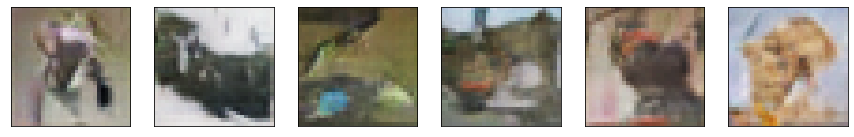

Epoch [62/100], Step[300/782], d_loss: 0.1352, g_loss: 2.8981


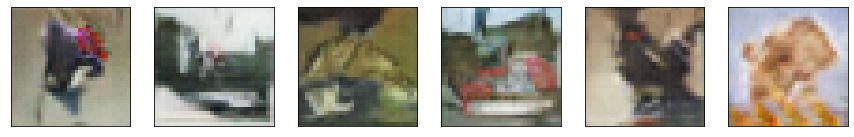

Epoch [62/100], Step[600/782], d_loss: 0.1257, g_loss: 2.8495


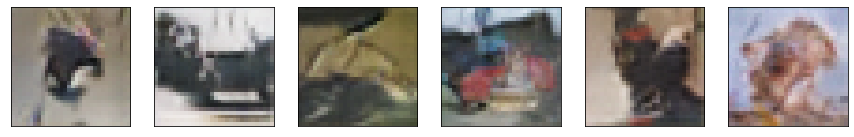

Epoch [63/100], Step[300/782], d_loss: 0.1703, g_loss: 3.0839


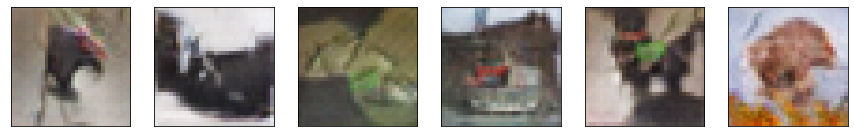

Epoch [63/100], Step[600/782], d_loss: 0.1390, g_loss: 2.8462


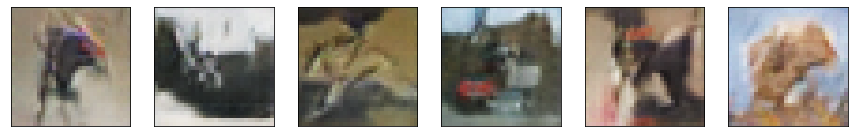

Epoch [64/100], Step[300/782], d_loss: 0.1131, g_loss: 2.3057


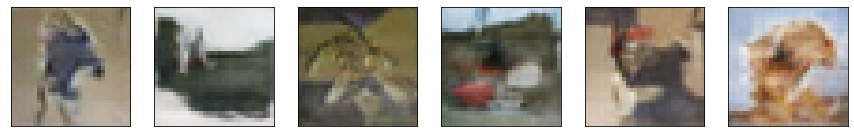

Epoch [64/100], Step[600/782], d_loss: 0.1005, g_loss: 2.8393


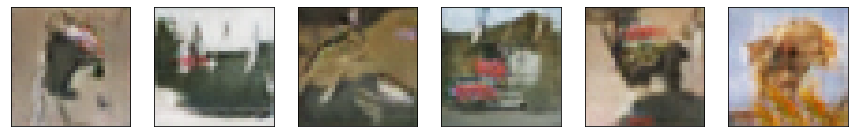

Epoch [65/100], Step[300/782], d_loss: 0.2162, g_loss: 2.6110


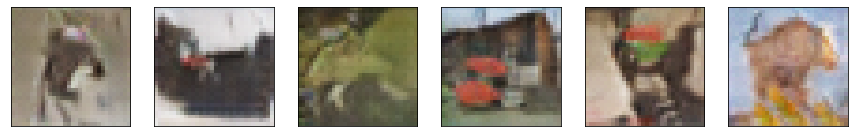

Epoch [65/100], Step[600/782], d_loss: 0.0930, g_loss: 3.2398


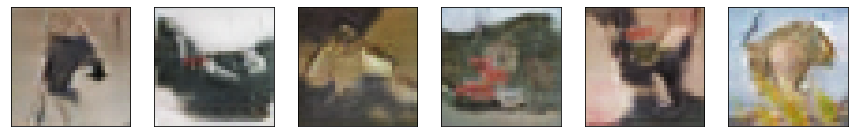

Epoch [66/100], Step[300/782], d_loss: 0.1309, g_loss: 3.7282


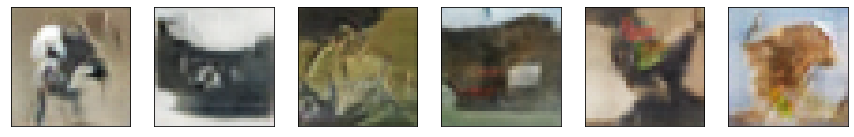

Epoch [66/100], Step[600/782], d_loss: 0.0988, g_loss: 2.6067


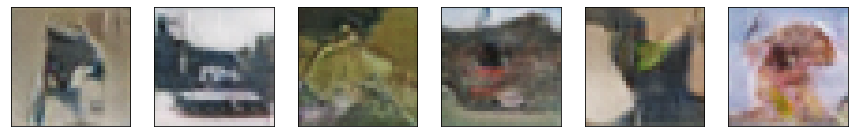

Epoch [67/100], Step[300/782], d_loss: 0.1243, g_loss: 3.3327


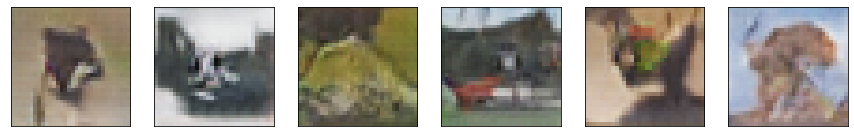

Epoch [67/100], Step[600/782], d_loss: 0.1023, g_loss: 3.0413


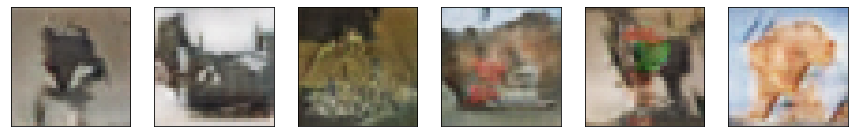

Epoch [68/100], Step[300/782], d_loss: 0.0752, g_loss: 2.9224


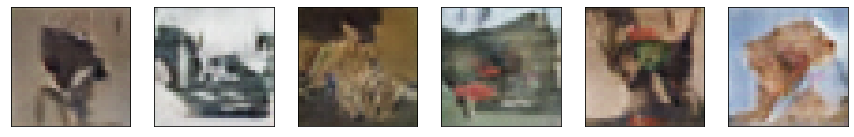

Epoch [68/100], Step[600/782], d_loss: 0.0349, g_loss: 3.6686


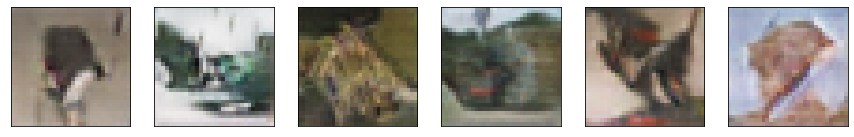

Epoch [69/100], Step[300/782], d_loss: 0.0464, g_loss: 3.4093


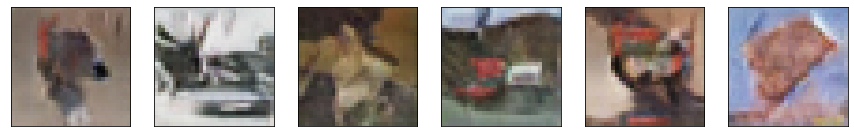

Epoch [69/100], Step[600/782], d_loss: 0.4141, g_loss: 2.1880


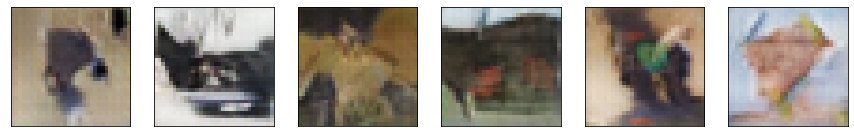

Epoch [70/100], Step[300/782], d_loss: 0.3166, g_loss: 2.8786


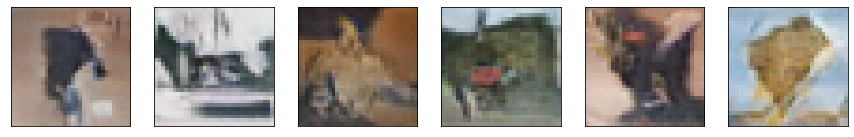

Epoch [70/100], Step[600/782], d_loss: 0.3169, g_loss: 2.5075


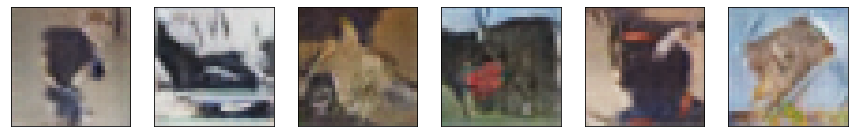

Epoch [71/100], Step[300/782], d_loss: 0.0830, g_loss: 3.3986


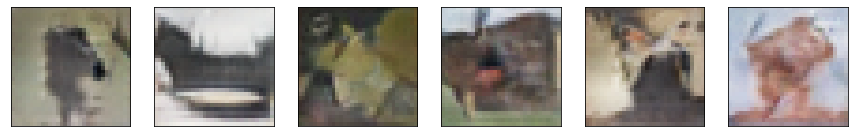

Epoch [71/100], Step[600/782], d_loss: 0.3720, g_loss: 3.7397


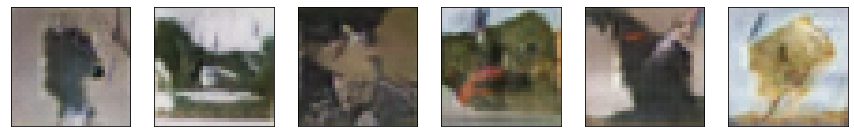

Epoch [72/100], Step[300/782], d_loss: 0.0957, g_loss: 3.2194


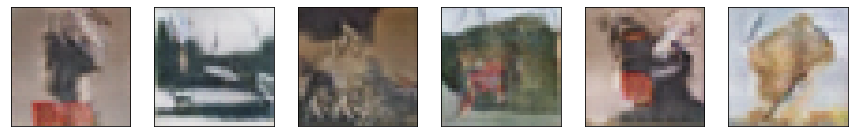

Epoch [72/100], Step[600/782], d_loss: 0.1471, g_loss: 2.3834


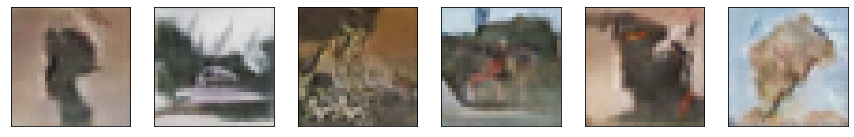

Epoch [73/100], Step[300/782], d_loss: 0.1044, g_loss: 3.7707


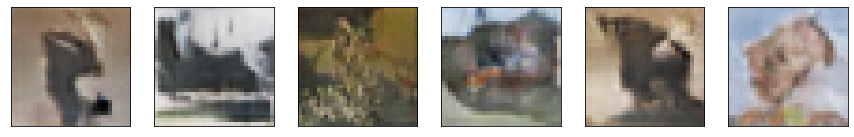

Epoch [73/100], Step[600/782], d_loss: 0.1354, g_loss: 2.9531


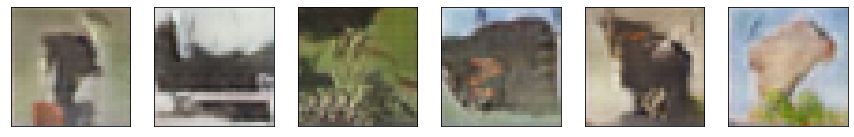

Epoch [74/100], Step[300/782], d_loss: 0.0256, g_loss: 3.2698


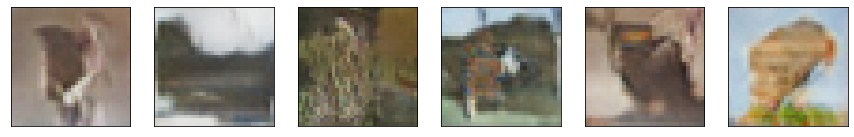

Epoch [74/100], Step[600/782], d_loss: 0.1672, g_loss: 2.8342


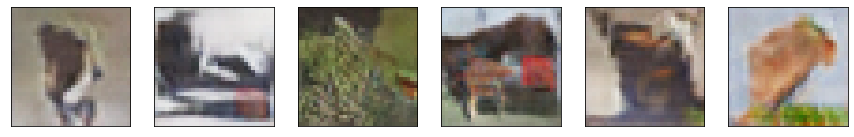

Epoch [75/100], Step[300/782], d_loss: 0.0941, g_loss: 2.9889


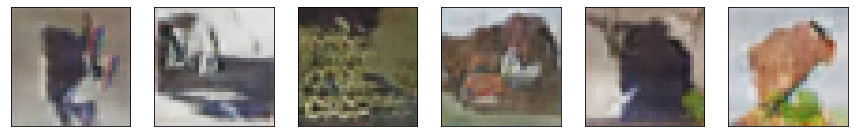

Epoch [75/100], Step[600/782], d_loss: 0.1745, g_loss: 2.3680


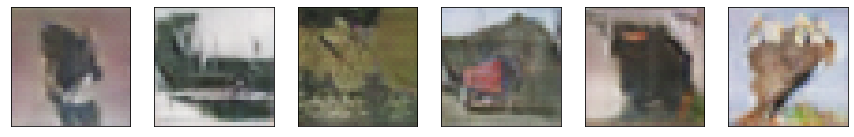

Epoch [76/100], Step[300/782], d_loss: 0.1910, g_loss: 2.6944


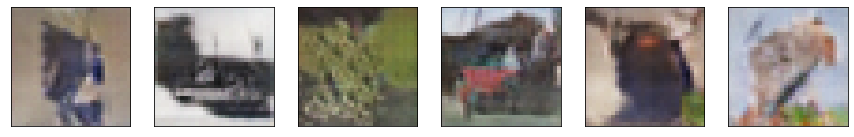

Epoch [76/100], Step[600/782], d_loss: 0.2924, g_loss: 4.1917


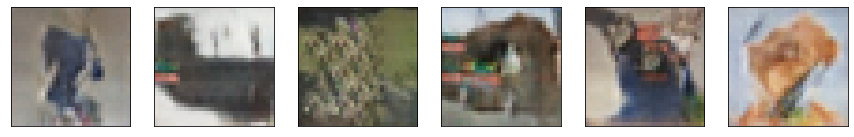

Epoch [77/100], Step[300/782], d_loss: 0.0938, g_loss: 2.9298


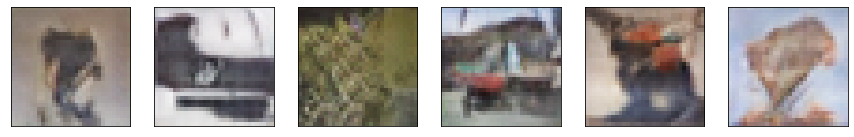

Epoch [77/100], Step[600/782], d_loss: 0.1920, g_loss: 2.3896


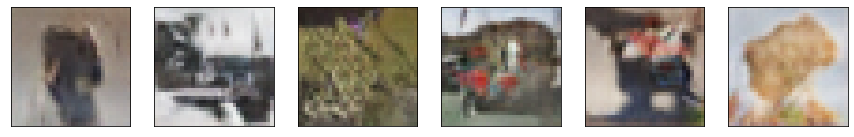

Epoch [78/100], Step[300/782], d_loss: 0.7734, g_loss: 1.6341


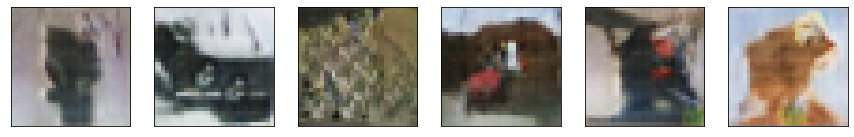

Epoch [78/100], Step[600/782], d_loss: 0.0995, g_loss: 3.3175


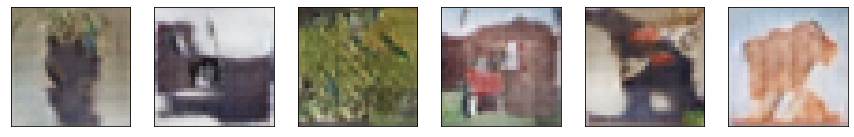

Epoch [79/100], Step[300/782], d_loss: 0.1093, g_loss: 2.3310


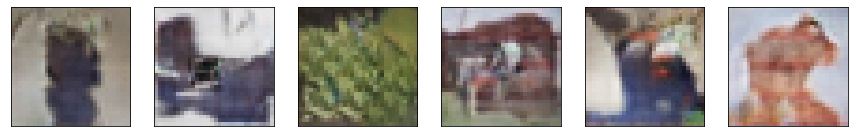

Epoch [79/100], Step[600/782], d_loss: 0.1666, g_loss: 2.3404


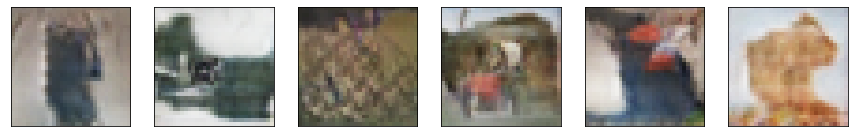

Epoch [80/100], Step[300/782], d_loss: 0.1104, g_loss: 3.5329


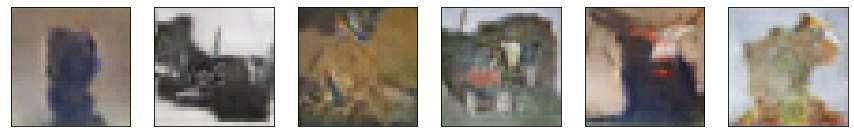

Epoch [80/100], Step[600/782], d_loss: 0.2380, g_loss: 3.5193


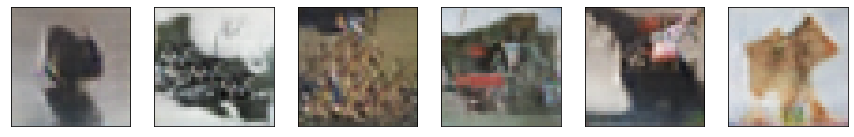

Epoch [81/100], Step[300/782], d_loss: 0.0925, g_loss: 2.3239


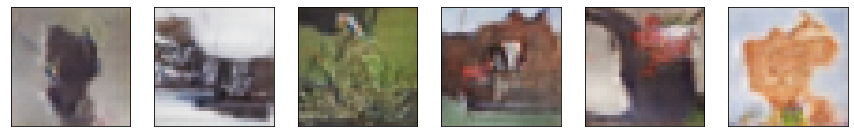

Epoch [81/100], Step[600/782], d_loss: 0.1521, g_loss: 3.9706


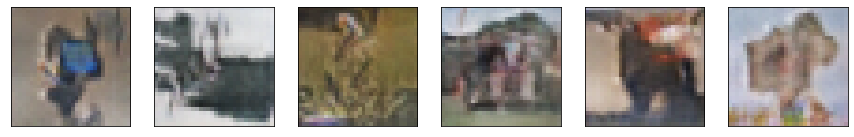

Epoch [82/100], Step[300/782], d_loss: 0.0837, g_loss: 3.2289


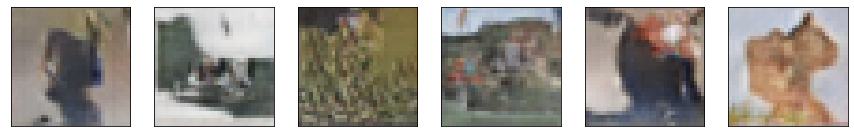

Epoch [82/100], Step[600/782], d_loss: 0.0811, g_loss: 3.1951


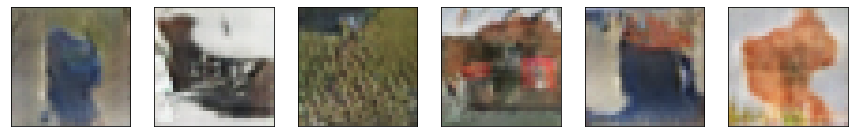

Epoch [83/100], Step[300/782], d_loss: 0.0664, g_loss: 3.4585


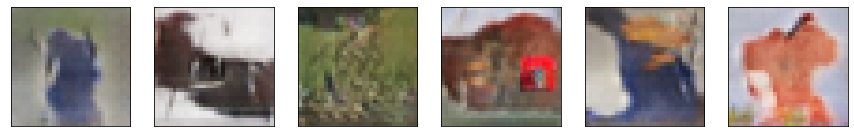

Epoch [83/100], Step[600/782], d_loss: 0.1058, g_loss: 3.3933


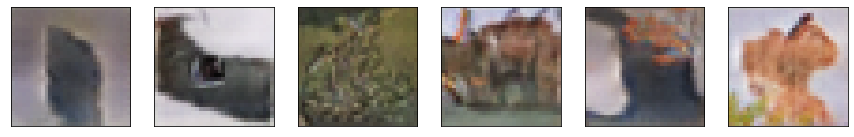

Epoch [84/100], Step[300/782], d_loss: 0.1680, g_loss: 3.0257


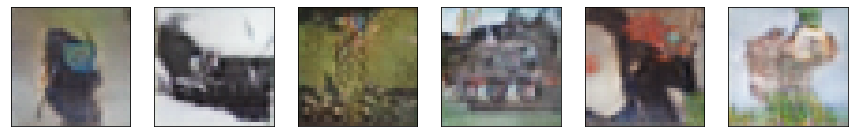

Epoch [84/100], Step[600/782], d_loss: 0.2245, g_loss: 3.2007


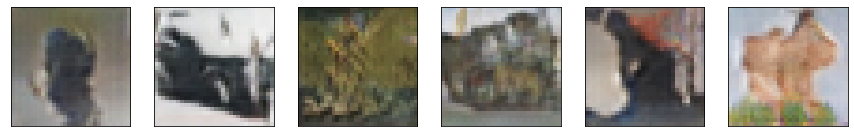

Epoch [85/100], Step[300/782], d_loss: 0.0647, g_loss: 2.9302


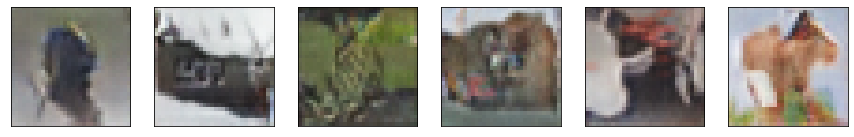

Epoch [85/100], Step[600/782], d_loss: 0.1143, g_loss: 2.5399


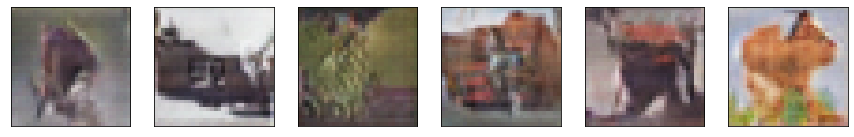

Epoch [86/100], Step[300/782], d_loss: 0.6872, g_loss: 2.5221


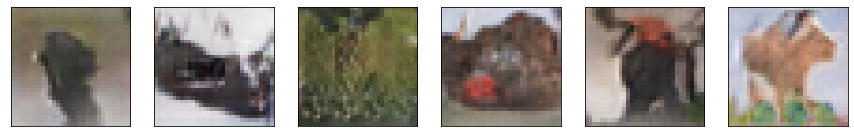

Epoch [86/100], Step[600/782], d_loss: 0.3509, g_loss: 3.7066


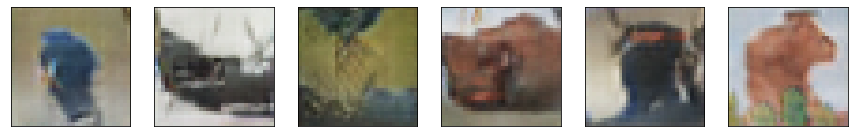

Epoch [87/100], Step[300/782], d_loss: 0.0658, g_loss: 3.4854


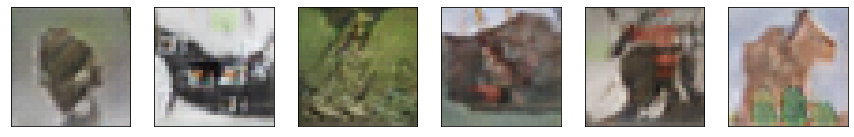

Epoch [87/100], Step[600/782], d_loss: 0.0878, g_loss: 3.0621


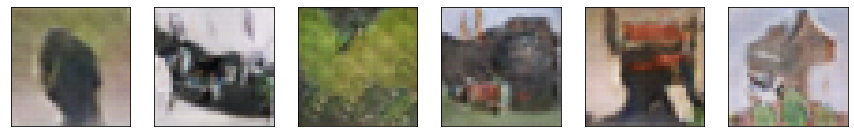

Epoch [88/100], Step[300/782], d_loss: 0.1805, g_loss: 3.0397


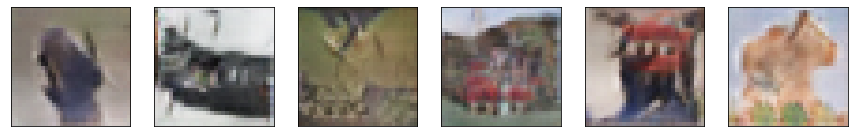

Epoch [88/100], Step[600/782], d_loss: 0.0922, g_loss: 3.5631


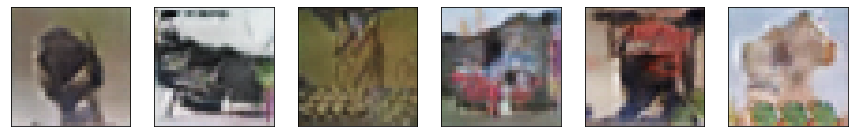

Epoch [89/100], Step[300/782], d_loss: 0.0897, g_loss: 3.8163


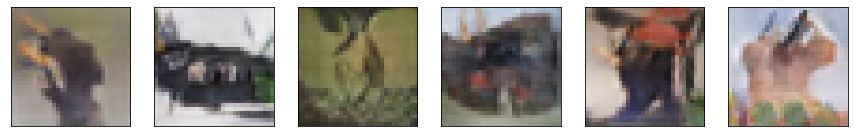

Epoch [89/100], Step[600/782], d_loss: 0.1184, g_loss: 2.9208


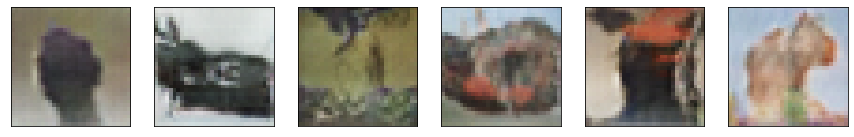

Epoch [90/100], Step[300/782], d_loss: 0.0650, g_loss: 3.4853


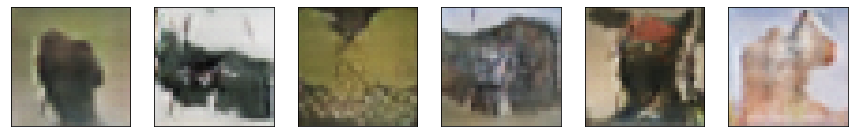

Epoch [90/100], Step[600/782], d_loss: 0.1483, g_loss: 3.0853


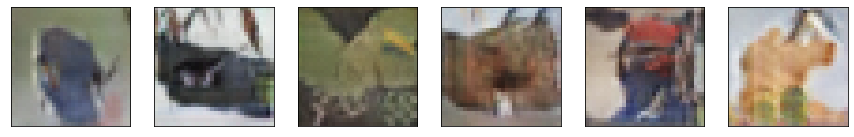

Epoch [91/100], Step[300/782], d_loss: 0.1762, g_loss: 3.5884


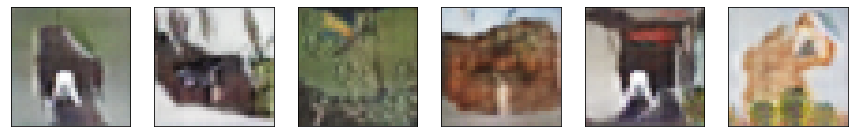

Epoch [91/100], Step[600/782], d_loss: 0.0728, g_loss: 3.3551


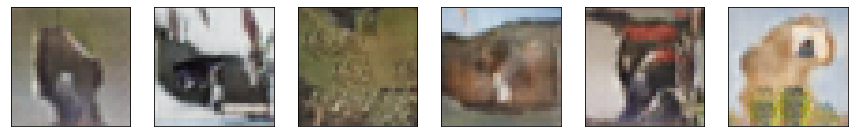

Epoch [92/100], Step[300/782], d_loss: 0.3244, g_loss: 2.5310


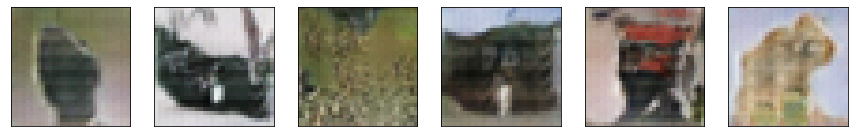

Epoch [92/100], Step[600/782], d_loss: 0.0541, g_loss: 3.5048


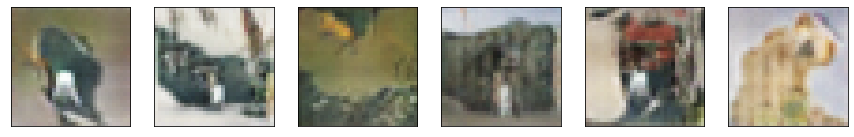

Epoch [93/100], Step[300/782], d_loss: 0.1491, g_loss: 3.3515


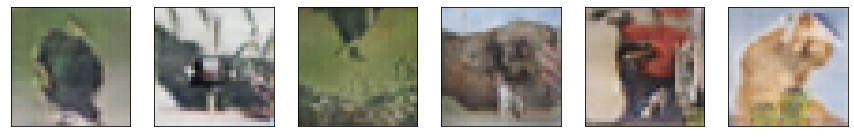

Epoch [93/100], Step[600/782], d_loss: 0.1305, g_loss: 2.8380


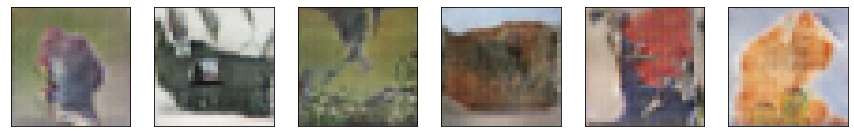

Epoch [94/100], Step[300/782], d_loss: 0.1237, g_loss: 3.3406


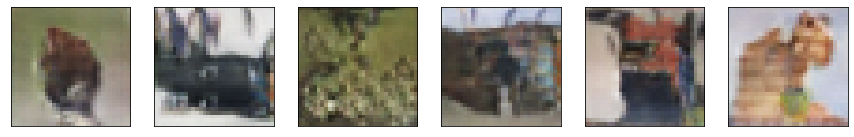

Epoch [94/100], Step[600/782], d_loss: 0.2545, g_loss: 3.1776


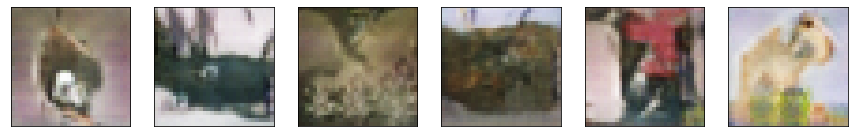

Epoch [95/100], Step[300/782], d_loss: 0.0477, g_loss: 3.4334


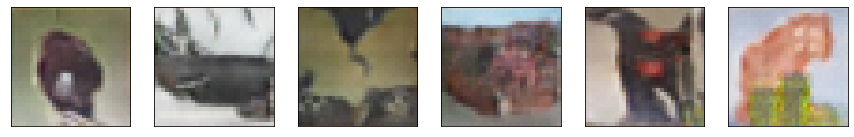

Epoch [95/100], Step[600/782], d_loss: 0.0539, g_loss: 3.6764


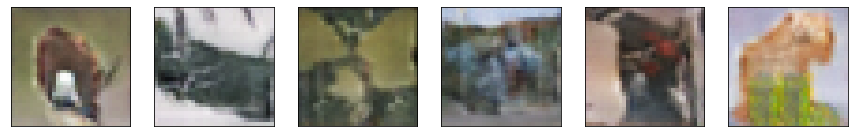

Epoch [96/100], Step[300/782], d_loss: 0.0781, g_loss: 2.9861


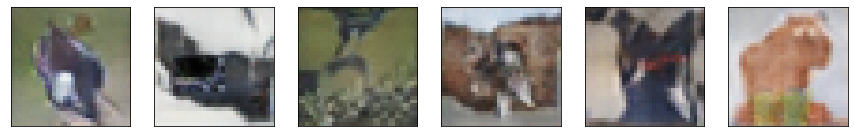

Epoch [96/100], Step[600/782], d_loss: 0.0845, g_loss: 2.3538


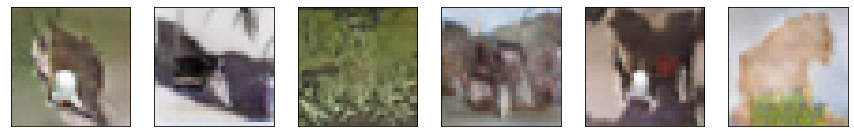

Epoch [97/100], Step[300/782], d_loss: 0.1983, g_loss: 3.5028


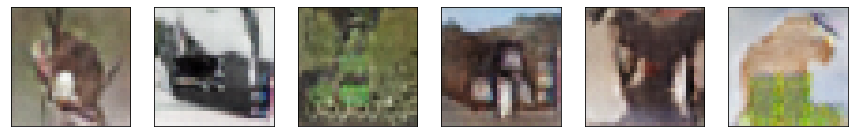

Epoch [97/100], Step[600/782], d_loss: 0.1906, g_loss: 3.3485


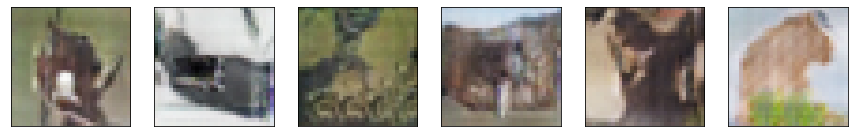

Epoch [98/100], Step[300/782], d_loss: 0.1289, g_loss: 3.3907


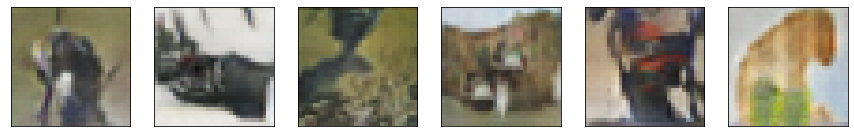

Epoch [98/100], Step[600/782], d_loss: 0.2088, g_loss: 3.2980


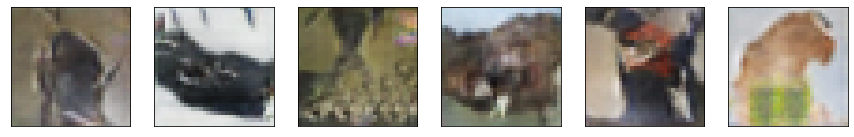

Epoch [99/100], Step[300/782], d_loss: 0.1355, g_loss: 4.3202


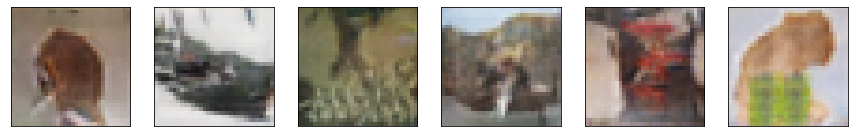

Epoch [99/100], Step[600/782], d_loss: 0.0469, g_loss: 3.5061


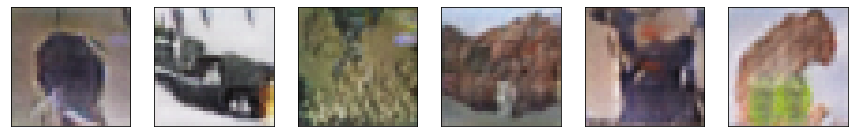

In [ ]:
fixed_z = torch.randn(6,256).cuda()

for epoch in range(100):
    for i, (images, _) in enumerate(train_dataloader):
        G.train()
        D.train()

        # Build mini-batch dataset
        batch_size = images.size(0)
        
        images = images.cuda()

        # Create the labels which are later used as input for the BCE loss
        real_labels = torch.ones(batch_size).cuda()
        fake_labels = torch.zeros(batch_size).cuda()

        #============= Train the discriminator =============#
        # Compute BCE_Loss using real images
        outputs = D(images)
        d_loss_real = criterion(outputs, real_labels)
        real_score = outputs

        # Compute BCELoss using fake images
        z = torch.randn(batch_size, 256).cuda()
        fake_images = G(z)
        outputs = D(fake_images)
        d_loss_fake = criterion(outputs, fake_labels)
        fake_score = outputs

        # Backprop + Optimize
        D.zero_grad()
        d_loss_real.backward()
        d_loss_fake.backward()
        d_loss = d_loss_real + d_loss_fake
        d_optimizer.step()

        #=============== Train the generator ===============#
        # Compute loss with fake images
        z = torch.randn(batch_size, 256).cuda()
        fake_images = G(z)
        outputs = D(fake_images)

        # We train G to maximize log(D(G(z)) instead of minimizing log(1-D(G(z)))
        # For the reason, see the last paragraph of section 3. https://arxiv.org/pdf/1406.2661.pdf
        g_loss = criterion(outputs, real_labels)

        # Backprop + Optimize
        G.zero_grad()
        g_loss.backward()
        g_optimizer.step()

        if (i+1) % 300 == 0:
            print('======================================================================================================')
            print('Epoch [%d/%d], Step[%d/%d], d_loss: %.4f, g_loss: %.4f' 
                  %(epoch, 100, i+1, len(train_dataloader), d_loss.item(), g_loss.item()))
            print('======================================================================================================')
            
            G.eval()
            fake_images = G(fixed_z)
            fake_images = denorm(fake_images)
            
            images_to_show = fake_images.data.cpu().numpy().transpose((0,2,3,1))
            images_row = images_to_show[:6] 

            plt.figure(figsize=(15,75))
            
            for a in range(161, 167):    
                plt.subplot(a)
                plt.imshow(images_row[a-161])
                plt.xticks([])
                plt.yticks([])
            plt.show()

# 2. Pix2Pix with Facades dataset

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data as data
from torch.utils.data import DataLoader
import torchvision.transforms as T

from PIL import Image
import matplotlib.pyplot as plt
from math import log10

import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

In [ ]:
from google.colab import drive


drive.mount('/content/drive')
os.chdir('/content/drive/MyDrive/Colab Notebooks/수업/20211228(Image generation and translation)')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## 2-0. Define dataset & dataloader

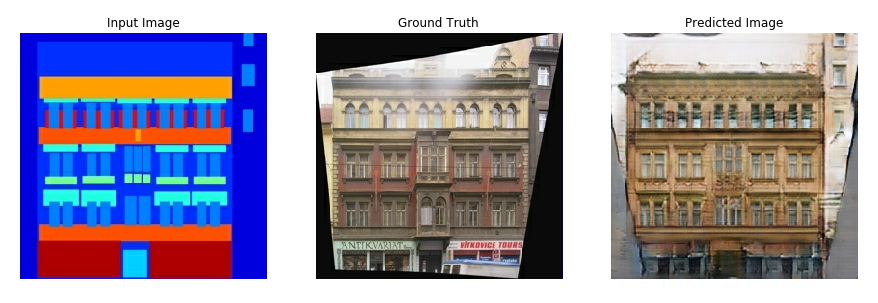

In [ ]:
class DatasetFromFolder(data.Dataset):
    def __init__(self, image_dir, direction):
        super(DatasetFromFolder, self).__init__()
        self.direction = direction
        self.a_path = os.path.join(image_dir, "a") # Building picture
        self.b_path = os.path.join(image_dir, "b") # Segmentation mask
        self.image_filenames = [x for x in os.listdir(self.a_path)]
        self.transform = T.Compose([T.Resize((256, 256)),
                                    T.ToTensor(),
                                    T.Normalize(mean=(0.5, 0.5, 0.5),
                                                std=(0.5, 0.5, 0.5))])
        
    def __getitem__(self, index):
        a = Image.open(os.path.join(self.a_path, self.image_filenames[index])).convert('RGB')
        b = Image.open(os.path.join(self.b_path, self.image_filenames[index])).convert('RGB')

        a = self.transform(a)
        b = self.transform(b)

        if self.direction == "a2b":
            return a, b
        else:
            return b, a
    
    def __len__(self):
        return len(self.image_filenames)

In [ ]:
train_set = DatasetFromFolder("./data/facades/train/", "b2a")
test_set = DatasetFromFolder("./data/facades/test/", "b2a")

trainDataLoader = DataLoader(dataset=train_set, num_workers=4, batch_size=1, shuffle=True)
testDataLoader = DataLoader(dataset=test_set, num_workers=4, batch_size=1, shuffle=False)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


In [ ]:
def denorm(x):
    out = (x + 1) / 2
    return out.clamp(0, 1)

def show_images(real_a, real_b, fake_b):
    plt.figure(figsize=(30,90))
    plt.subplot(131)
    plt.imshow(real_a.cpu().data.numpy().transpose(1,2,0))
    plt.xticks([])
    plt.yticks([])
    
    plt.subplot(132)
    plt.imshow(real_b.cpu().data.numpy().transpose(1,2,0))
    plt.xticks([])
    plt.yticks([])
    
    plt.subplot(133)
    plt.imshow(fake_b.cpu().data.numpy().transpose(1,2,0))
    plt.xticks([])
    plt.yticks([])
    
    plt.show()

## 2-1. Make Pix2Pix

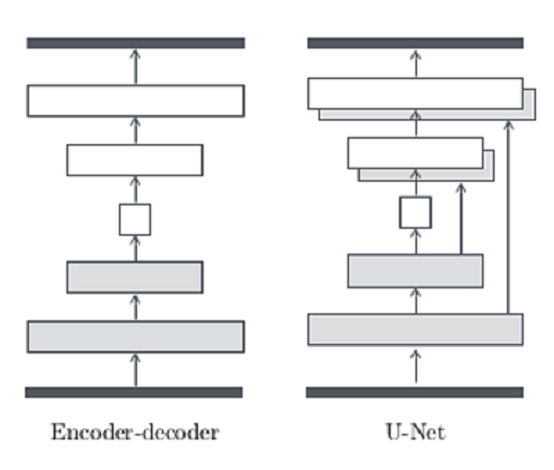

In [ ]:
def conv(c_in, c_out, k_size, stride=2, pad=1, bn=True, activation='lrelu'):
    layers = []

    # Conv
    layers.append(nn.Conv2d(c_in, c_out, k_size, stride, pad, bias=False))

    # Batchnorm
    if bn:
        layers.append(nn.BatchNorm2d(c_out))
    
    # Activation
    if activation == 'lrelu':
        layers.append(nn.LeakyReLU(0.2))
    elif activation == 'relu':
        layers.append(nn.ReLU())
    elif activation == 'tanh':
        layers.append(nn.Tanh())
    elif activation == 'none':
        pass

    return nn.Sequential(*layers)


def deconv(c_in, c_out, k_size, stride=2, pad=1, bn=True, activation='lrelu'):
    layers = []

    # Deconv
    layers.append(nn.ConvTranspose2d(c_in, c_out, k_size, stride, pad, bias=False))

    # Batchnorm
    if bn:
        layers.append(nn.BatchNorm2d(c_out))
    
    # Activation
    if activation == 'lrelu':
        layers.append(nn.LeakyReLU(0.2))
    elif activation == 'relu':
        layers.append(nn.ReLU())
    elif activation == 'tanh':
        layers.append(nn.Tanh())
    elif activation == 'none':
        pass
    
    return nn.Sequential(*layers)

In [ ]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        # Unet encoder
        self.conv1 = conv(3, 64, 4, bn=False, activation='lrelu') # (B, 64, 128, 128)
        self.conv2 = conv(64, 128, 4, activation='lrelu') # (B, 128, 64, 64)
        self.conv3 = conv(128, 256, 4, activation='lrelu') # (B, 256, 32, 32)
        self.conv4 = conv(256, 512, 4, activation='lrelu') # (B, 512, 16, 16)
        self.conv5 = conv(512, 512, 4, activation='lrelu') # (B, 512, 8, 8)
        self.conv6 = conv(512, 512, 4, activation='lrelu') # (B, 512, 4, 4)
        self.conv7 = conv(512, 512, 4, activation='lrelu') # (B, 512, 2, 2)
        self.conv8 = conv(512, 512, 4, bn=False, activation='relu') # (B, 512, 1, 1)

        # Unet decoder
        self.deconv1 = deconv(512, 512, 4, activation='relu') # (B, 512, 2, 2)
        self.deconv2 = deconv(1024, 512, 4, activation='relu') # (B, 512, 4, 4)
        self.deconv3 = deconv(1024, 512, 4, activation='relu') # (B, 512, 8, 8) # Hint : U-Net에서는 Encoder에서 넘어온 Feature를 Concat합니다! (Channel이 2배)
        self.deconv4 = deconv(1024, 512, 4, activation='relu') # (B, 512, 16, 16)
        self.deconv5 = deconv(1024, 256, 4, activation='relu') # (B, 256, 32, 32)
        self.deconv6 = deconv(512, 128, 4, activation='relu') # (B, 128, 64, 64)
        self.deconv7 = deconv(256, 64, 4, activation='relu') # (B, 64, 128, 128)
        self.deconv8 = deconv(128, 3, 4, activation='tanh') # (B, 3, 256, 256)

    def forward(self, input):
        # Unet encoder
        e1 = self.conv1(input)
        e2 = self.conv2(e1)
        e3 = self.conv3(e2)
        e4 = self.conv4(e3)
        e5 = self.conv5(e4)
        e6 = self.conv6(e5)
        e7 = self.conv7(e6)
        e8 = self.conv8(e7)

        # Unet decoder
        d1 = F.dropout(self.deconv1(e8), 0.5, training=True)
        d2 = F.dropout(self.deconv2(torch.cat([d1, e7], 1)), 0.5, training=True)
        d3 = F.dropout(self.deconv3(torch.cat([d2, e6], 1)), 0.5, training=True)
        d4 = F.dropout(self.deconv4(torch.cat([d3, e5], 1)), 0.5, training=True)
        d5 = F.dropout(self.deconv5(torch.cat([d4, e4], 1)), 0.5, training=True)
        d6 = F.dropout(self.deconv6(torch.cat([d5, e3], 1)), 0.5, training=True)
        d7 = F.dropout(self.deconv7(torch.cat([d6, e2], 1)), 0.5, training=True)
        output = self.deconv8(torch.cat([d7, e1], 1))
        
        return output


In [ ]:
class Discriminator(nn.Module):
    # initializers
    def __init__(self):
        super(Discriminator, self).__init__()
        self.conv1 = conv(6, 64, 4, bn=False, activation='lrelu')
        self.conv2 = conv(64, 128, 4, activation='lrelu')
        self.conv3 = conv(128, 256, 4, activation='lrelu')
        self.conv4 = conv(256, 512, 4, 1, 1, activation='lrelu')
        self.conv5 = conv(512, 1, 4, 1, 1, activation='none')
    
    # forward method
    def forward(self, input):
        out = self.conv1(input)
        out = self.conv2(out)
        out = self.conv3(out)
        out = self.conv4(out)
        out = torch.sigmoid(self.conv5(out))

        return out

In [ ]:
G = Generator().cuda()
D = Discriminator().cuda()

## 2-2. Train model

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/torch/nn/modules/loss.py:520: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1, 30, 30])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/200], Step[201/400], d_loss: 0.2354, g_loss: 4.5423


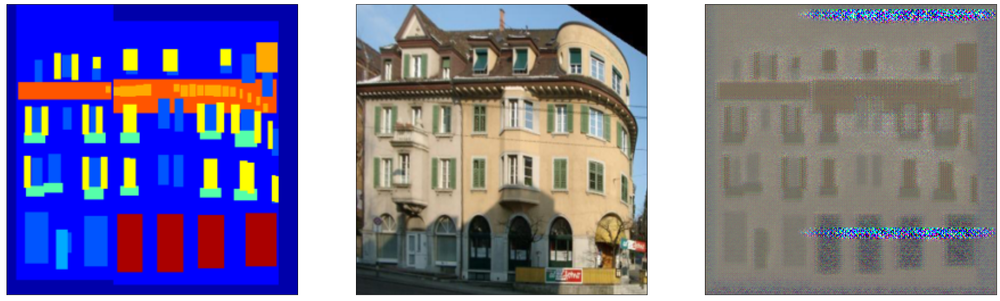

Epoch [1/200], Step[401/400], d_loss: 0.2367, g_loss: 4.8078


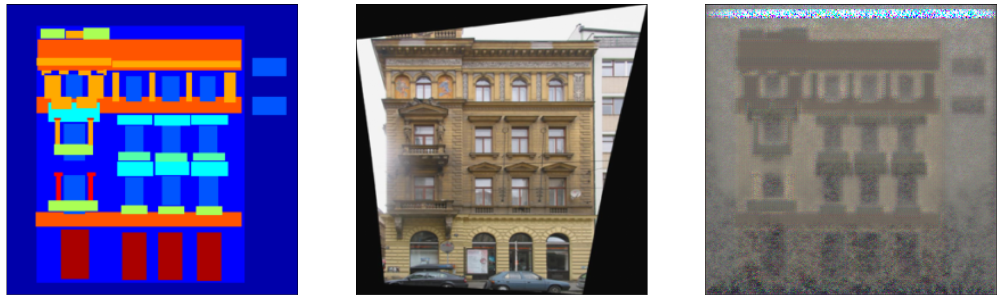

Epoch [2/200], Step[201/400], d_loss: 0.2388, g_loss: 5.1011


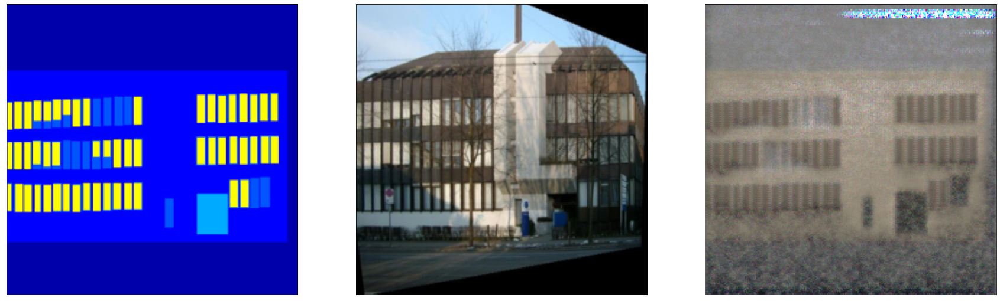

Epoch [2/200], Step[401/400], d_loss: 0.2298, g_loss: 4.2385


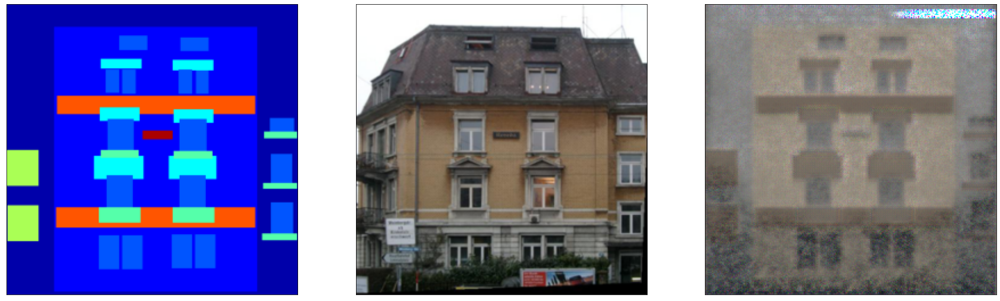

Epoch [3/200], Step[201/400], d_loss: 0.2313, g_loss: 3.9373


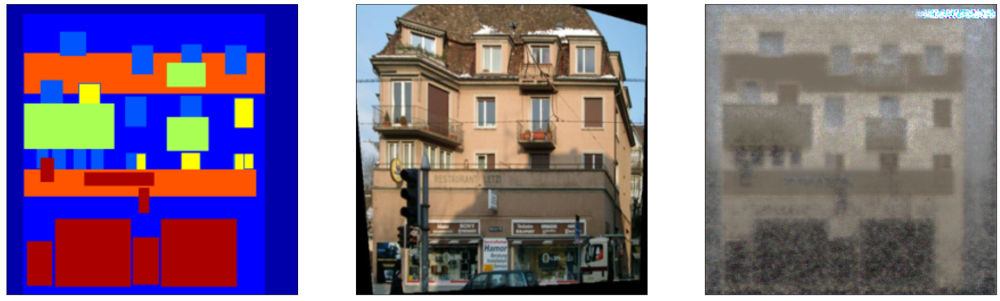

Epoch [3/200], Step[401/400], d_loss: 0.2694, g_loss: 2.7331


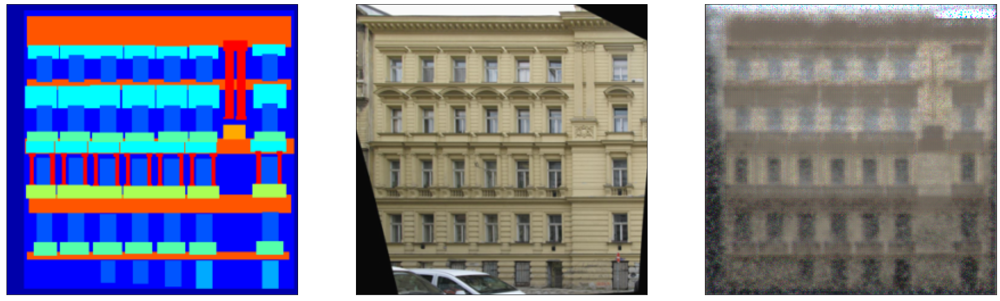

Epoch [4/200], Step[201/400], d_loss: 0.2269, g_loss: 3.0569


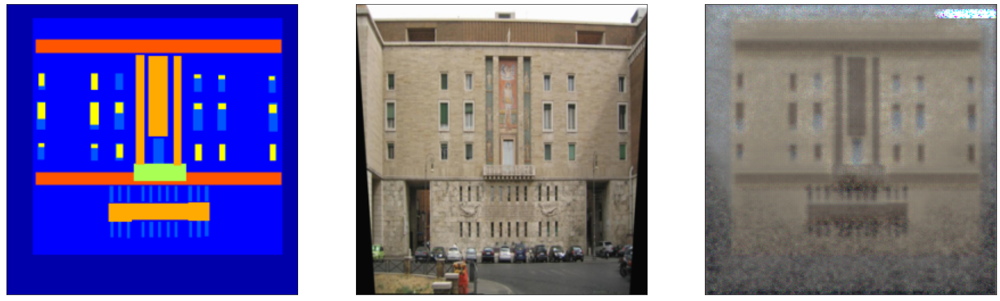

Epoch [4/200], Step[401/400], d_loss: 0.2323, g_loss: 3.1491


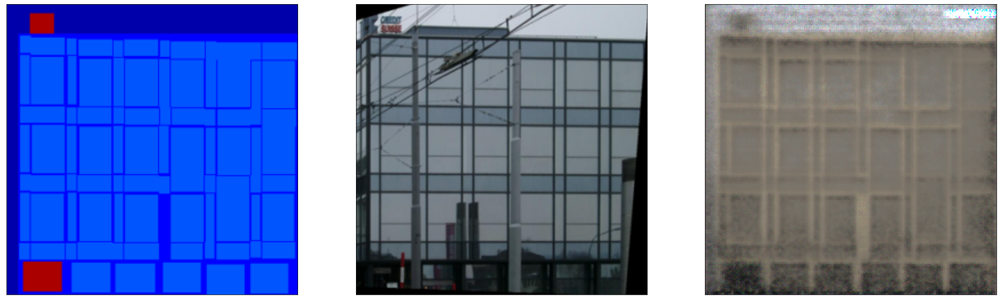

Epoch [5/200], Step[201/400], d_loss: 0.2298, g_loss: 3.3980


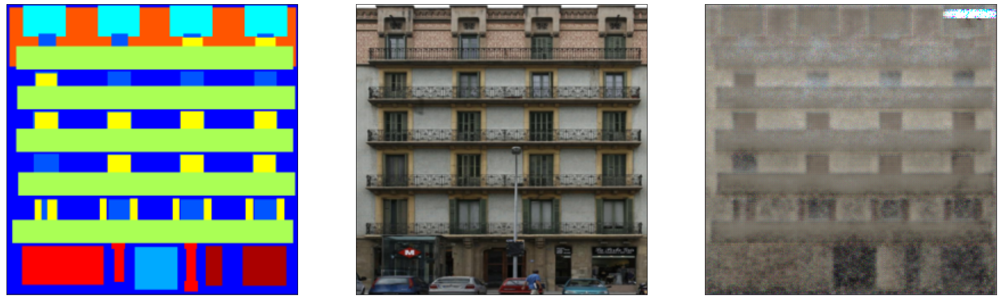

Epoch [5/200], Step[401/400], d_loss: 0.2226, g_loss: 3.6555


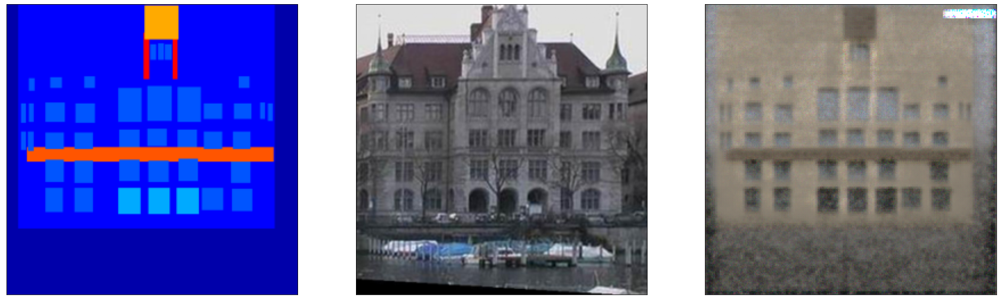

Epoch [6/200], Step[201/400], d_loss: 0.2239, g_loss: 3.4754


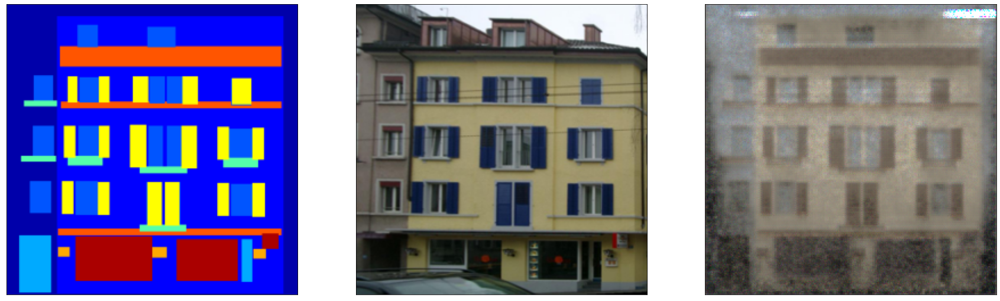

Epoch [6/200], Step[401/400], d_loss: 0.2191, g_loss: 4.5236


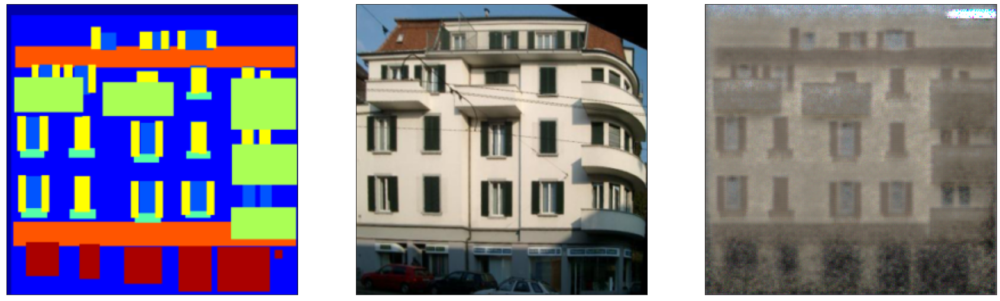

Epoch [7/200], Step[201/400], d_loss: 0.2205, g_loss: 3.4548


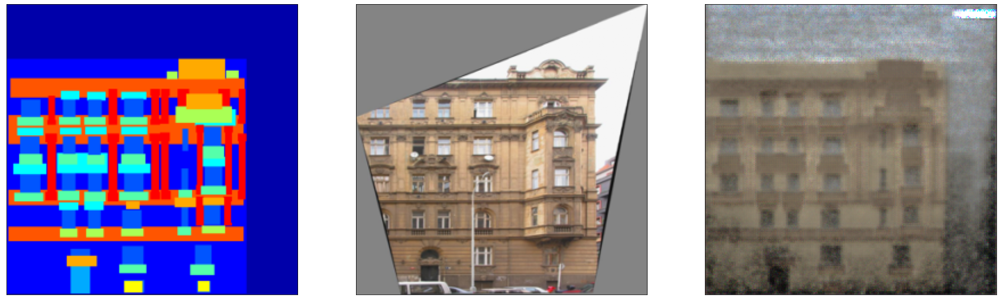

Epoch [7/200], Step[401/400], d_loss: 0.2306, g_loss: 4.0528


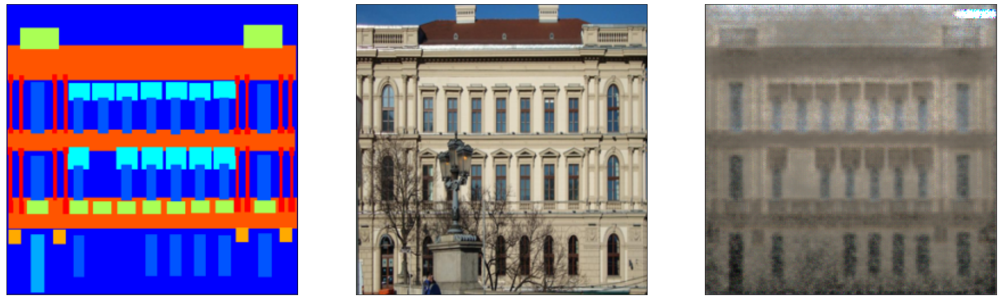

Epoch [8/200], Step[201/400], d_loss: 0.2227, g_loss: 3.0117


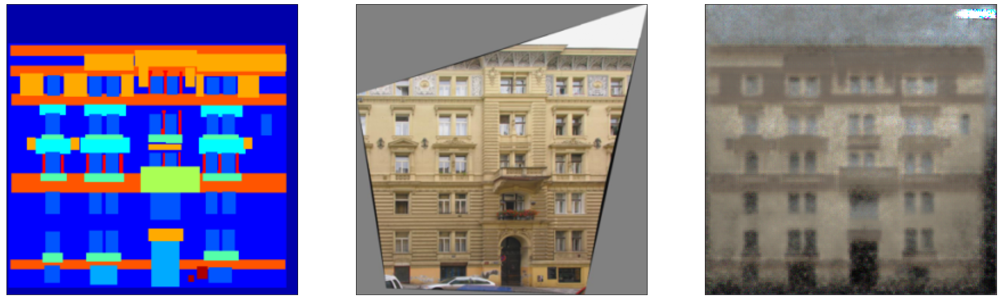

Epoch [8/200], Step[401/400], d_loss: 0.2200, g_loss: 3.1008


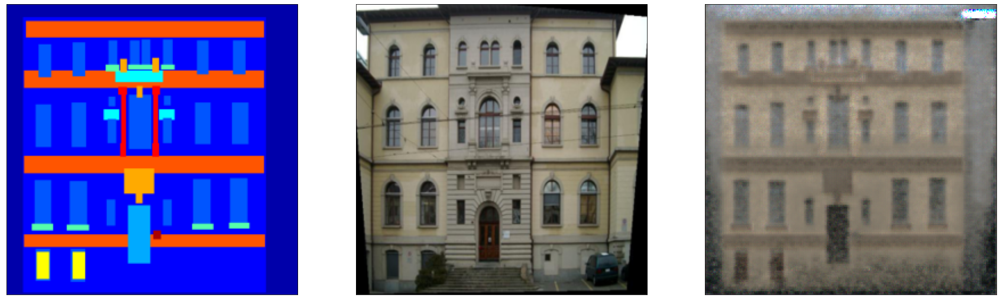

Epoch [9/200], Step[201/400], d_loss: 0.2174, g_loss: 3.8067


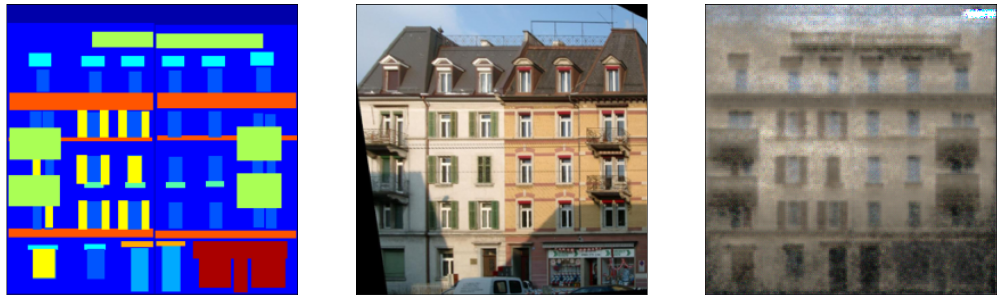

Epoch [9/200], Step[401/400], d_loss: 0.2564, g_loss: 3.5553


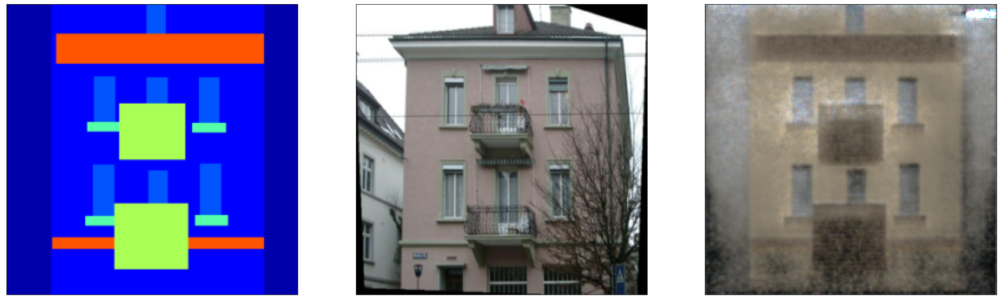

Epoch [10/200], Step[201/400], d_loss: 0.2209, g_loss: 3.1747


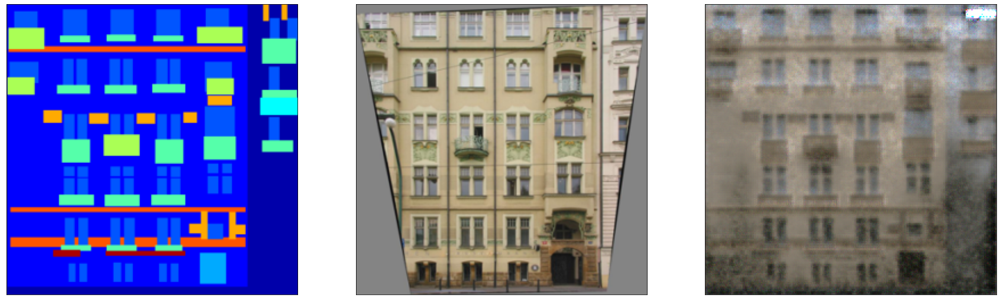

Epoch [10/200], Step[401/400], d_loss: 0.2110, g_loss: 3.1108


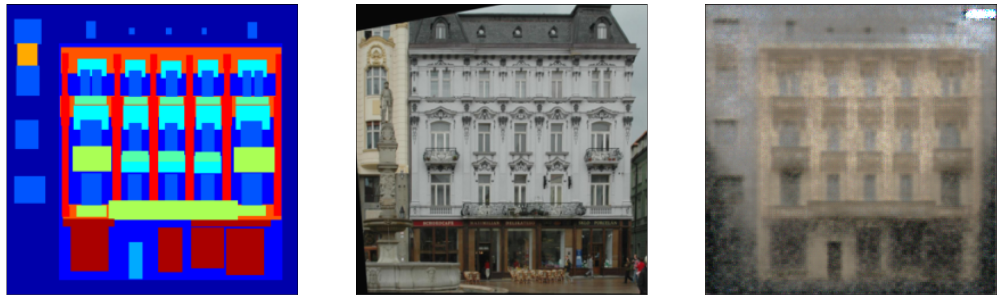

Epoch [11/200], Step[201/400], d_loss: 0.2161, g_loss: 4.1820


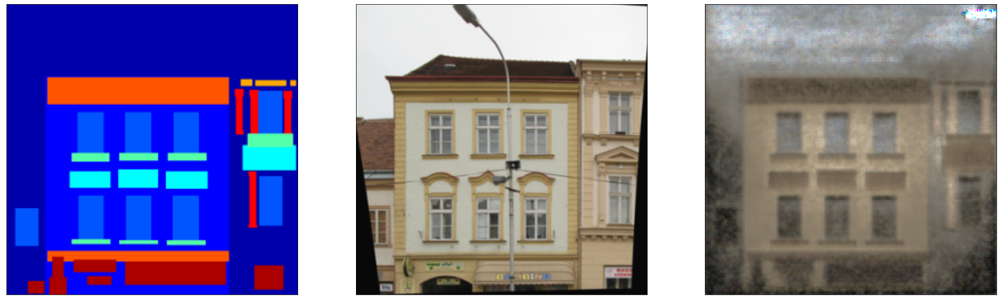

Epoch [11/200], Step[401/400], d_loss: 0.2084, g_loss: 4.1093


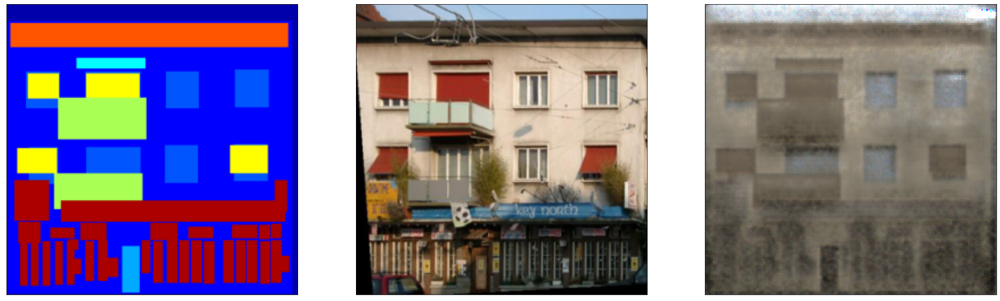

Epoch [12/200], Step[201/400], d_loss: 0.2076, g_loss: 4.0079


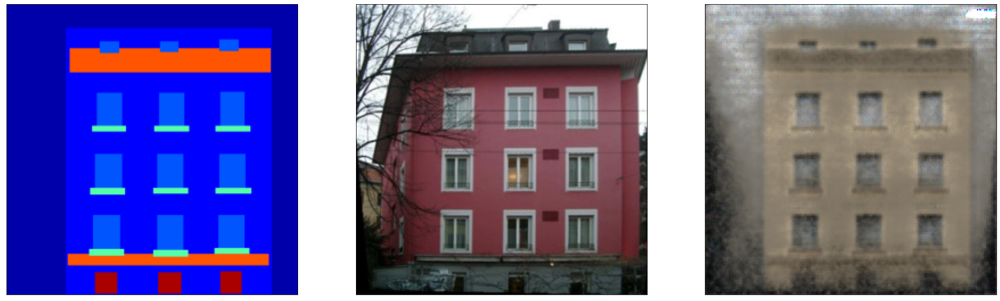

Epoch [12/200], Step[401/400], d_loss: 0.2033, g_loss: 3.4043


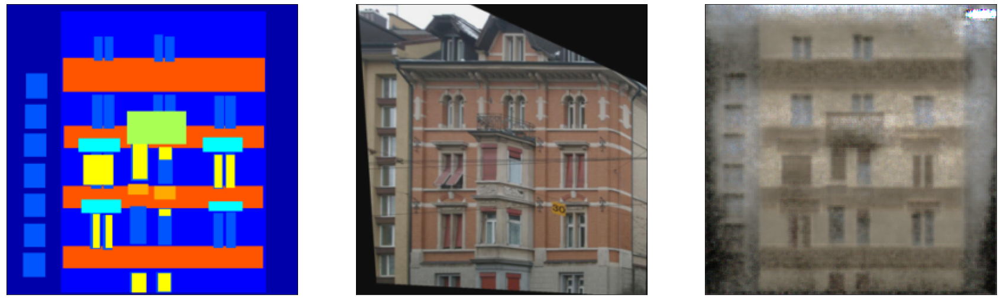

Epoch [13/200], Step[201/400], d_loss: 0.2066, g_loss: 2.6361


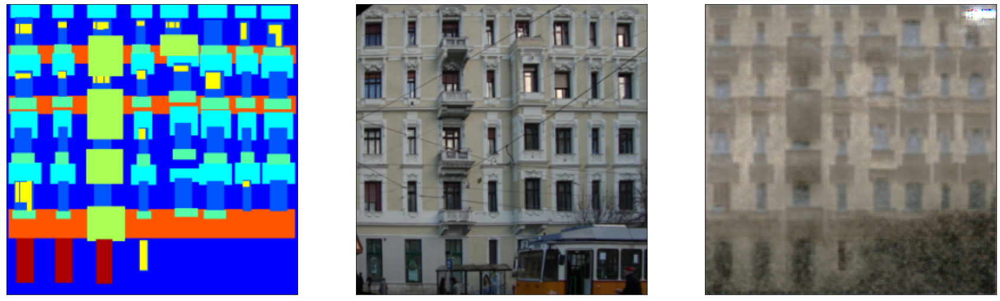

Epoch [13/200], Step[401/400], d_loss: 0.2025, g_loss: 3.1228


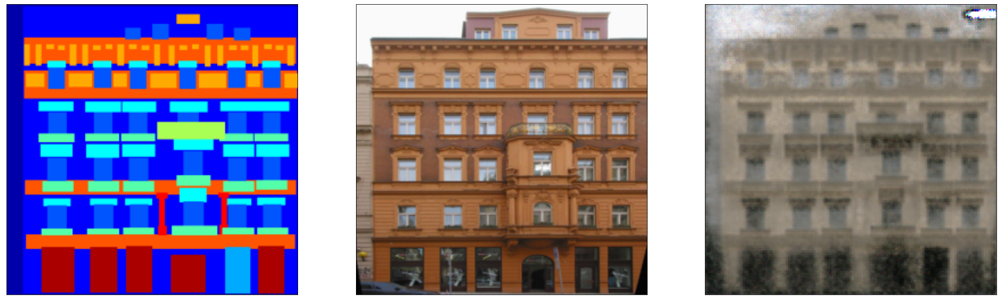

Epoch [14/200], Step[201/400], d_loss: 0.2023, g_loss: 3.1084


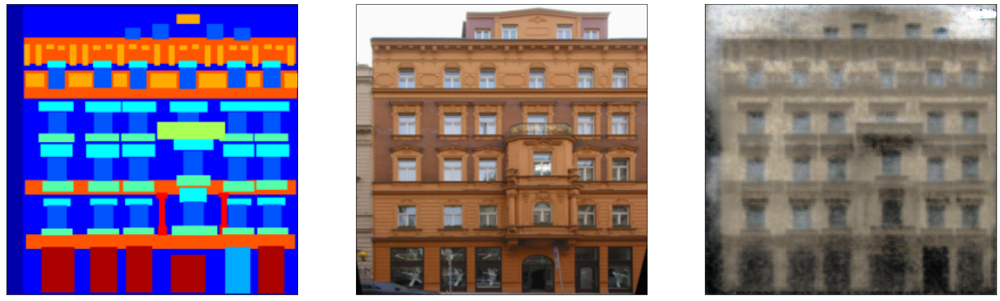

Epoch [14/200], Step[401/400], d_loss: 0.2020, g_loss: 3.1460


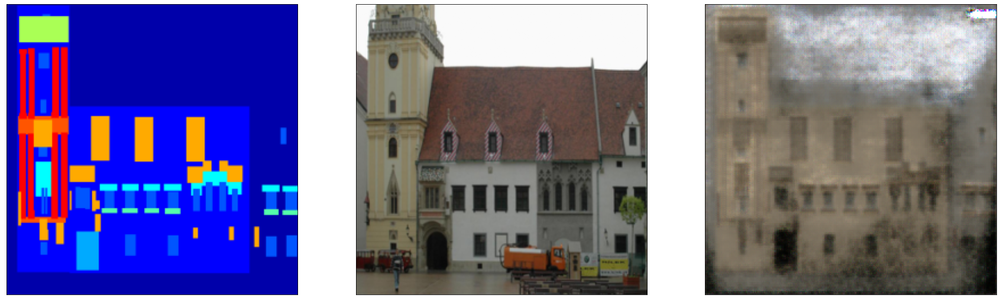

Epoch [15/200], Step[201/400], d_loss: 0.1994, g_loss: 3.1863


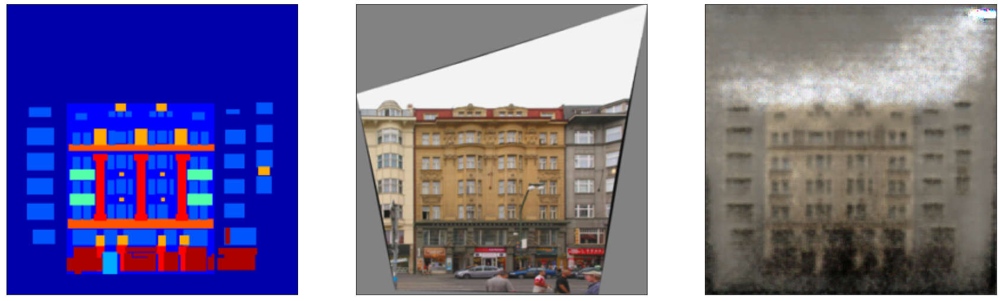

Epoch [15/200], Step[401/400], d_loss: 0.2010, g_loss: 2.4302


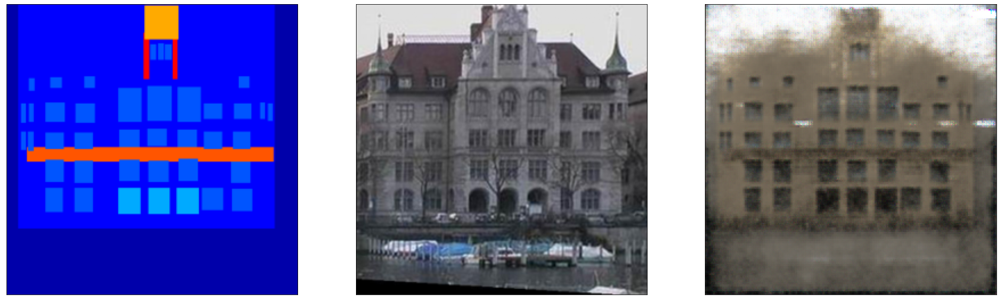

Epoch [16/200], Step[201/400], d_loss: 0.1948, g_loss: 4.1932


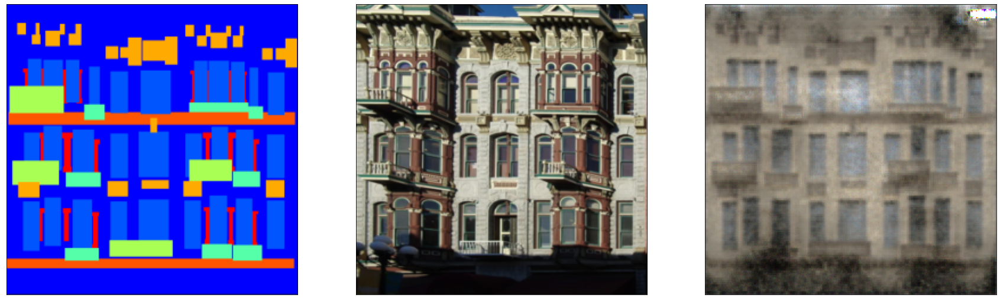

Epoch [16/200], Step[401/400], d_loss: 0.1952, g_loss: 3.4828


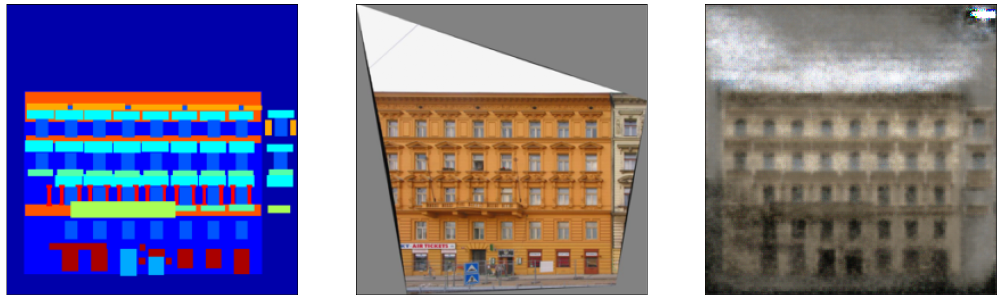

Epoch [17/200], Step[201/400], d_loss: 0.1935, g_loss: 2.8539


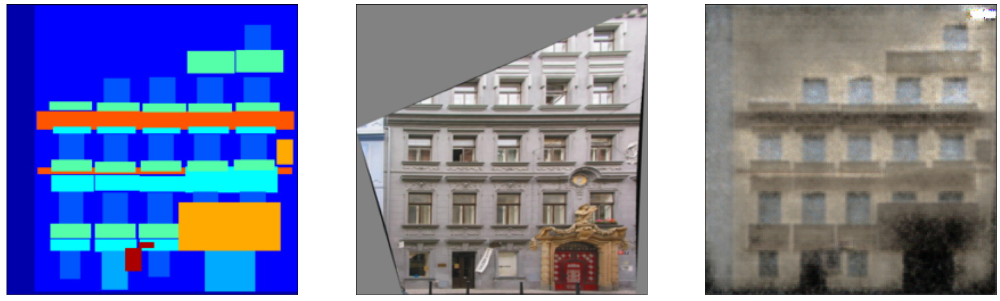

Epoch [17/200], Step[401/400], d_loss: 0.1957, g_loss: 2.8688


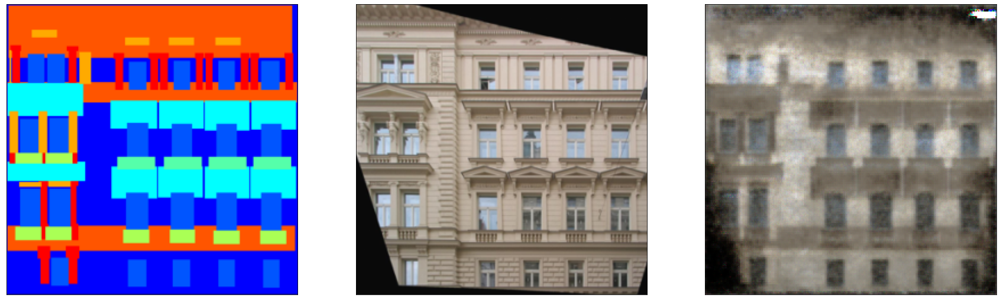

Epoch [18/200], Step[201/400], d_loss: 0.1891, g_loss: 2.7413


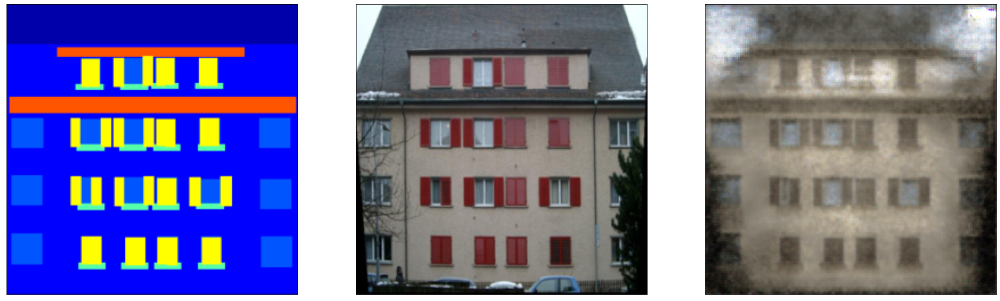

Epoch [18/200], Step[401/400], d_loss: 0.1889, g_loss: 3.1686


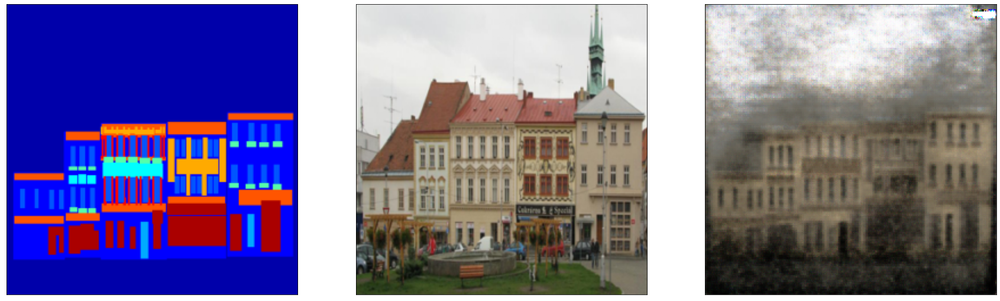

Epoch [19/200], Step[201/400], d_loss: 0.1926, g_loss: 2.6399


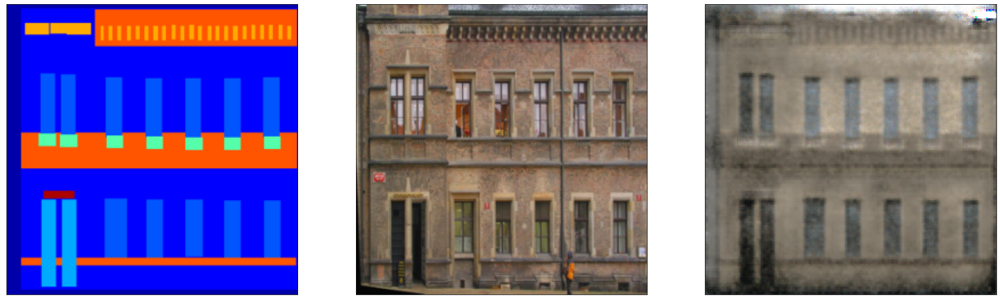

Epoch [19/200], Step[401/400], d_loss: 0.1967, g_loss: 4.0206


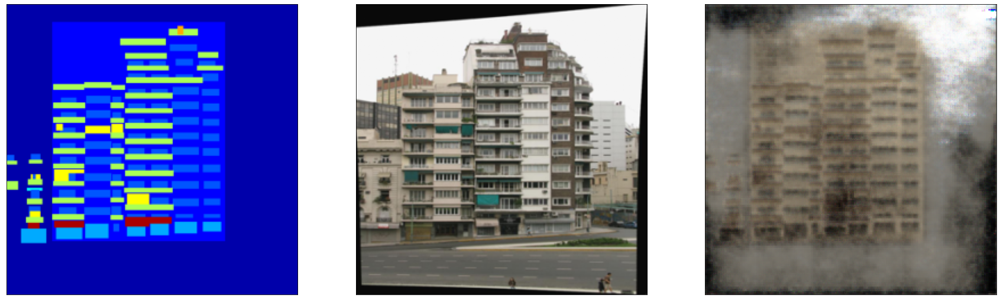

In [ ]:
criterionL1 = nn.L1Loss().cuda()
criterionMSE = nn.MSELoss().cuda()

# setup optimizer
g_optimizer = optim.Adam(G.parameters(), lr=0.0002, betas=(0.5, 0.999))
d_optimizer = optim.Adam(D.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Training
for epoch in range(1, 20):
    for i, (real_a, real_b) in enumerate(trainDataLoader, 1):
        # forward
        real_a, real_b = real_a.cuda(), real_b.cuda()
        
        real_label = torch.ones(1).cuda()
        fake_label = torch.zeros(1).cuda()
        
        fake_b = G(real_a)
        
        # a : segmentation image
        # b : real image
        #============= Train the discriminator =============#
        # train with fake
        fake_ab = torch.cat((real_a, fake_b),1)
        pred_fake = D(fake_ab.detach())
        loss_d_fake = criterionMSE(pred_fake, fake_label) 
        # train with real
        real_ab = torch.cat((real_a, real_b),1)
        pred_real = D(real_ab)
        loss_d_real = criterionMSE(pred_real, real_label)
        # Combined D loss
        loss_d = (loss_d_real + loss_d_fake) / 2
        # Backprop + Optimize
        D.zero_grad()
        loss_d.backward()
        d_optimizer.step()

        #=============== Train the generator ===============#
        # First, G(A) should fake the discriminator
        fake_ab = torch.cat((real_a, fake_b),1)
        pred_fake = D(fake_ab)
        loss_g_gan = criterionMSE(pred_fake, real_label)
        # Second, G(A) = B
        loss_g_l1 = criterionL1(fake_b, real_b) * 10
        loss_g = loss_g_gan + loss_g_l1
        # Backprop + Optimize
        G.zero_grad()
        D.zero_grad()
        loss_g.backward()
        g_optimizer.step()
        
        if i % 200 == 0:
            print('======================================================================================================')
            print('Epoch [%d/%d], Step[%d/%d], d_loss: %.4f, g_loss: %.4f'
                  % (epoch, 200, i+1, len(trainDataLoader), loss_d.item(), loss_g.item()))
            print('======================================================================================================')
            show_images(denorm(real_a.squeeze()), denorm(real_b.squeeze()), denorm(fake_b.squeeze()))

## 2-3. Test model

In [ ]:
avg_psnr = 0
for (real_a, real_b) in testDataLoader:
    real_a, real_b = real_a.cuda(), real_b.cuda()
    fake_b = G(real_a)
    
    mse = criterionMSE(fake_b, real_b)
    psnr = 10 * log10(1 / mse.item())
    avg_psnr += psnr
print("Avg. PSNR: {:.4f} dB".format(avg_psnr / len(testDataLoader)))

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Avg. PSNR: 6.8987 dB


# 3. CycleGAN with SVHN and MNIST

In [ ]:
# pyTorch 관련 된 라이브러리.
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim # optimization에 관한 모듈.
import torchvision # 이미지 관련 전처리, pretrained된 모델, 데이터 로딩에 관한 패키지입니다.
import torchvision.datasets as datasets
import torchvision.transforms as T # 이미지 전처리 모듈입니다.
from torch.utils import data

# 기타 필요한 라이브러리.
import numpy as np
import matplotlib.pyplot as plt
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

![CycleGAN](https://github.com/yunjey/mnist-svhn-transfer/blob/master/gif/cyclegan.png?raw=true)

## 3-0. Define dataset & dataloader

In [ ]:
def MNIST_DATA(root='./data/', download=True, batch_size=32, num_worker=4):
    print("[+] Get the MNIST DATA")

    transform = T.Compose([T.Resize(32), T.ToTensor()])

    mnist_train = datasets.MNIST(root=root, train=True, transform=transform, download=True)
    mnist_test = datasets.MNIST(root=root, train=False, transform=transform, download=True)

    trainDataLoader = data.DataLoader(dataset=mnist_train, batch_size=batch_size, shuffle=True, num_workers=num_worker)
    testDataLoader = data.DataLoader(dataset=mnist_test, batch_size=batch_size, shuffle=False, num_workers=num_worker)

    print("[+] Finished loading data & Preprocessing")

    return mnist_train, mnist_test, trainDataLoader, testDataLoader


def SVHN_DATA(root='./data/', download=True, batch_size=32, num_worker=4):
    print("[+] Get the SVHN DATA")

    transform = T.Compose([T.Resize(32), T.ToTensor()])

    svhn_train = datasets.SVHN(root=root, split='train', transform=transform, download=True)
    svhn_test = datasets.SVHN(root=root, split='test', transform=transform, download=True)

    trainDataLoader = data.DataLoader(dataset=svhn_train, batch_size=batch_size, shuffle=True, num_workers=num_worker)
    testDataLoader = data.DataLoader(dataset=svhn_test, batch_size=batch_size, shuffle=False, num_workers=num_worker)

    print("[+] Finished loading data & Preprocessing")

    return svhn_train, svhn_test, trainDataLoader, testDataLoader

In [ ]:
# Dataloader들을 불러옵니다.
mnist_trainset, mnist_testset, mnist_trainloader, mnist_testloader = MNIST_DATA(batch_size = 4, num_worker=4) 
svhn_trainset, svhn_testset, svhn_trainloader, svhn_testloader = SVHN_DATA(batch_size = 4, num_worker=4)

[+] Get the MNIST DATA


  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting ./data/MNIST/raw/train-images-idx3-ubyte.gz to ./data/MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting ./data/MNIST/raw/train-labels-idx1-ubyte.gz to ./data/MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting ./data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./data/MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting ./data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/MNIST/raw

[+] Finished loading data & Preprocessing
[+] Get the SVHN DATA


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


  0%|          | 0/182040794 [00:00<?, ?it/s]

  0%|          | 0/64275384 [00:00<?, ?it/s]

[+] Finished loading data & Preprocessing


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


In [ ]:
def show_images_by_class(dataset, cmap=None):
    ''' 각 데이터 셋에서 0-9 숫자를 찾아서 프린트 해보겠습니다. '''
    per_class_index = []
    try:
        labels = dataset.targets # dataset의 레이블 정보를 배웁니다.
    except:
        labels = dataset.labels 
  
    for idx in range(10):
        try:
            per_class_index += [(labels == idx).nonzero()[1].item()]
        except:
            per_class_index += [(labels == idx).nonzero()[0][1].item()]

    images = dataset.data[torch.Tensor(per_class_index).long()]
  
    plt.figure(figsize=(16,160)) # 세로 사이즈 20, 가로 사이즈 20*10  
  
    for a in range(1, 11):      
        plt.subplot(1, 10, a)
        try:
            plt.imshow(images[a-1], cmap)
        except:
            plt.imshow(images[a-1].transpose(1,2,0), cmap)
        plt.xticks([])
        plt.yticks([])  
    plt.show()  

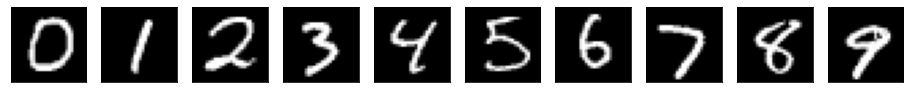

In [ ]:
show_images_by_class(mnist_testset, plt.cm.gray)

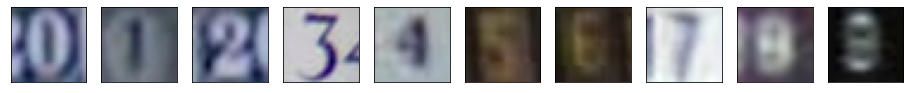

In [ ]:
show_images_by_class(svhn_testset)

## 3-1. Make CycleGAN

In [ ]:
def conv(c_in, c_out, k_size, stride=2, pad=1, bn=True, activation='lrelu'):
    layers = []
    
    # Conv.
    layers.append(nn.Conv2d(c_in, c_out, k_size, stride, pad, bias=False))
    
    # Batchnorm
    if bn:
        layers.append(nn.BatchNorm2d(c_out))
    
    # Activation
    if activation == 'lrelu':
        layers.append(nn.LeakyReLU(0.2))
    elif activation == 'relu':
        layers.append(nn.ReLU())
    elif activation == 'tanh':
        layers.append(nn.Tanh())
    elif activation == 'none':
        pass
                
    return nn.Sequential(*layers)
  
def deconv(c_in, c_out, k_size, stride=2, pad=1, bn=True, activation='lrelu'):
    layers = []
    
    # Deconv.
    layers.append(nn.ConvTranspose2d(c_in, c_out, k_size, stride, pad, bias=False))
    
    # Batchnorm
    if bn:
        layers.append(nn.BatchNorm2d(c_out))
    
    # Activation
    if activation == 'lrelu':
        layers.append(nn.LeakyReLU(0.2))
    elif activation == 'relu':
        layers.append(nn.ReLU())
    elif activation == 'tanh':
        layers.append(nn.Tanh())
    elif activation == 'none':
        pass
                
    return nn.Sequential(*layers)

In [ ]:
class Generator(nn.Module):
    def __init__(self, in_dim=1, out_dim=3):
        super(Generator, self).__init__()
        # encoding blocks
        self.conv1 = conv(in_dim, 64, 4)
        self.conv2 = conv(64, 64*2, 4)
        
        # intermediate blocks
        self.conv3 = conv(64*2, 64*2, 3, 1, 1)
        self.conv4 = conv(64*2, 64*2, 3, 1, 1)
        
        # decoding blocks
        self.deconv1 = deconv(64*2, 64, 4)
        self.deconv2 = deconv(64, out_dim, 4, bn=False, activation='tanh')
        
    def forward(self, x):
        out = self.conv1(x)      # (B, 64, 16, 16)
        out = self.conv2(out)    # (B, 128, 8, 8)
        
        out = self.conv3(out)    # (B, 128, 8, 8)
        out = self.conv4(out)    # (B, 128, 8, 8)
        
        out = self.deconv1(out)  # (B, 64, 16, 16)
        out = self.deconv2(out)  # (B, out_dim, 32, 32)
        return out


class Discriminator(nn.Module):
    def __init__(self, in_dim=1):
        super(Discriminator, self).__init__()
        self.conv1 = conv(in_dim, 64, 4, bn=False)
        self.conv2 = conv(64, 64*2, 4)
        self.conv3 = conv(64*2, 64*4, 4)
        self.fc = conv(64*4, 1, 4, 1, 0, bn=False, activation='none')
        
    def forward(self, x):
        out = self.conv1(x)    # (B, 64, 16, 16)
        out = self.conv2(out)  # (B, 128, 8, 8)
        out = self.conv3(out)  # (B, 256, 4, 4)
        out = self.fc(out).squeeze()
        out = torch.sigmoid(out)
        return out


## 3-2. Train model

In [ ]:
G_ms = Generator(in_dim=1, out_dim=3).train().cuda()
G_sm = Generator(in_dim=3, out_dim=1).train().cuda()
D_m = Discriminator(in_dim=1).train().cuda()
D_s = Discriminator(in_dim=3).train().cuda()

g_optimizer = optim.Adam(list(G_ms.parameters()) + list(G_sm.parameters()), lr=0.0002, betas=(0.5, 0.99))
d_optimizer = optim.Adam(list(D_m.parameters()) + list(D_s.parameters()), lr=0.0002, betas=(0.5, 0.99))

# Fixed된 이미지를 프린팅하는 함수
def show_images(images):
    print_list = []
    for i in range(2):
        print_list += [images[0][i], images[1][i], images[2][i]]
  
    for i in range(2):
        print_list += [images[3][i], images[4][i], images[5][i]] 
    plt.figure(figsize=(8,14)) # 세로 사이즈 40, 가로 사이즈 20*3
  
    for a in range(1, 7):
        target_img = print_list[a-1]
        if target_img.shape[0] == 3:
            target_img = target_img.transpose(1, 2, 0)
            cmap = None
        else:
            target_img = target_img.transpose(1, 2, 0).squeeze()
            cmap = plt.cm.gray
        plt.subplot(4, 3, a)
        plt.imshow(target_img, cmap)
        plt.xticks([])
        plt.yticks([])
    for a in range(7, 13):
        target_img = print_list[a-1]
        if target_img.shape[0] == 3:
            target_img = target_img.transpose(1, 2, 0)
            cmap = None
        else:
            target_img = target_img.transpose(1, 2, 0).squeeze()
            cmap = plt.cm.gray
        plt.subplot(4, 3, a)
        plt.imshow(target_img, cmap)
        plt.xticks([])
        plt.yticks([])      
    plt.show()    

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[1000/50000], d_real_loss: 0.0000, d_fake_loss: 0.0000, g_loss: 1.0476


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


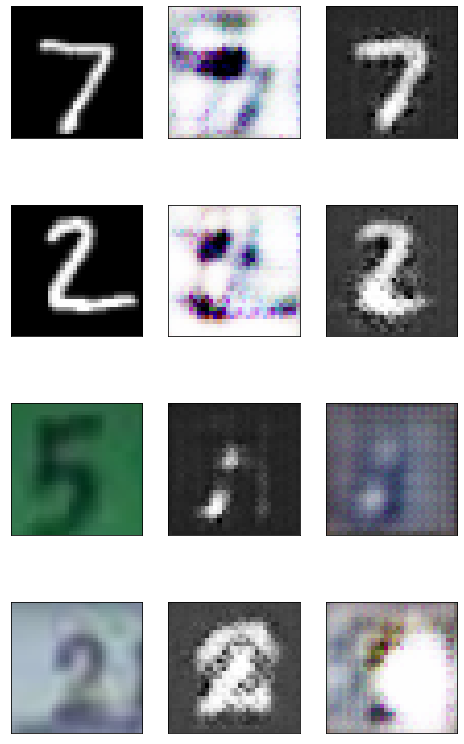

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[2000/50000], d_real_loss: 0.0003, d_fake_loss: 0.0000, g_loss: 1.0224


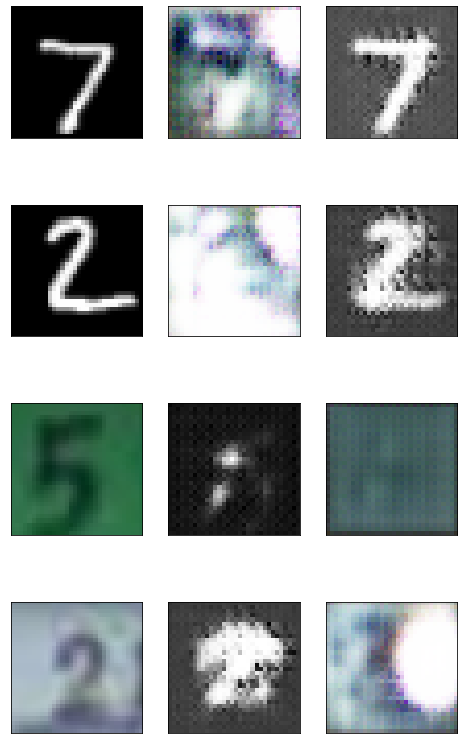

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[3000/50000], d_real_loss: 0.0000, d_fake_loss: 0.0614, g_loss: 1.0416


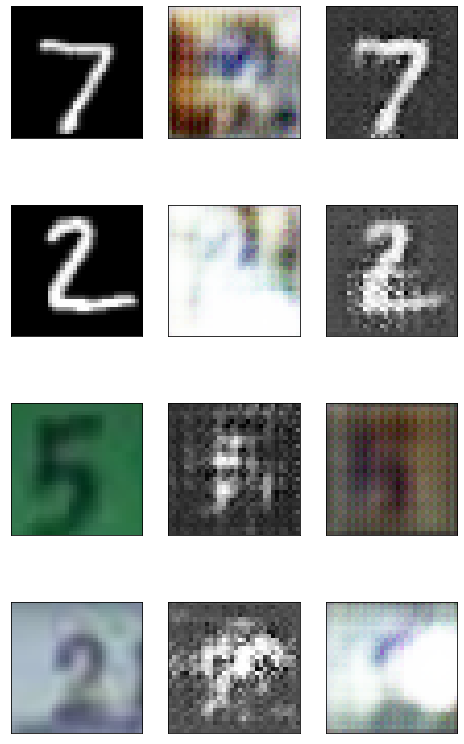

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[4000/50000], d_real_loss: 0.1075, d_fake_loss: 0.0000, g_loss: 1.0220


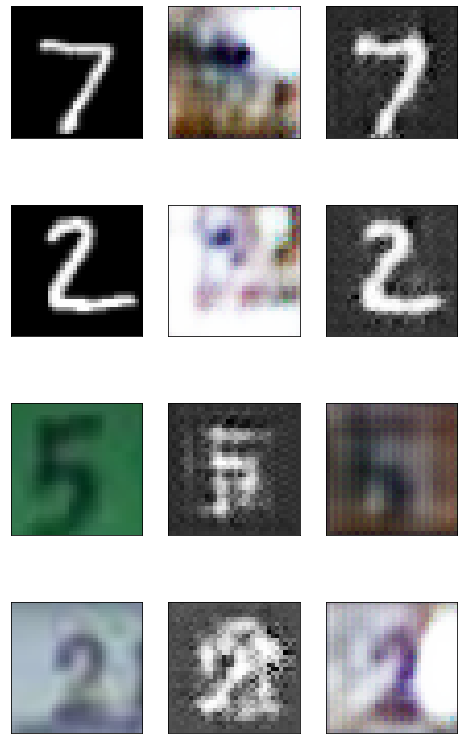

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[5000/50000], d_real_loss: 0.1990, d_fake_loss: 0.0227, g_loss: 1.0187


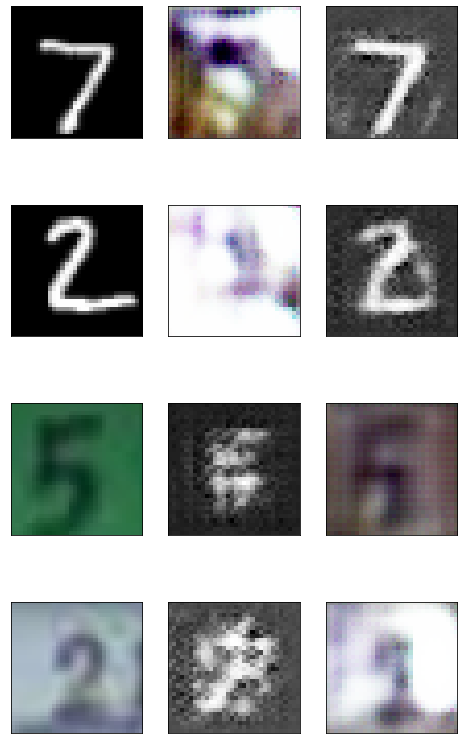

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[6000/50000], d_real_loss: 0.0014, d_fake_loss: 0.1269, g_loss: 1.0456


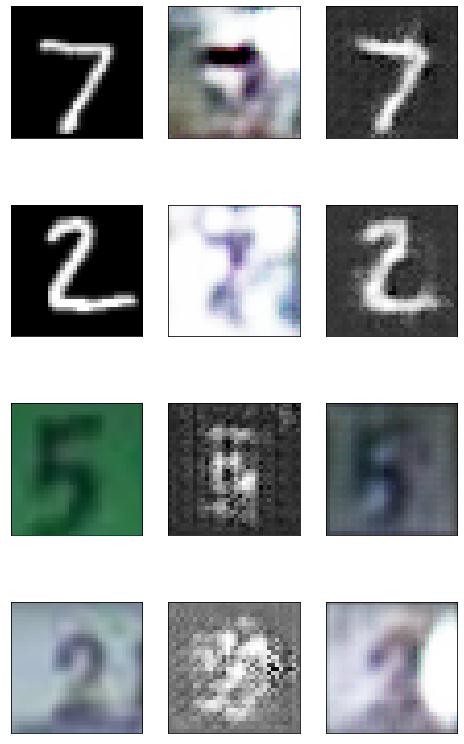

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[7000/50000], d_real_loss: 0.0004, d_fake_loss: 0.0008, g_loss: 1.0143


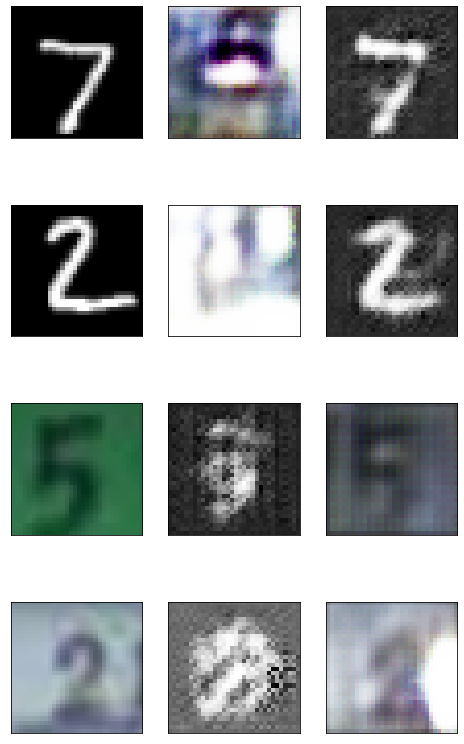

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[8000/50000], d_real_loss: 0.5673, d_fake_loss: 0.0000, g_loss: 1.0374


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


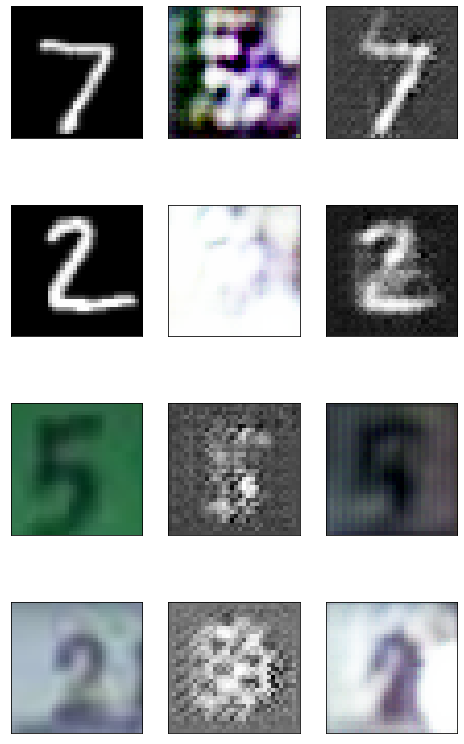

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[9000/50000], d_real_loss: 0.0001, d_fake_loss: 0.0027, g_loss: 1.0166


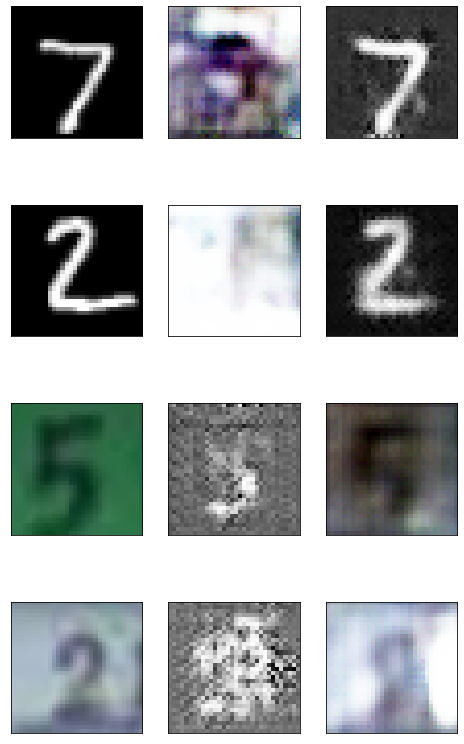

Step[10000/50000], d_real_loss: 0.0030, d_fake_loss: 0.0050, g_loss: 1.0123


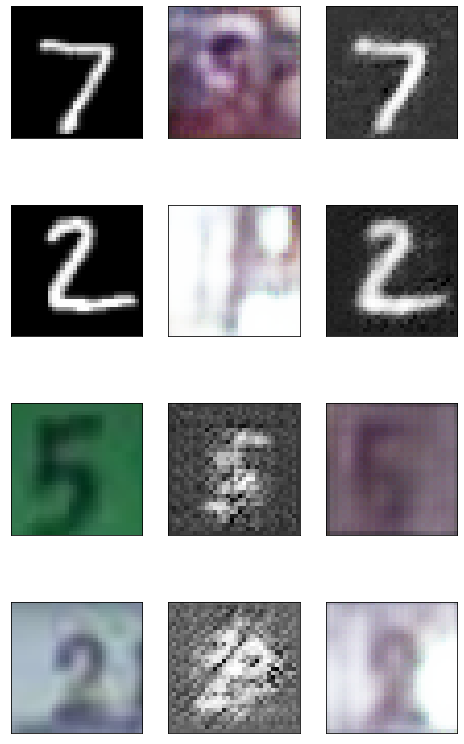

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[11000/50000], d_real_loss: 0.1597, d_fake_loss: 0.0001, g_loss: 1.0349


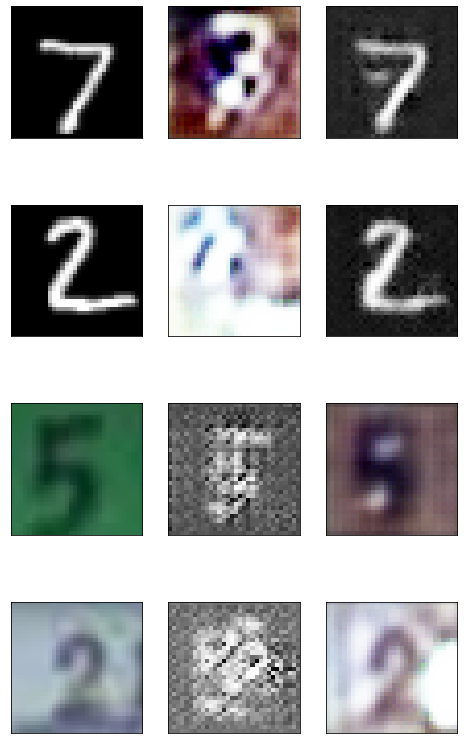

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[12000/50000], d_real_loss: 0.0007, d_fake_loss: 0.0340, g_loss: 1.0103


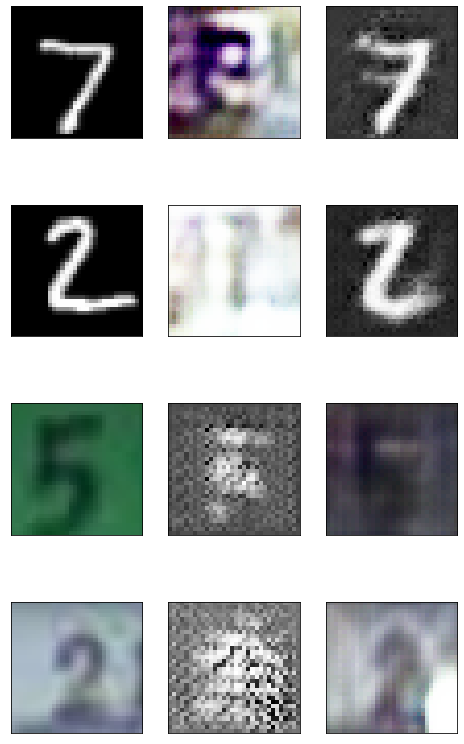

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[13000/50000], d_real_loss: 0.5586, d_fake_loss: 0.0649, g_loss: 1.0319


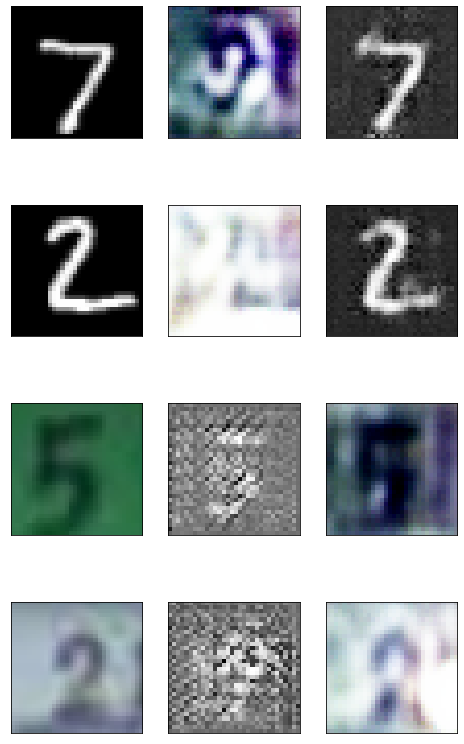

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[14000/50000], d_real_loss: 0.2952, d_fake_loss: 0.0061, g_loss: 1.0095


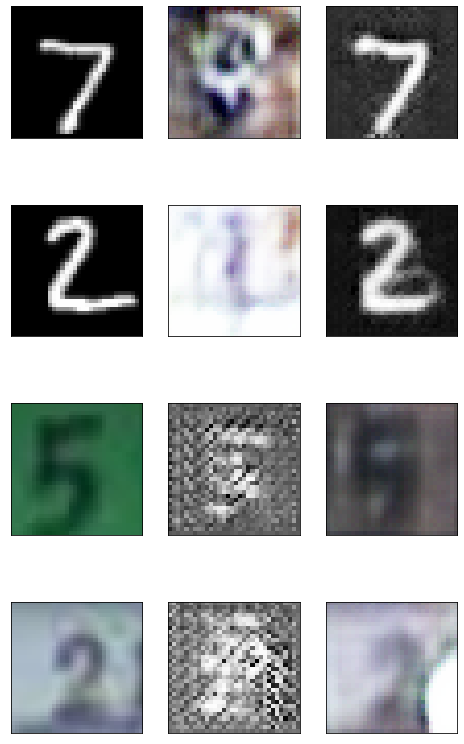

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[15000/50000], d_real_loss: 0.0000, d_fake_loss: 0.0185, g_loss: 1.0138


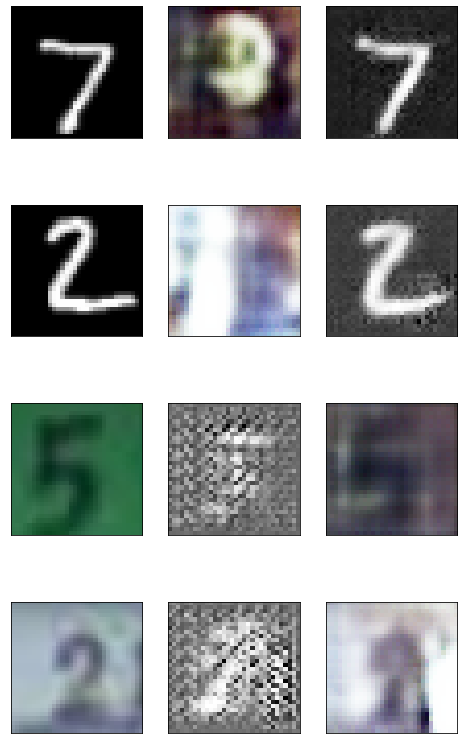

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[16000/50000], d_real_loss: 0.0994, d_fake_loss: 0.0029, g_loss: 1.0213


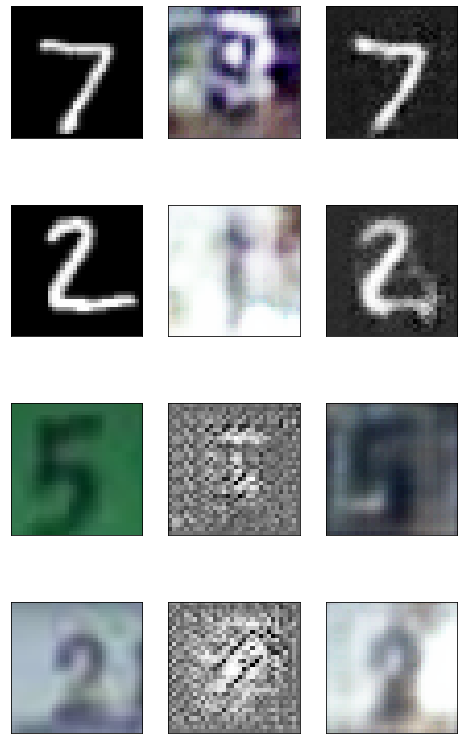

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[17000/50000], d_real_loss: 0.0001, d_fake_loss: 0.1450, g_loss: 1.0088


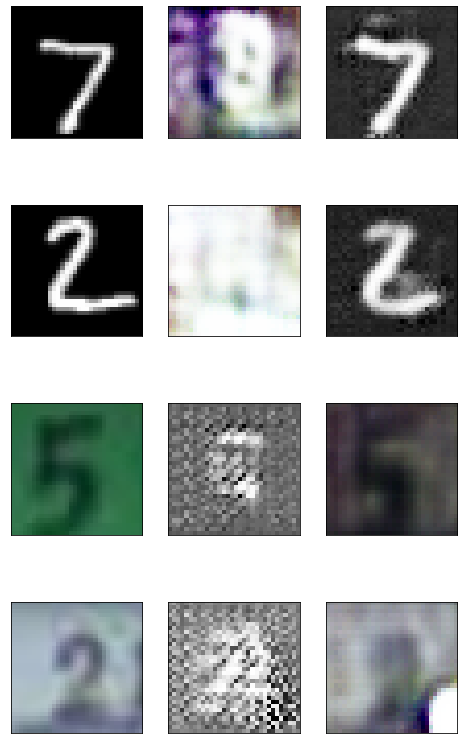

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[18000/50000], d_real_loss: 0.8391, d_fake_loss: 0.0001, g_loss: 1.0326


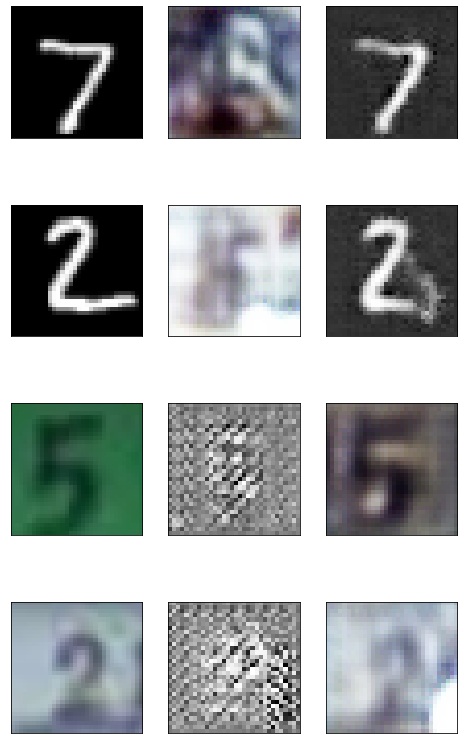

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[19000/50000], d_real_loss: 0.0159, d_fake_loss: 0.0858, g_loss: 1.0117


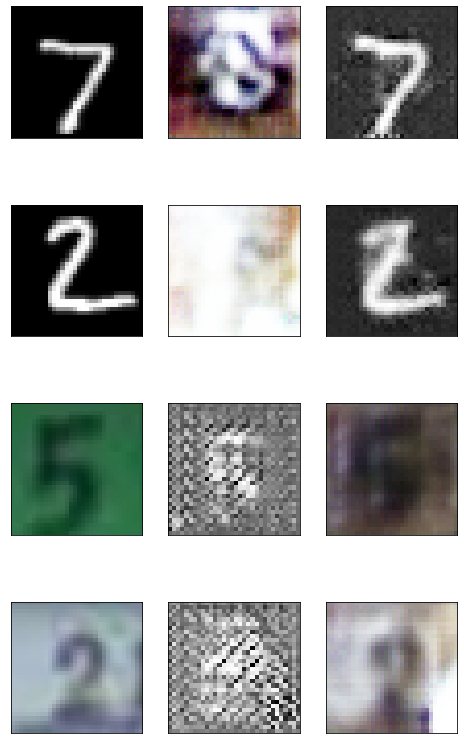

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[20000/50000], d_real_loss: 0.0000, d_fake_loss: 0.1158, g_loss: 1.0108


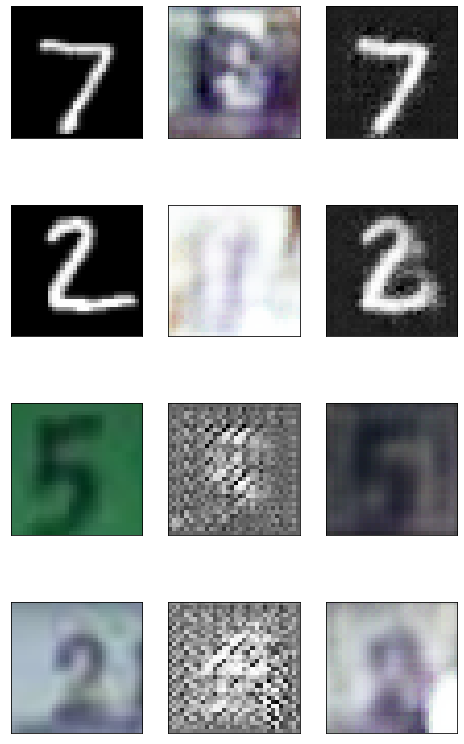

Step[21000/50000], d_real_loss: 0.1001, d_fake_loss: 0.0233, g_loss: 1.0211


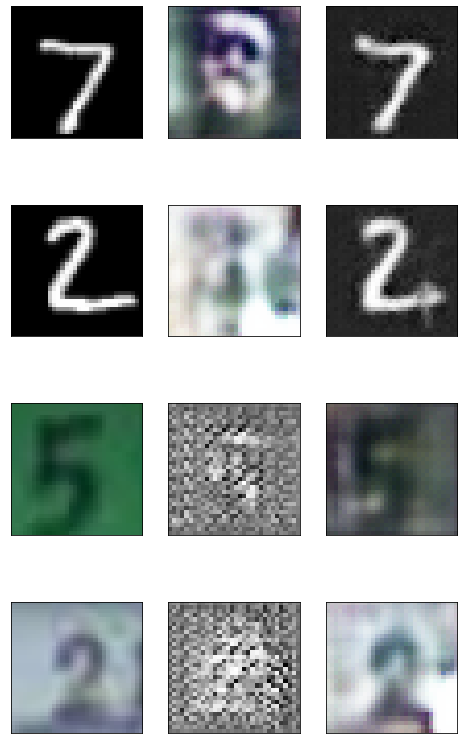

Step[22000/50000], d_real_loss: 0.0311, d_fake_loss: 0.0006, g_loss: 1.0086


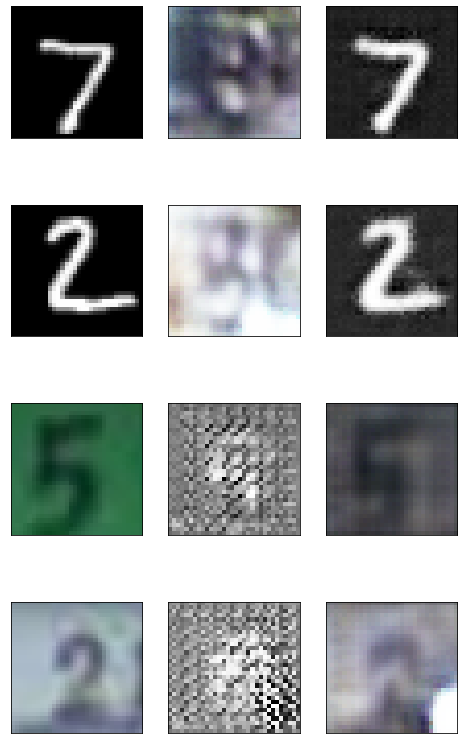

Step[23000/50000], d_real_loss: 0.0171, d_fake_loss: 0.0247, g_loss: 1.0313


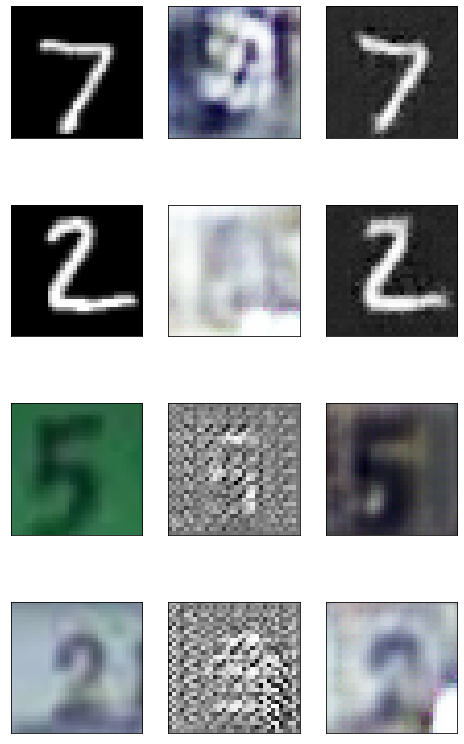

Step[24000/50000], d_real_loss: 0.0037, d_fake_loss: 0.0120, g_loss: 1.0082


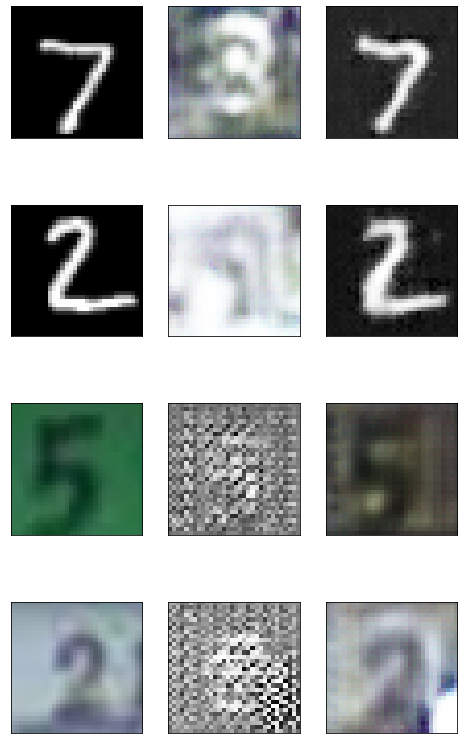

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[25000/50000], d_real_loss: 0.0128, d_fake_loss: 0.0020, g_loss: 1.0115


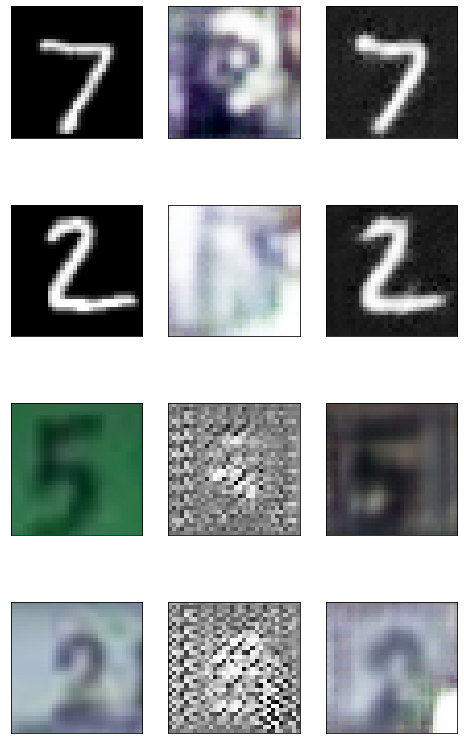

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[26000/50000], d_real_loss: 0.0089, d_fake_loss: 0.0006, g_loss: 1.0153


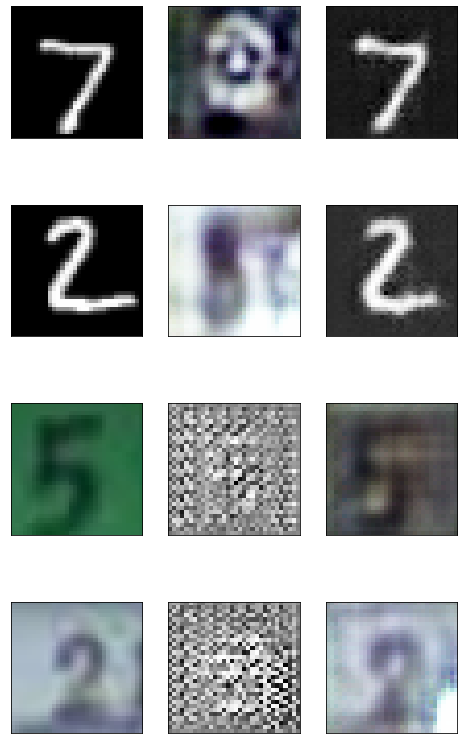

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[27000/50000], d_real_loss: 0.0001, d_fake_loss: 0.1209, g_loss: 1.0117


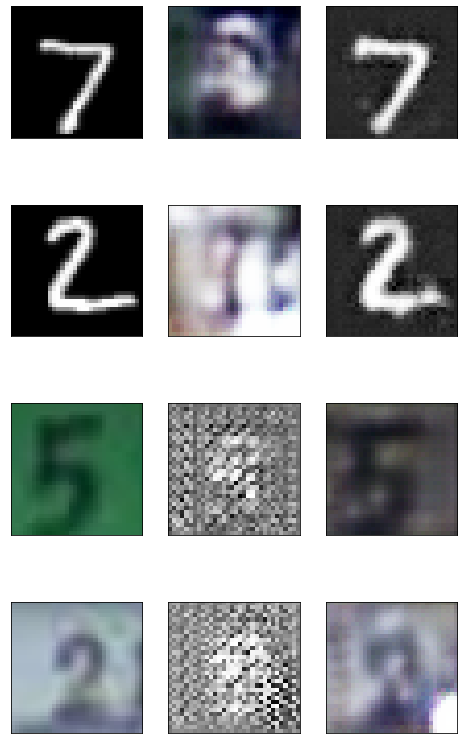

Step[28000/50000], d_real_loss: 0.3019, d_fake_loss: 0.0000, g_loss: 1.0267


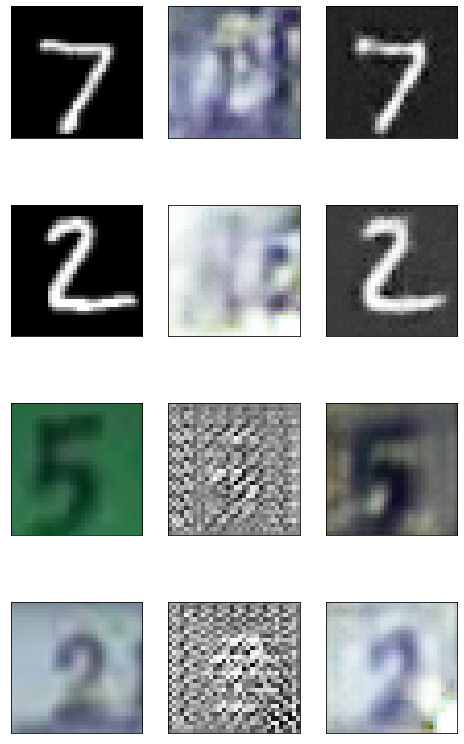

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[29000/50000], d_real_loss: 0.0079, d_fake_loss: 0.0129, g_loss: 1.0072


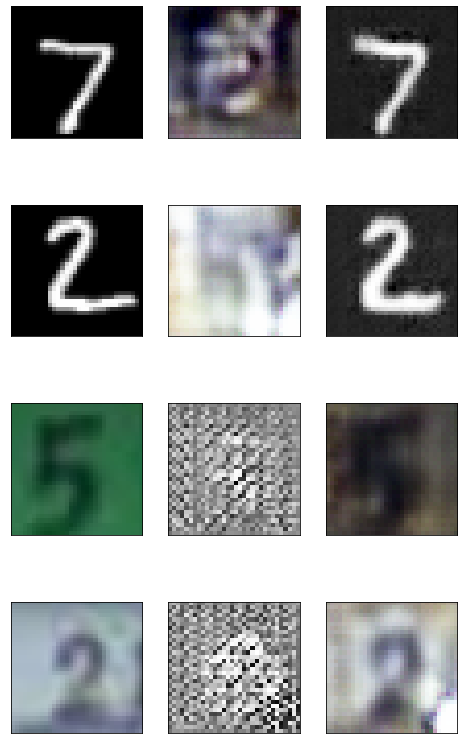

Step[30000/50000], d_real_loss: 0.0000, d_fake_loss: 0.0038, g_loss: 1.0245


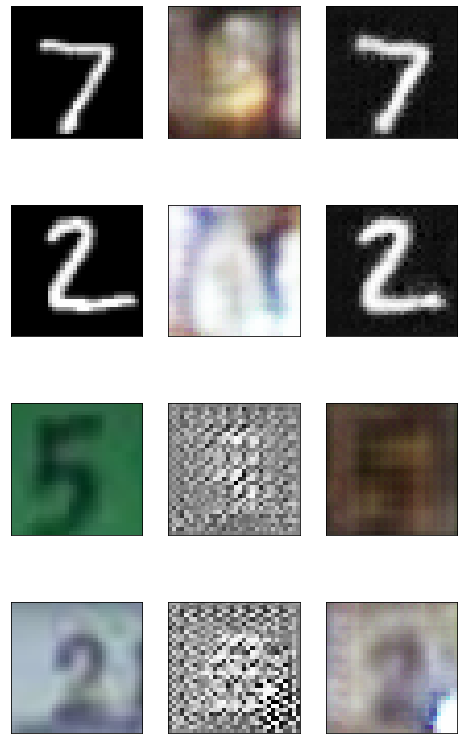

Step[31000/50000], d_real_loss: 0.0035, d_fake_loss: 0.0000, g_loss: 1.0135


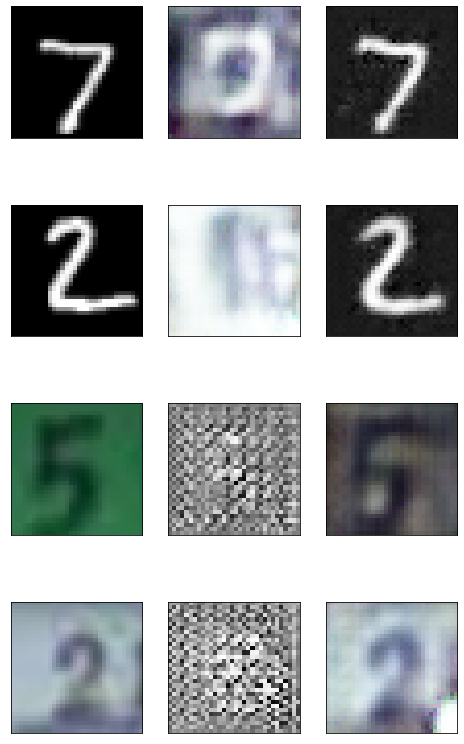

Step[32000/50000], d_real_loss: 0.0023, d_fake_loss: 0.0024, g_loss: 1.0058


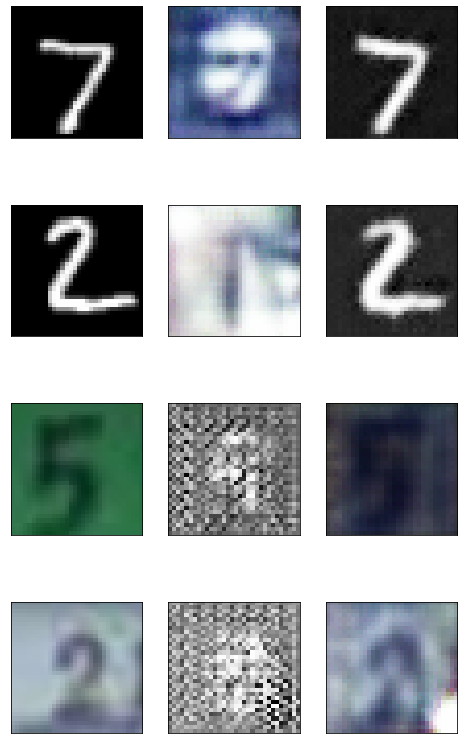

Step[33000/50000], d_real_loss: 0.1193, d_fake_loss: 0.0000, g_loss: 1.0267


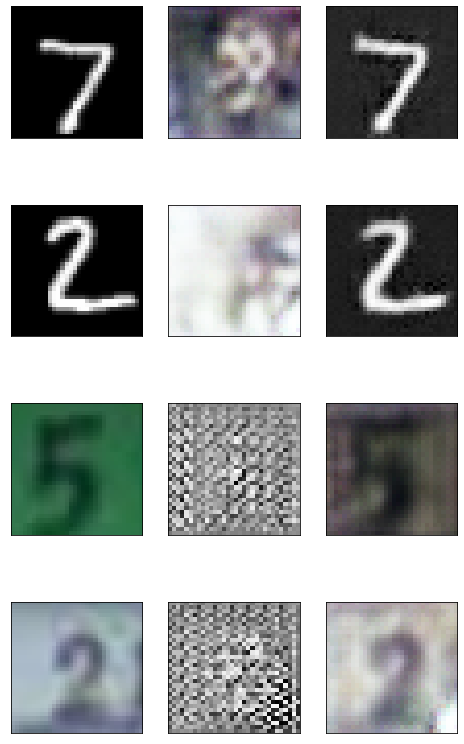

Step[34000/50000], d_real_loss: 0.2207, d_fake_loss: 0.0029, g_loss: 1.0056


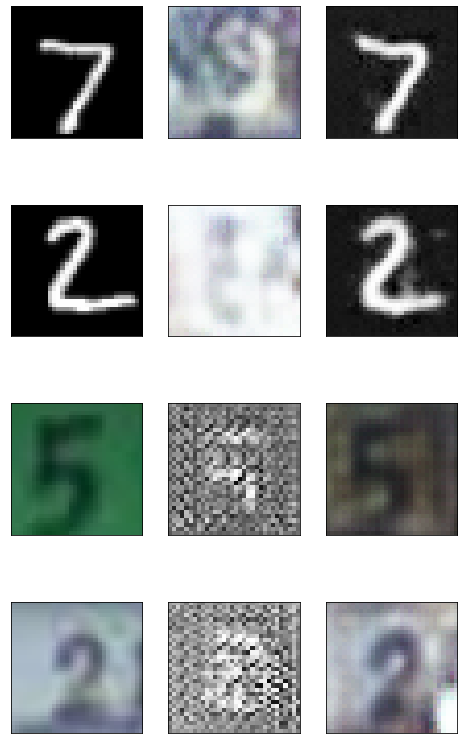

Step[35000/50000], d_real_loss: 0.0000, d_fake_loss: 0.0001, g_loss: 1.0131


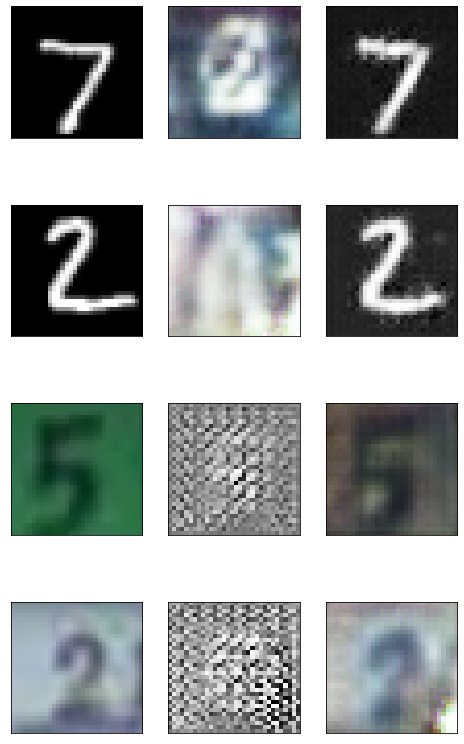

Step[36000/50000], d_real_loss: 0.0392, d_fake_loss: 0.0001, g_loss: 1.0111


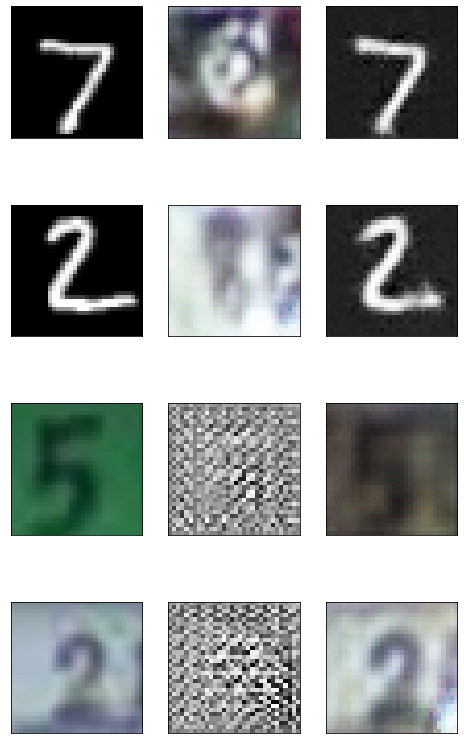

Step[37000/50000], d_real_loss: 0.1610, d_fake_loss: 0.1411, g_loss: 1.0054


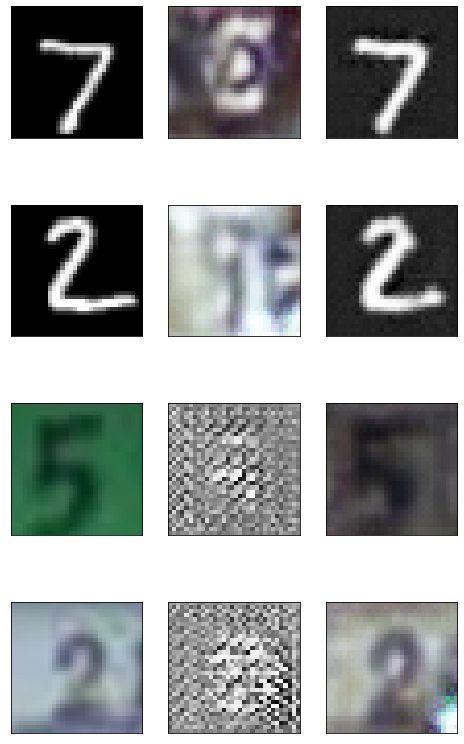

Step[38000/50000], d_real_loss: 0.7851, d_fake_loss: 0.0001, g_loss: 1.0177


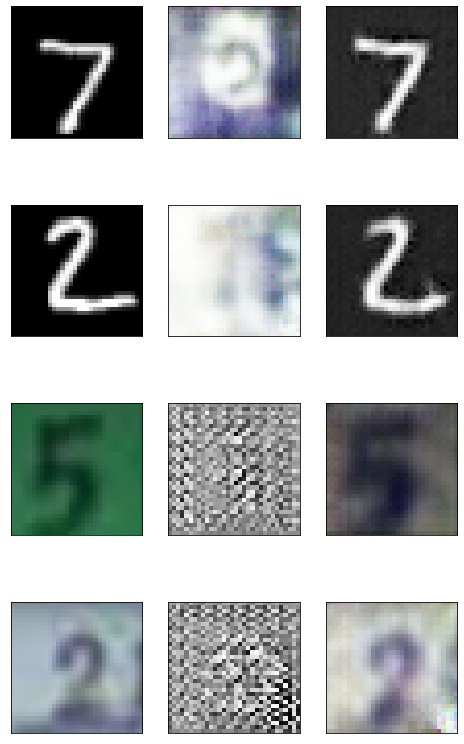

Step[39000/50000], d_real_loss: 0.0050, d_fake_loss: 0.0006, g_loss: 1.0043


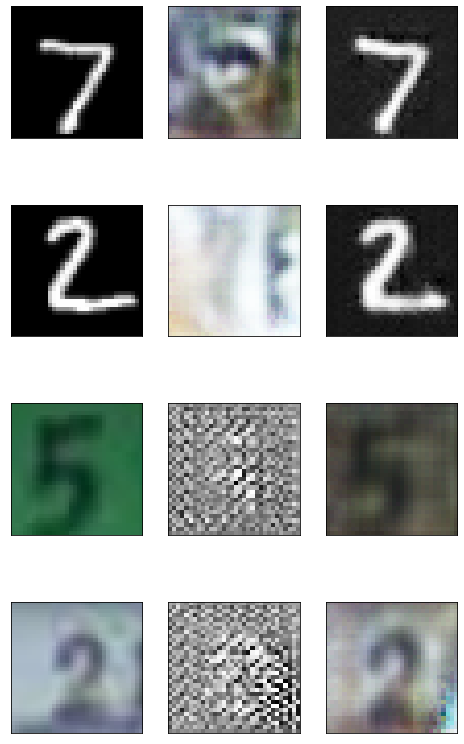

Step[40000/50000], d_real_loss: 0.0000, d_fake_loss: 0.0507, g_loss: 1.0174


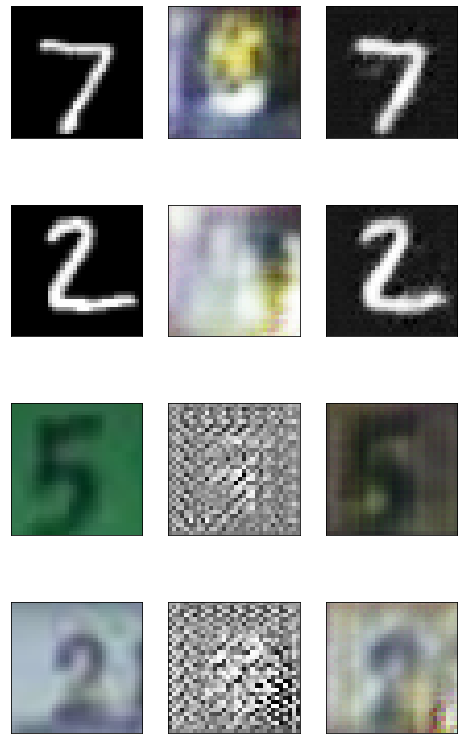

Step[41000/50000], d_real_loss: 0.0002, d_fake_loss: 0.0001, g_loss: 1.0079


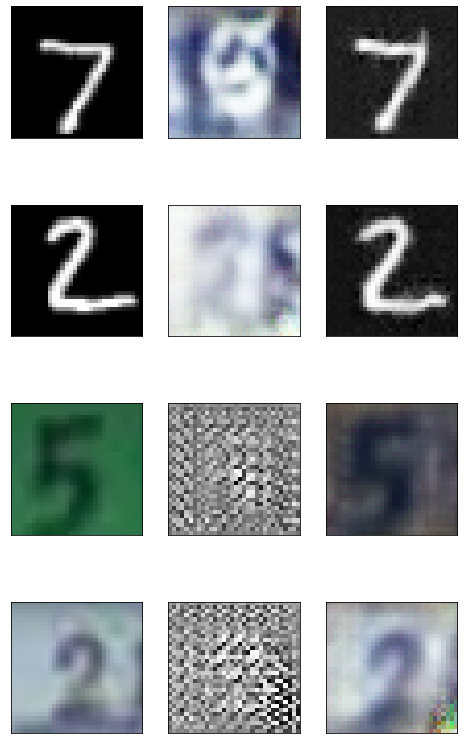

Step[42000/50000], d_real_loss: 0.1646, d_fake_loss: 0.0204, g_loss: 1.0061


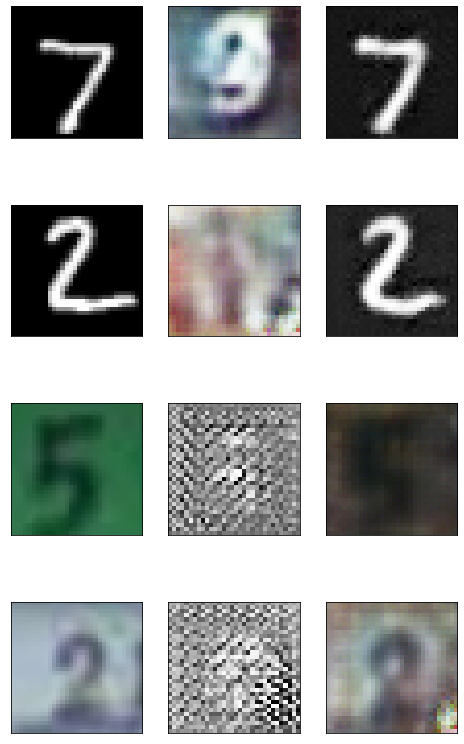

Step[43000/50000], d_real_loss: 0.2220, d_fake_loss: 0.0013, g_loss: 1.0216


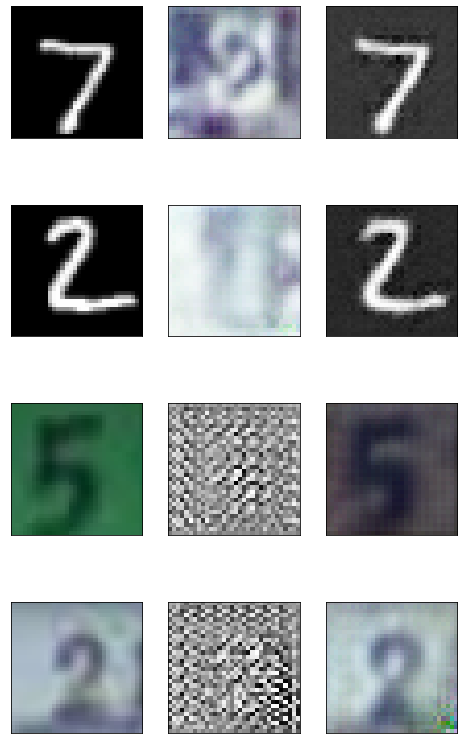

Step[44000/50000], d_real_loss: 0.0172, d_fake_loss: 0.3432, g_loss: 1.0042


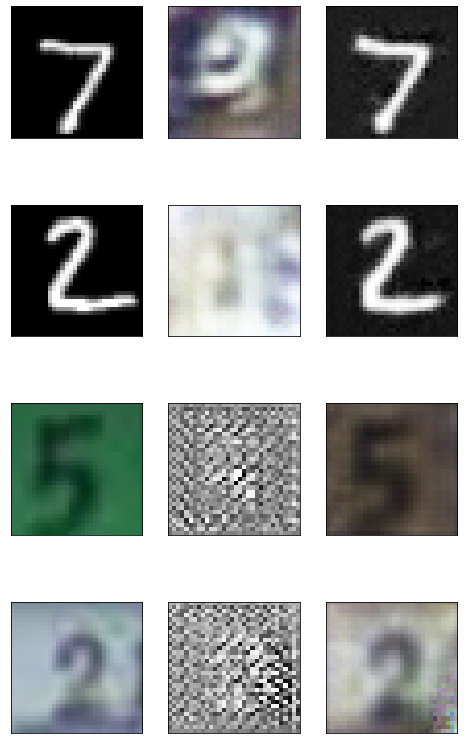

Step[45000/50000], d_real_loss: 0.0000, d_fake_loss: 0.0034, g_loss: 1.0138


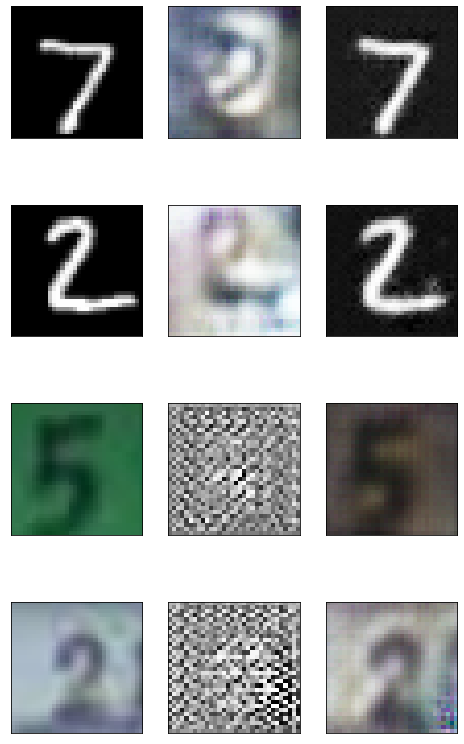

Step[46000/50000], d_real_loss: 0.0000, d_fake_loss: 0.0002, g_loss: 1.0072


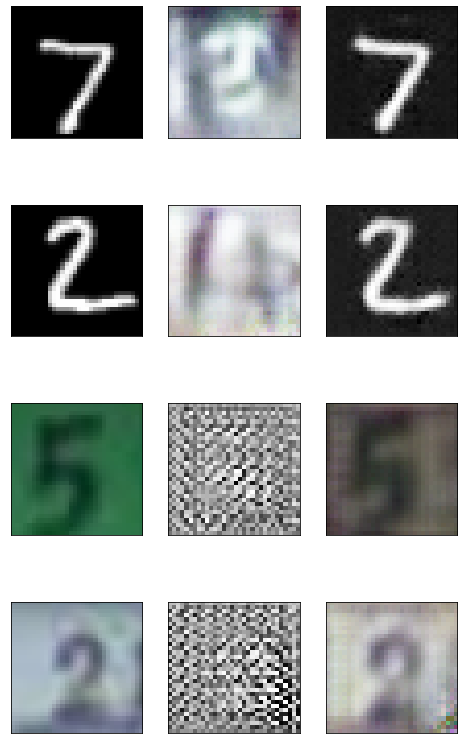

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step[47000/50000], d_real_loss: 0.2009, d_fake_loss: 0.0048, g_loss: 1.0052


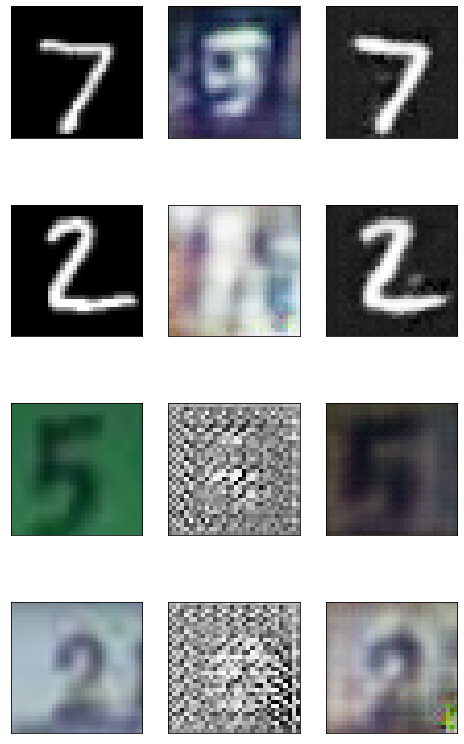

Step[48000/50000], d_real_loss: 0.0216, d_fake_loss: 0.0000, g_loss: 1.0152


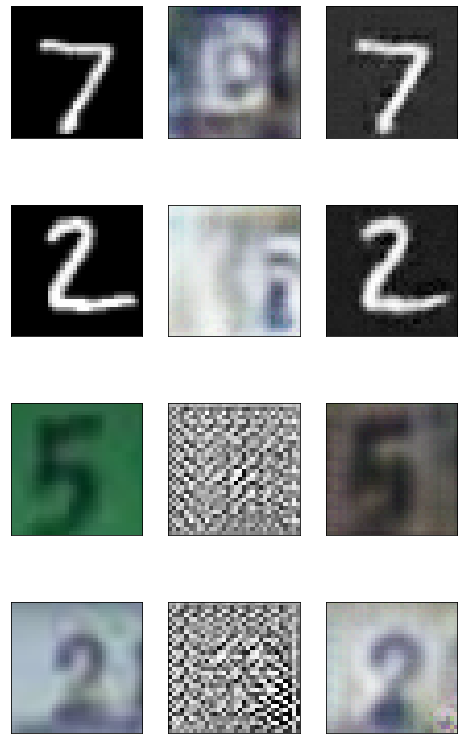

Step[49000/50000], d_real_loss: 0.0769, d_fake_loss: 0.1192, g_loss: 1.0036


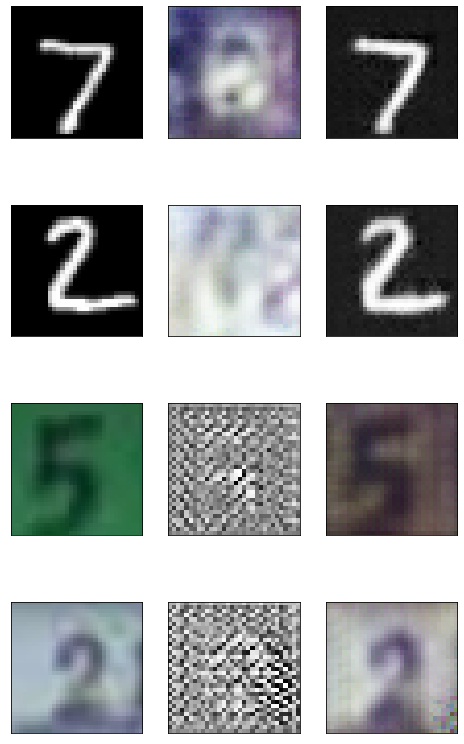

Step[50000/50000], d_real_loss: 0.0109, d_fake_loss: 0.0078, g_loss: 1.0056


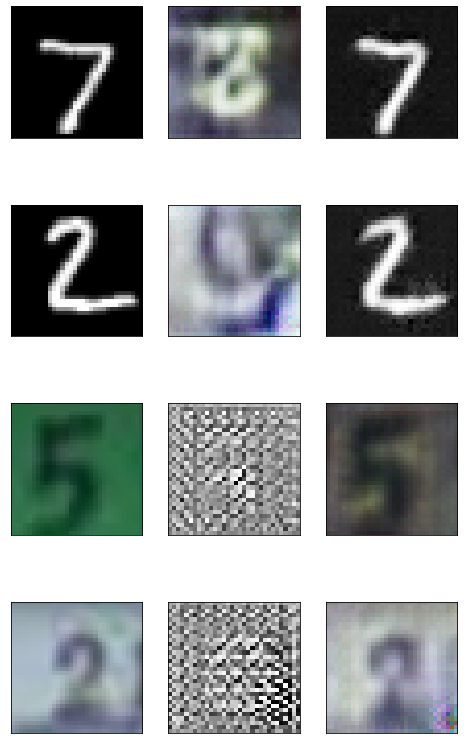

In [ ]:
# d_loss_real: Real images들을 1로 분류하기 위한 loss
# d_loss_fake: Fake images들을 0로 분류하기 위한 loss
# g_loss: D를 속이는 Fake images들을 만들기 위한 loss (D에서 1로 분류함) + 다시 돌아 갔을 때 reconstruction을 위한 cycle loss
iters = 50000

mnist_iter = iter(mnist_testloader)
svhn_iter = iter(svhn_testloader)

fixed_mnist = next(mnist_iter)[0][:2].cuda()
fixed_svhn = next(svhn_iter)[0][:2].cuda()

for i in range(iters):
    try:
        mnist, m_labels = next(mnist_iter) 
        svhn, s_labels = next(svhn_iter)
    except:
        mnist_iter = iter(mnist_testloader)
        svhn_iter = iter(svhn_testloader)
        mnist, m_labels = next(mnist_iter) 
        svhn, s_labels = next(svhn_iter)
    
    # To GPU
    mnist = mnist.cuda()
    m_labels = m_labels.cuda()
    svhn = svhn.cuda()
    s_labels = s_labels.cuda()
    
    #============= Train the discriminator =============#

    # Real images를 통해 D를 트레이닝 합니다.
    out = D_m(mnist)
    d_loss_mnist = torch.mean((out-1)**2)

    out = D_s(svhn)
    d_loss_svhn = torch.mean((out-1)**2)

    d_real_loss = d_loss_mnist + d_loss_svhn
  
    d_optimizer.zero_grad()
    d_real_loss.backward()
    d_optimizer.step()

    # Fake images = generated images를 통해 D를 트레이닝 합니다.
    fake_svhn = G_ms(mnist)
    out = D_s(fake_svhn)
    d_loss_mnist = torch.mean(out**2)

    fake_mnist = G_sm(svhn)
    out = D_m(fake_mnist)
    d_loss_svhn = torch.mean(out**2)

    d_fake_loss = d_loss_mnist + d_loss_svhn
  
    d_optimizer.zero_grad()
    d_fake_loss.backward()
    d_optimizer.step()

    #=============== Train the generator ===============#

    # mnist-svhn-mnist cycle loss를 발생 시킵니다.
    fake_svhn = G_ms(mnist)
    out = D_s(fake_svhn)
    recon_mnist = G_sm(fake_svhn)
  
    g_loss = torch.mean((out-1)**2) # Discriminator를 속이도록 gradient 정보가 흐를 수 있습니다. 
    g_loss += torch.mean((mnist - recon_mnist)**2) # MNIST를 다시 만들어 내야 합니다
  
    g_optimizer.zero_grad()
    g_loss.backward()
    g_optimizer.step()

    # svhn-mnist-svhn loss를 발생 시킵니다.
    fake_mnist = G_sm(svhn)
    out = D_m(fake_mnist)
    recon_svhn = G_ms(fake_mnist)

    g_loss = torch.mean((out-1)**2) # Discriminator를 속이도록 gradient 정보가 흐를 수 있습니다.
    g_loss += torch.mean((svhn - recon_svhn)**2) # SVHN를 다시 만들어 내야 합니다

    g_optimizer.zero_grad()
    g_loss.backward()
    g_optimizer.step()

    # print the log info
    if (i+1) % 1000 == 0:    
        # fixed image 로 이미지 생성
        mnist_to_svhn = G_ms(fixed_mnist)
        mnist_recon = G_sm(mnist_to_svhn) 

        svhn_to_mnist = G_sm(fixed_svhn)
        svhn_recon = G_ms(svhn_to_mnist)

        print('======================================================================================================')
        print('Step[%d/%d], d_real_loss: %.4f, d_fake_loss: %.4f, g_loss: %.4f' 
                  %(i+1, iters, d_real_loss.item(), d_fake_loss.item(), g_loss.item()))
        print('======================================================================================================')
        show_images([fixed_mnist.detach().cpu().numpy(), mnist_to_svhn.detach().cpu().numpy(), mnist_recon.detach().cpu().numpy()
                        ,fixed_svhn.detach().cpu().numpy(), svhn_to_mnist.detach().cpu().numpy(), svhn_recon.detach().cpu().numpy()])